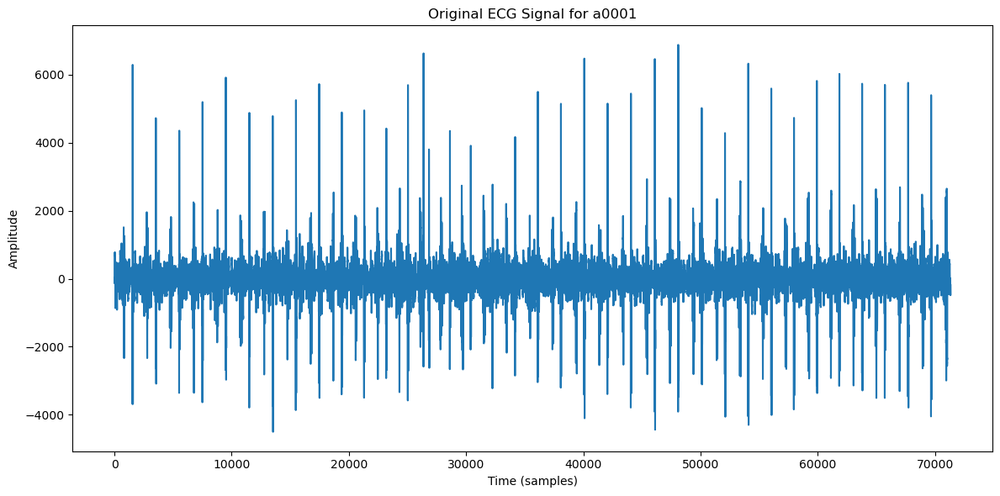

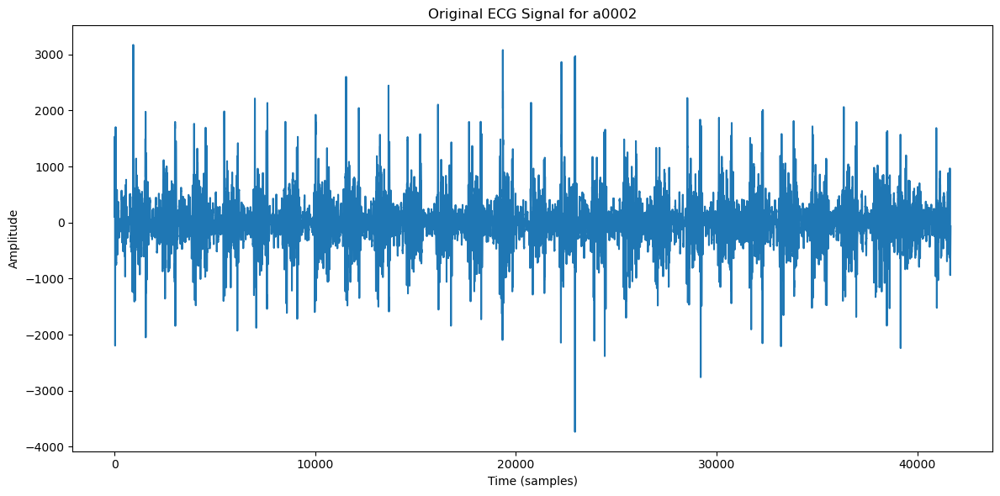

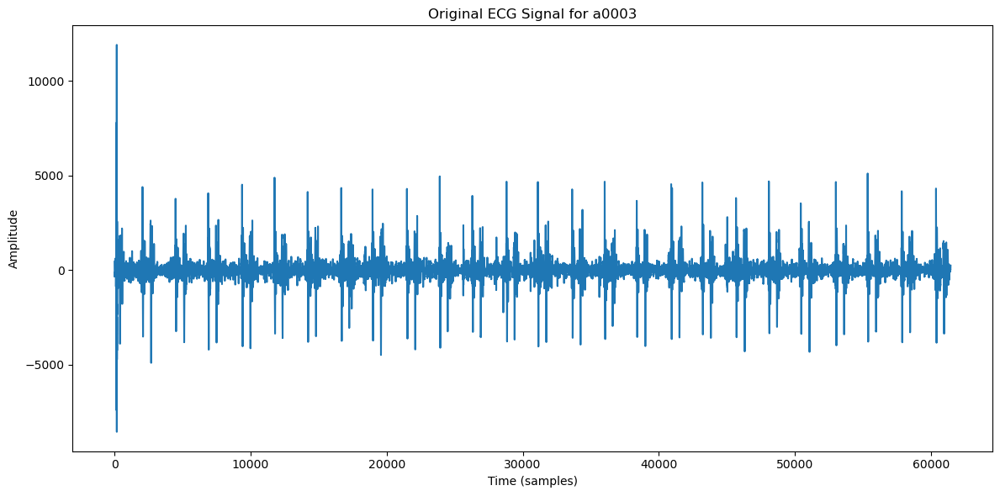

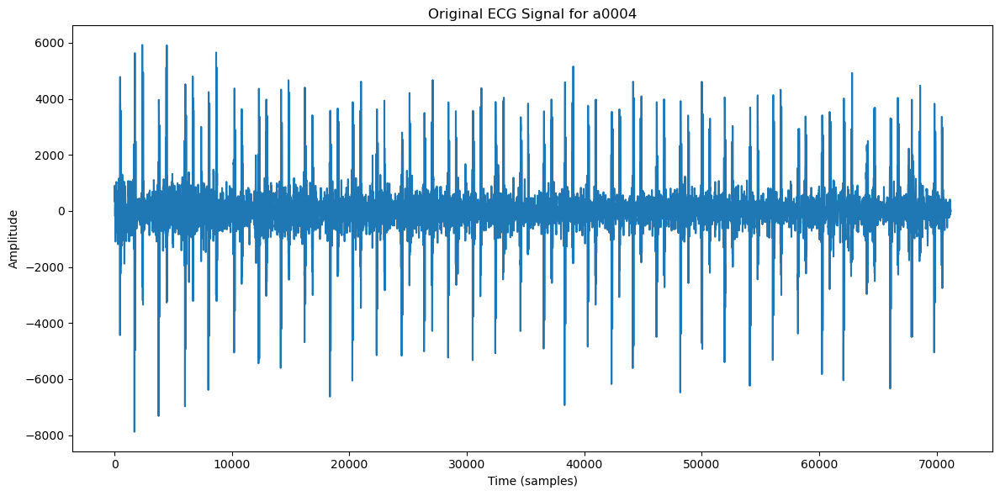

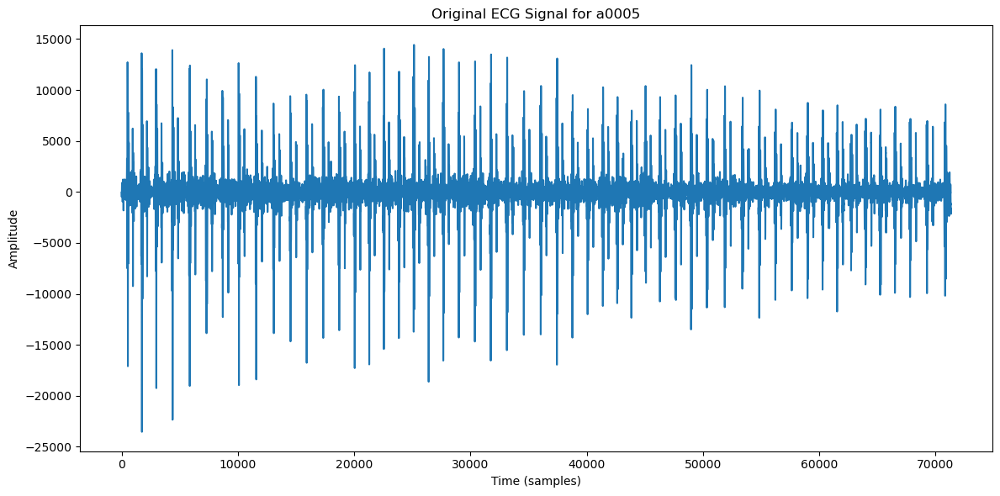

...

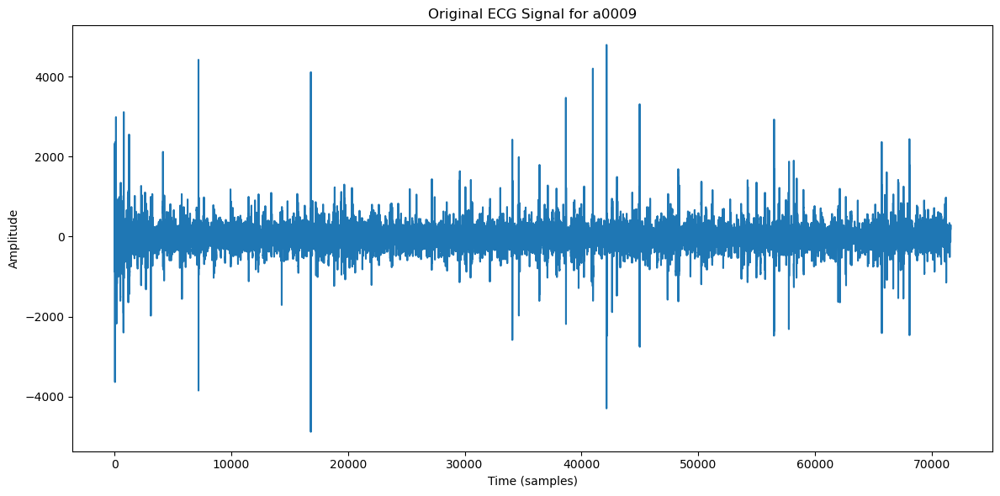

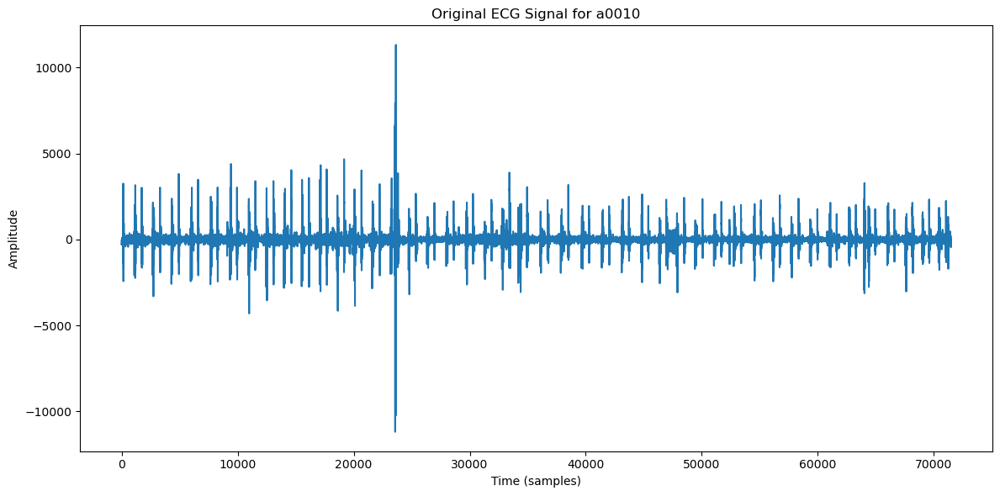

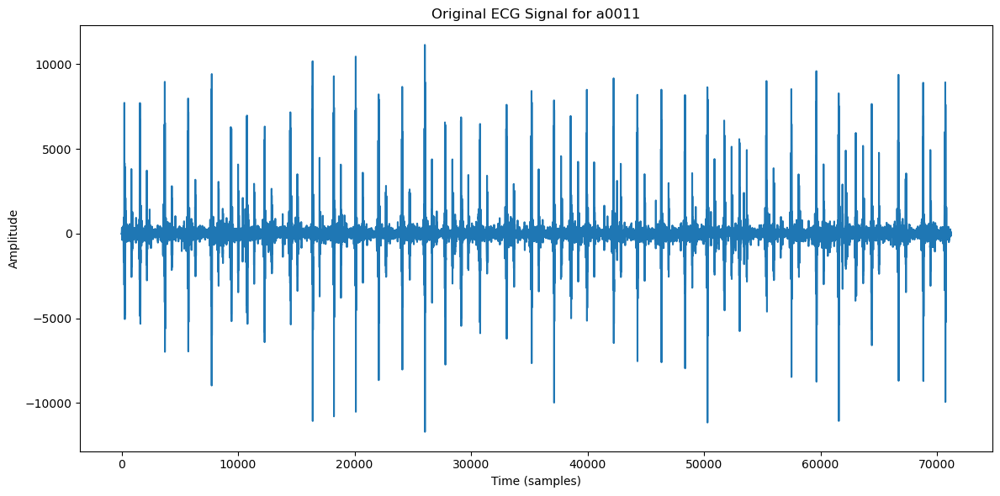

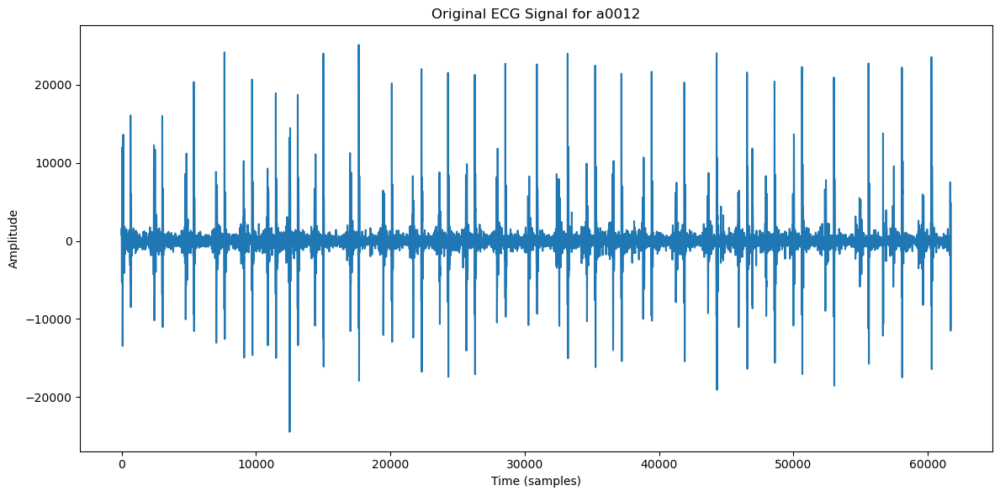

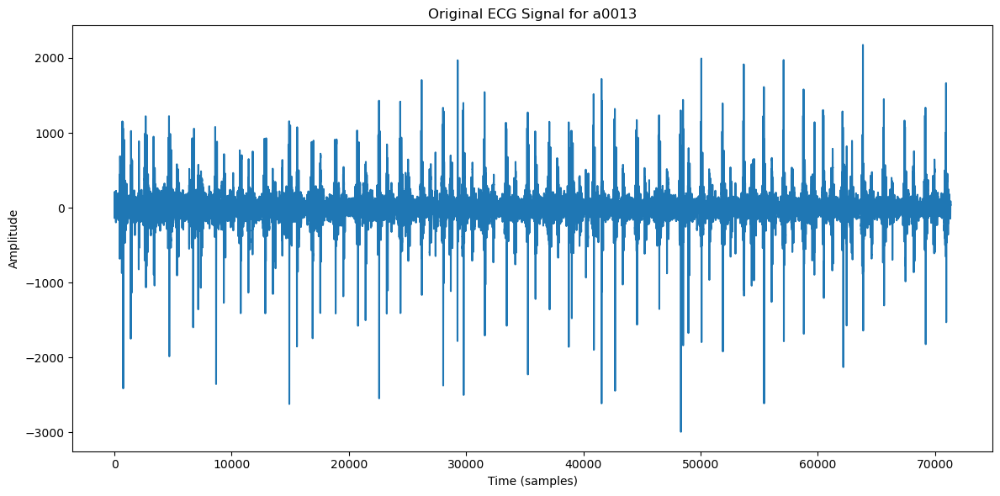

KeyboardInterrupt: 

In [3]:
import wfdb
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np

folder_path = "./bsp_dataset/Training-a"

samples = [f for f in os.listdir(folder_path) if f.endswith('.dat')]

def wavelet_denoising(signal, wavelet='db6', level=None):
    coeffs = pywt.wavedec(signal, wavelet, mode='per', level=level)
    
    # Estimate noise level using the median absolute deviation of the detail coefficients
    sigma = np.median(np.abs(coeffs[-1])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(len(signal)))
    
    # Apply soft thresholding
    denoised_coeffs = [pywt.threshold(c, threshold, mode='soft') for c in coeffs]
    
    return pywt.waverec(denoised_coeffs, wavelet, mode='per')

def plot_ecg_signal(record_name, folder_path):
    record = wfdb.rdrecord(os.path.join(folder_path, record_name))
    
    denoised_ecg = record.p_signal[:, 0]  # Assuming the first channel is ECG
    
    # Apply wavelet denoising
    denoised_ecg = wavelet_denoising(ecg_signal)
    
    # Ensure the lengths match by truncating the longer array if needed
    min_len = min(len(ecg_signal), len(denoised_ecg))
    ecg_signal = ecg_signal[:min_len]
    denoised_ecg = denoised_ecg[:min_len]
    
    plt.figure(figsize=(12, 6))
    
    # Plot original ECG signal
    
    plt.plot(ecg_signal)
    plt.title(f'Original ECG Signal for {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Amplitude')
    
    # Plot denoised ECG signal
   
    
    plt.tight_layout()
    plt.show()

for sample in samples:
    record_name = sample.replace('.dat', '')
    plot_ecg_signal(record_name, folder_path)


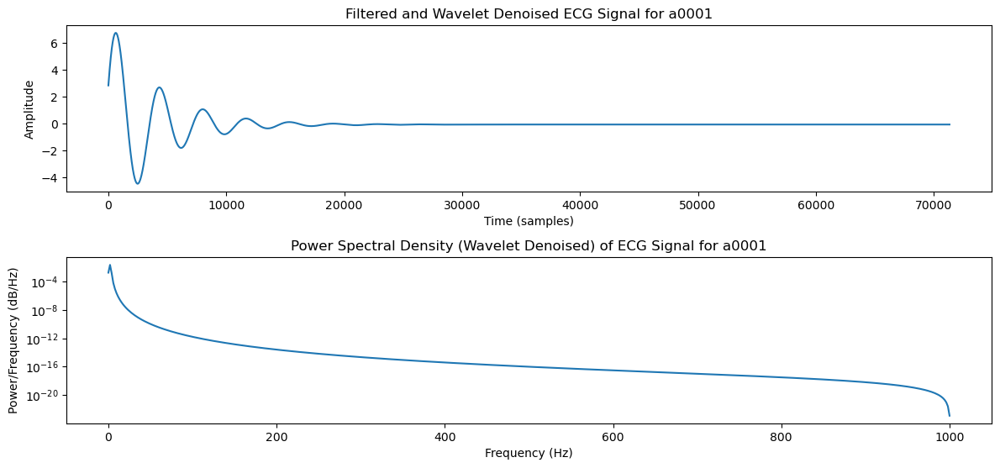

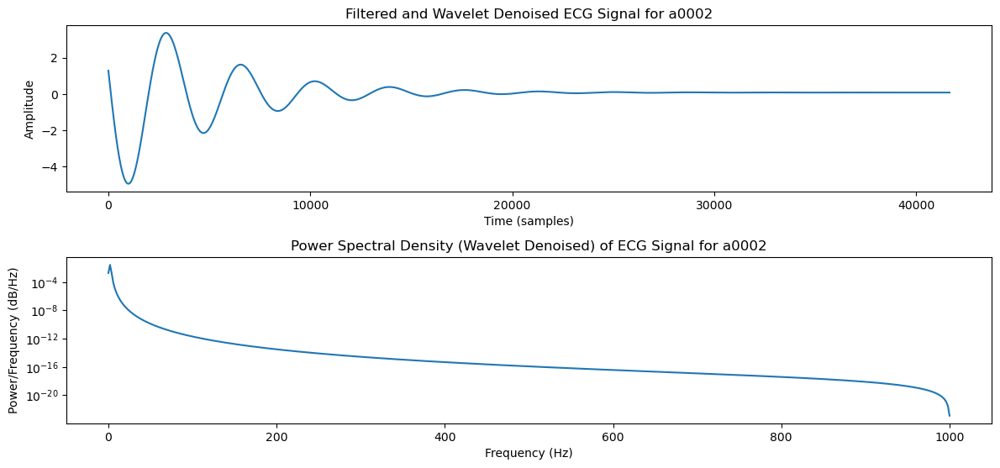

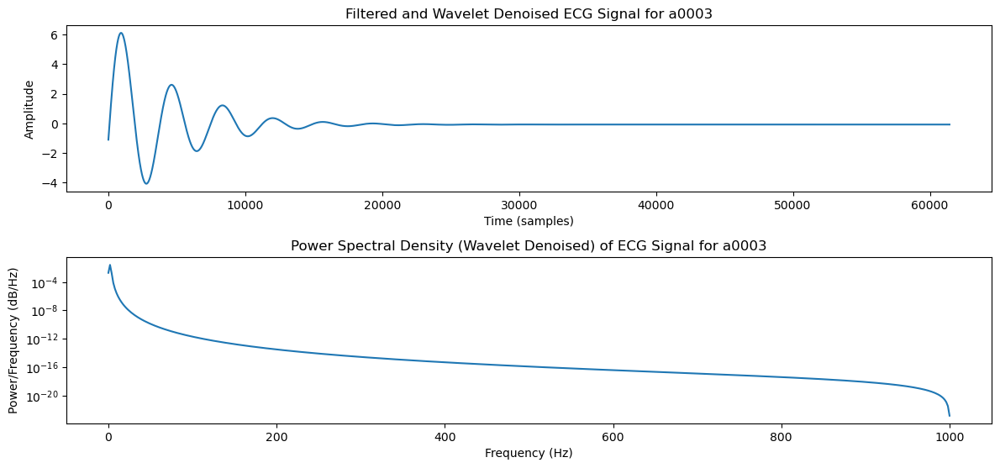

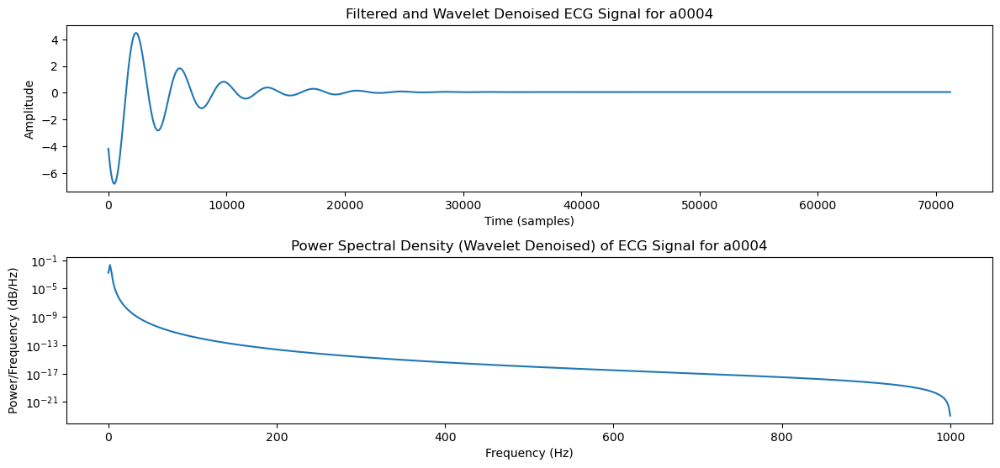

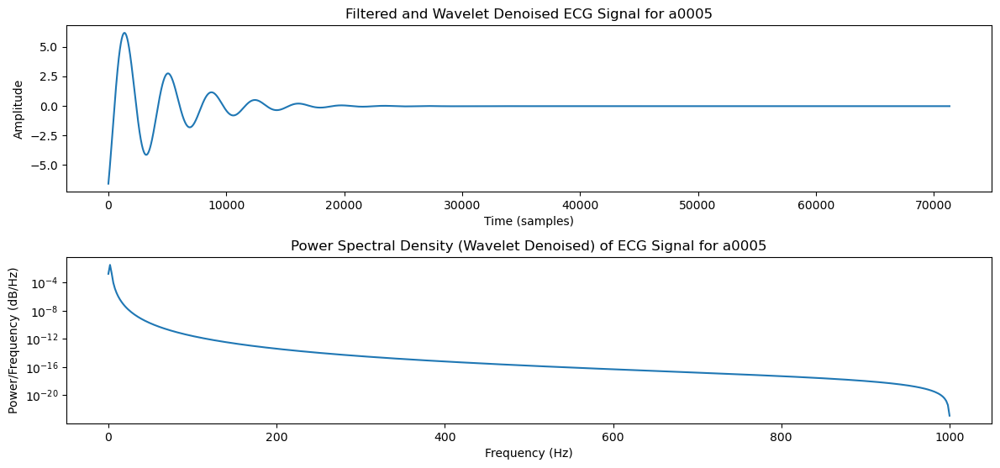

...

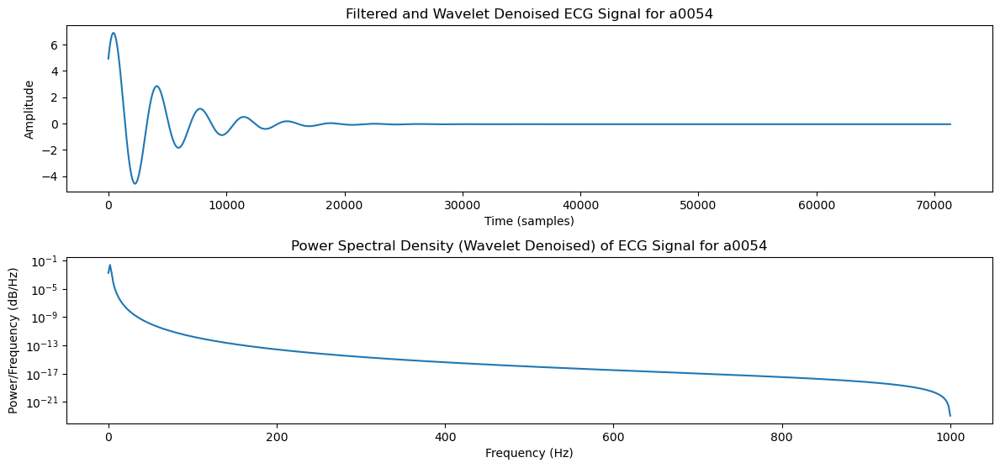

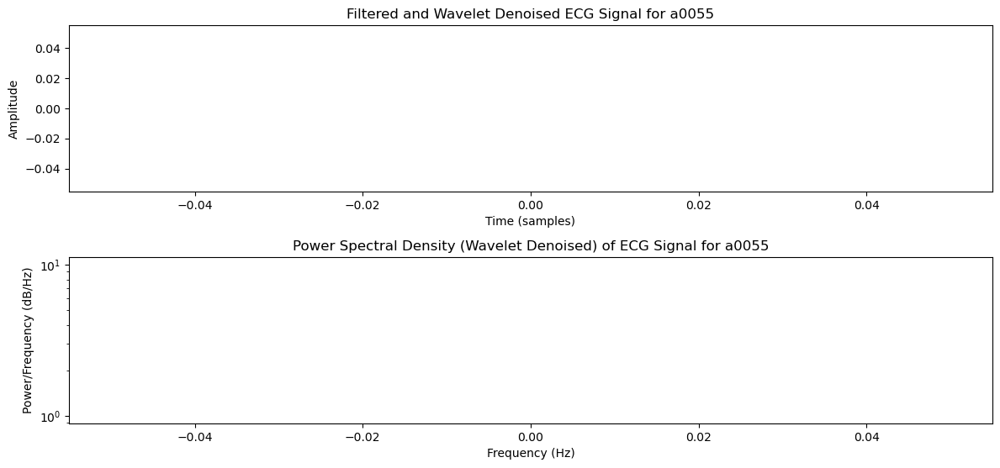

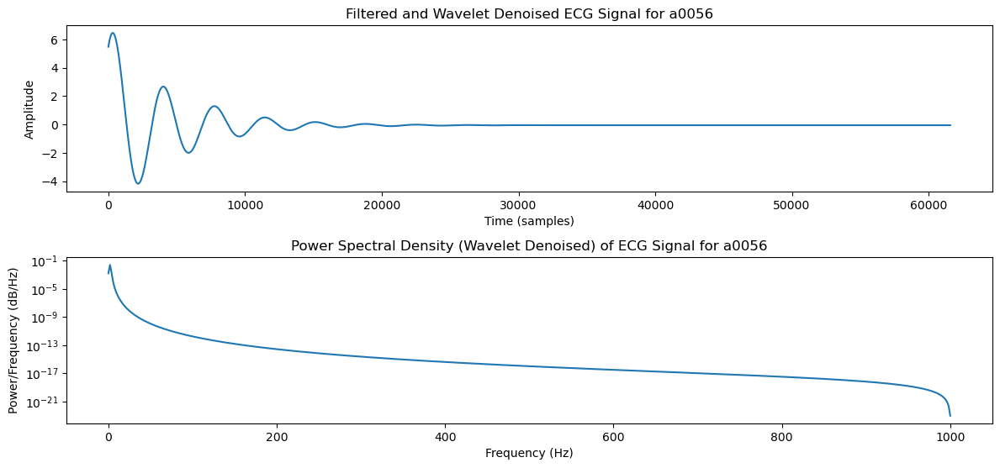

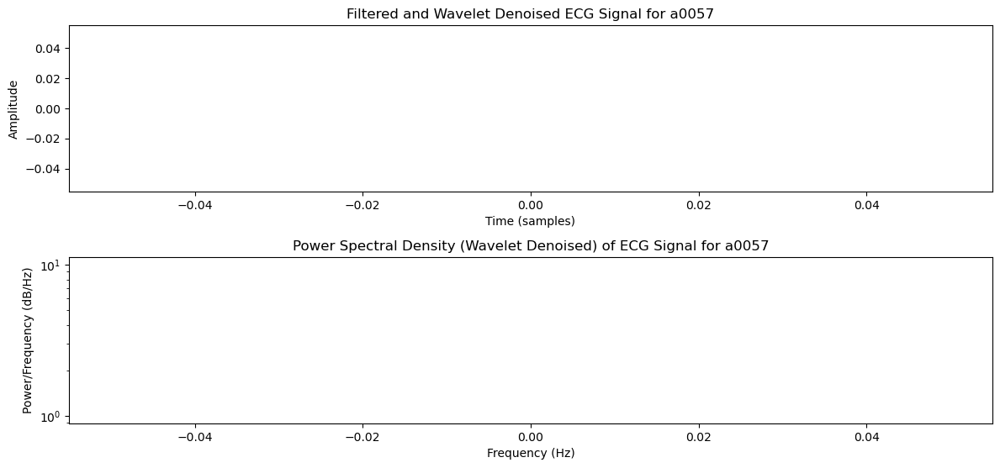

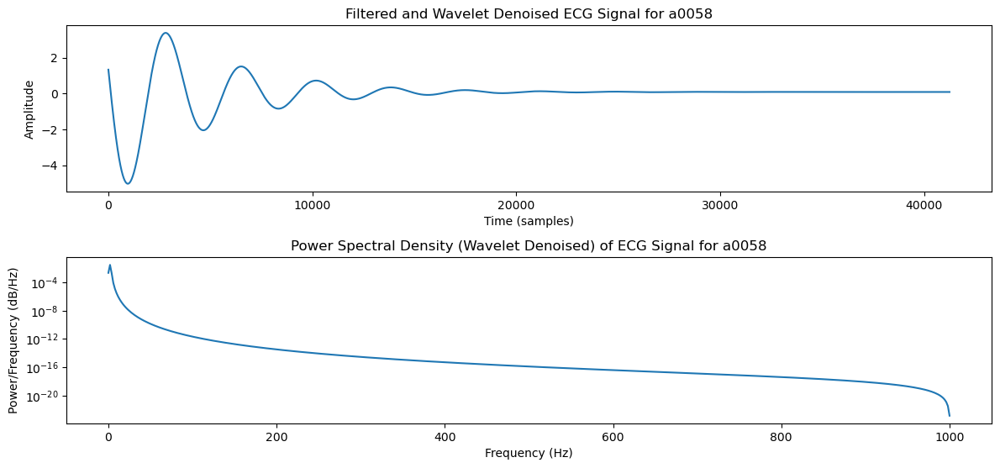

KeyboardInterrupt: 

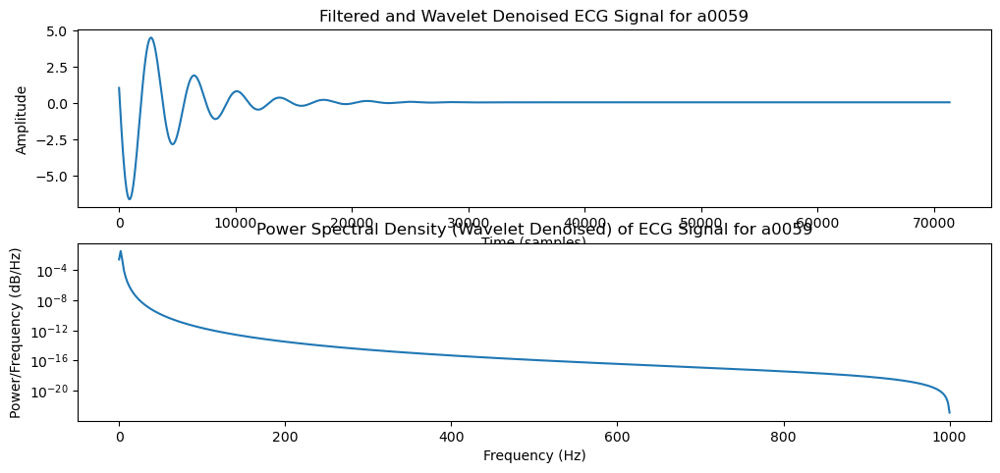

In [5]:
import os
import wfdb
import matplotlib.pyplot as plt
import numpy as np
import pywt
from scipy.signal import butter, filtfilt, welch

folder_path = "./bsp_dataset/Training-a"

samples = [f for f in os.listdir(folder_path) if f.endswith('.dat')]

# Bandpass filter design (0.5 to 40 Hz for ECG)
def bandpass_filter(signal, lowcut=0.5, highcut=40.0, fs=500, order=4):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, signal)

# Denoising function
def wavelet_denoising(signal, wavelet='db6', level=None):
    coeffs = pywt.wavedec(signal, wavelet, mode='per', level=level)
    sigma = np.median(np.abs(coeffs[-1])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(len(signal)))
    denoised_coeffs = [pywt.threshold(c, threshold, mode='soft') for c in coeffs]
    return pywt.waverec(denoised_coeffs, wavelet, mode='per')

# PSD calculation using Welch’s method
def compute_psd(signal, fs=500):
    f, Pxx = welch(signal, fs, nperseg=1024)
    return f, Pxx

# Plotting ECG signal and PSD
def plot_ecg_signal(record_name, folder_path):
    # Load the ECG record
    record = wfdb.rdrecord(os.path.join(folder_path, record_name))
    ecg_signal = record.p_signal[:, 0]  # Assuming first channel is ECG
    fs = record.fs  # Sampling frequency
    
    # Step 1: Bandpass filter
    filtered_ecg = bandpass_filter(ecg_signal, fs=fs)
    
    # Step 2: Apply wavelet denoising
    denoised_ecg = wavelet_denoising(filtered_ecg)
    
    # Step 3: Normalize the denoised signal
    normalized_ecg = (denoised_ecg - np.mean(denoised_ecg)) / np.std(denoised_ecg)
    
    # Step 4: Compute PSD from the wavelet denoised signal
    f, Pxx = compute_psd(normalized_ecg, fs)
    
    # Plotting the filtered and denoised ECG signal along with its PSD
    plt.figure(figsize=(12, 8))
    
    # Plot the filtered and denoised ECG signal
    plt.subplot(3, 1, 1)
    plt.plot(normalized_ecg)
    plt.title(f'Filtered and Wavelet Denoised ECG Signal for {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Amplitude')
    
    # Plot the PSD of the wavelet denoised ECG signal
    plt.subplot(3, 1, 2)
    plt.semilogy(f, Pxx)
    plt.title(f'Power Spectral Density (Wavelet Denoised) of ECG Signal for {record_name}')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power/Frequency (dB/Hz)')
    
    plt.tight_layout()
    plt.show()

# Process all ECG samples
for sample in samples:
    record_name = sample.replace('.dat', '')
    plot_ecg_signal(record_name, folder_path)


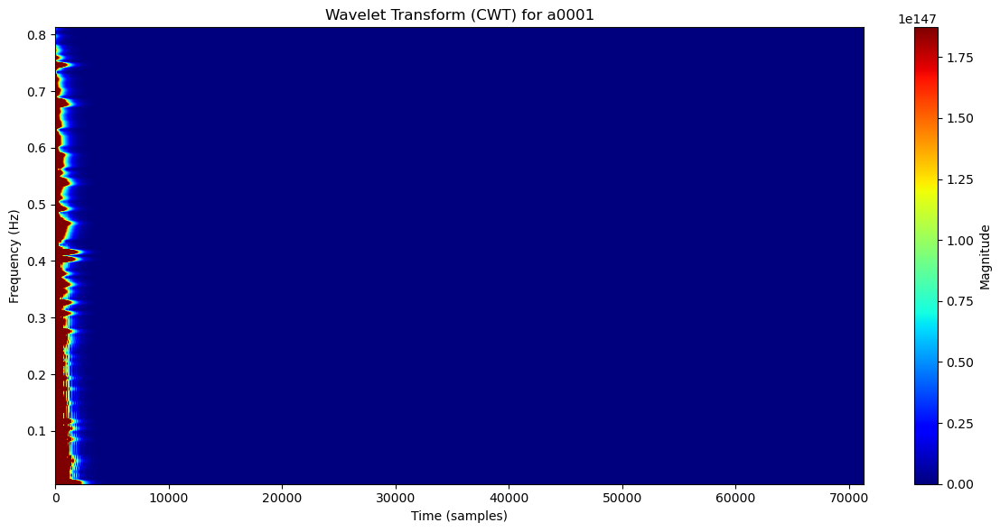

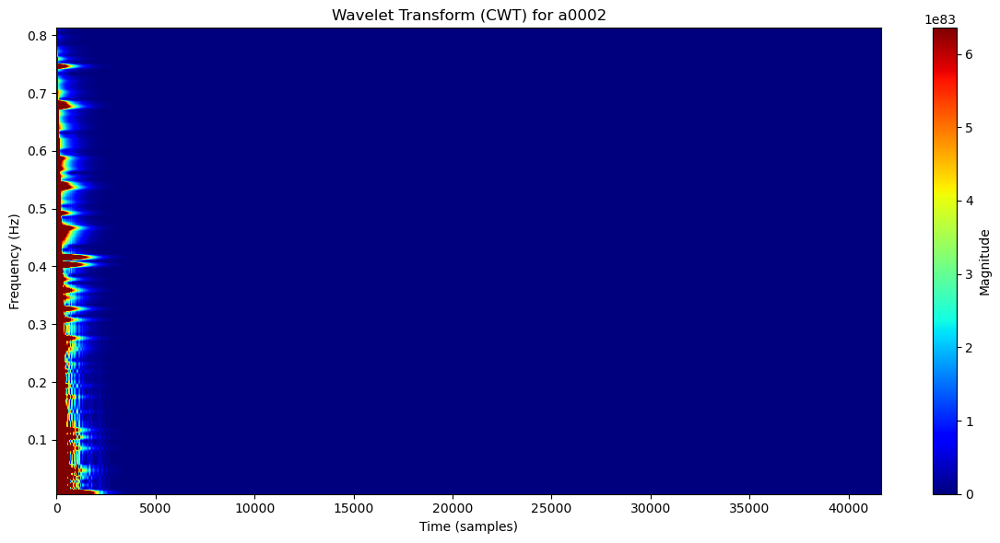

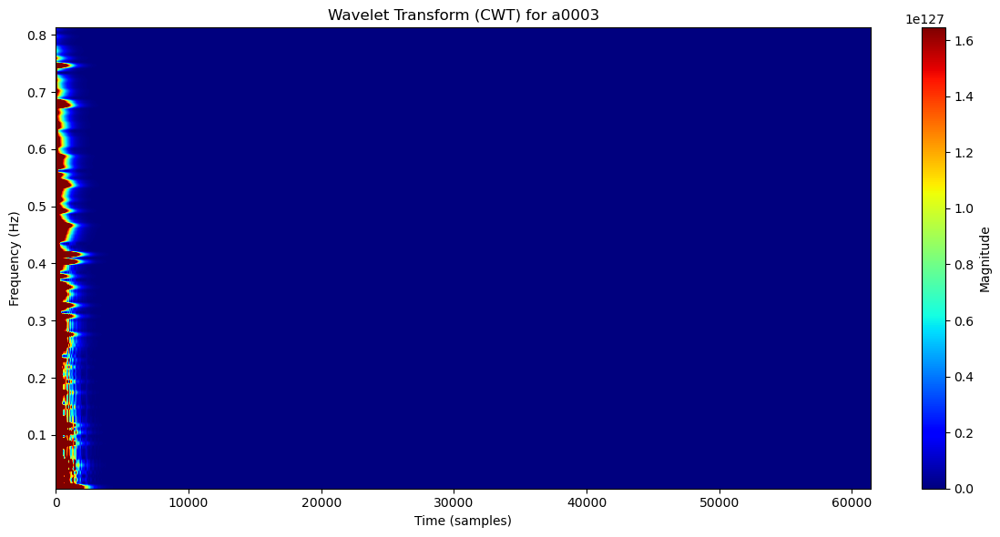

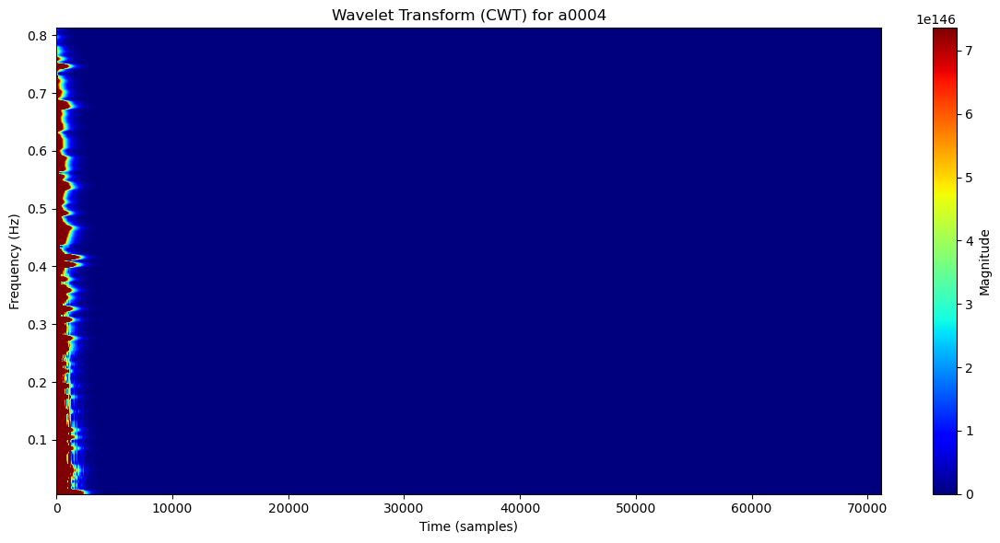

KeyboardInterrupt: 

In [1]:
# Wavelet transform plot
import wfdb
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
from scipy.signal import butter, filtfilt

# Set folder path containing your ECG files
folder_path = "./bsp_dataset/Training-a"

# List all ECG data samples (assuming they are in .dat format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.dat')]

# Function for wavelet denoising
def wavelet_denoising(signal, wavelet='db6', level=None):
    coeffs = pywt.wavedec(signal, wavelet, mode='per', level=level)
    sigma = np.median(np.abs(coeffs[-1])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(len(signal)))
    denoised_coeffs = [pywt.threshold(c, threshold, mode='soft') for c in coeffs]
    return pywt.waverec(denoised_coeffs, wavelet, mode='per')

# Function for bandpass filtering
def bandpass_filter(signal, lowcut=0.5, highcut=50.0, fs=1000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function to compute wavelet transform (time-frequency analysis)
def compute_wavelet_transform(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef, freqs

# Main function to process and visualize the ECG signal step-by-step
def process_ecg_signal(record_name, folder_path):
    # Step 1: Load ECG record
    record = wfdb.rdrecord(os.path.join(folder_path, record_name))
    ecg_signal = record.p_signal[:, 0]  # Assuming the first channel is ECG
    
    # Step 2: Apply bandpass filter
    filtered_ecg = bandpass_filter(ecg_signal)

    # Step 3: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 128)  # Scale range
    coef, freqs = compute_wavelet_transform(filtered_ecg, scales=scales)

    # Plot results
    plt.figure(figsize=(12, 6))

    # Plot Continuous Wavelet Transform (CWT)
    plt.imshow(np.abs(coef), extent=[0, len(filtered_ecg), freqs.min(), freqs.max()],
               cmap='jet', aspect='auto', vmax=np.percentile(np.abs(coef), 99), vmin=np.percentile(np.abs(coef), 1))  # Adjusting vmin and vmax for better contrast
    plt.colorbar(label='Magnitude')
    plt.title(f'Wavelet Transform (CWT) for {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Frequency (Hz)')

    plt.tight_layout()
    plt.show()

# Loop through the samples and process each ECG record
for sample in samples:
    record_name = sample.replace('.dat', '')
    process_ecg_signal(record_name, folder_path)

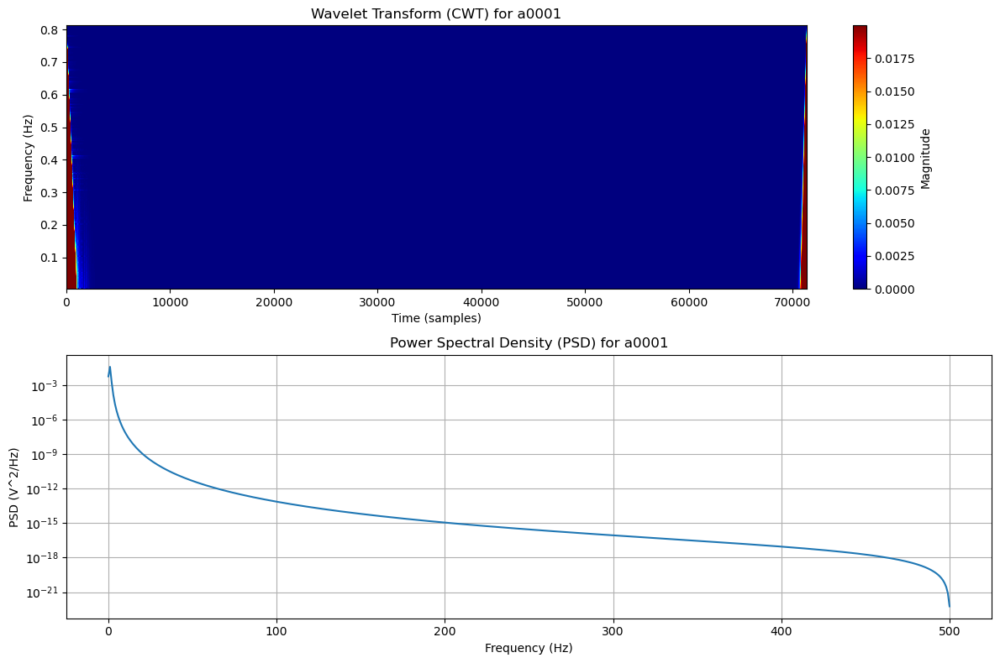

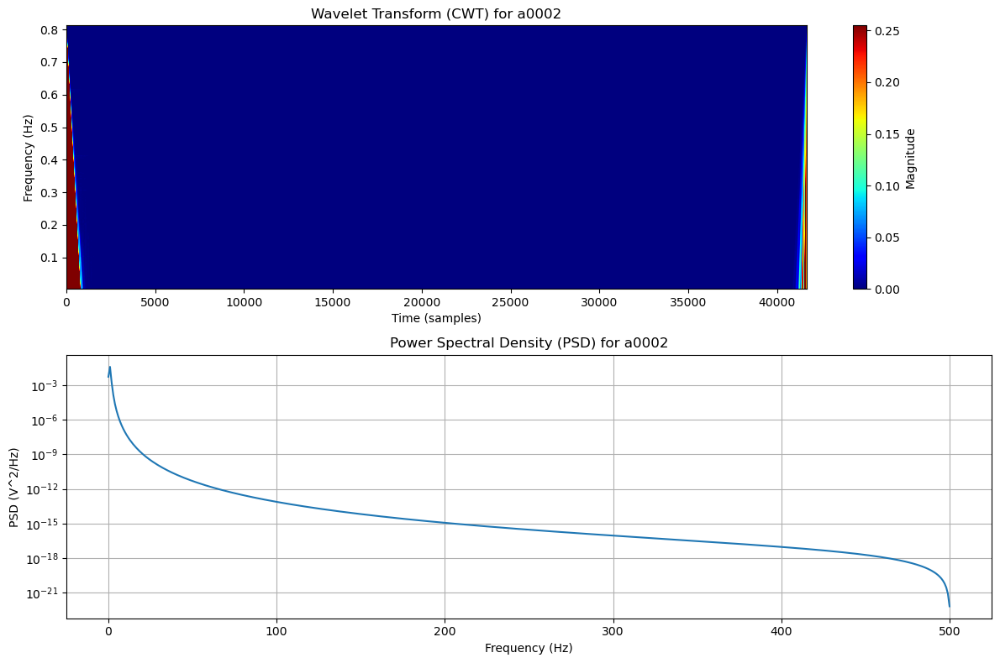

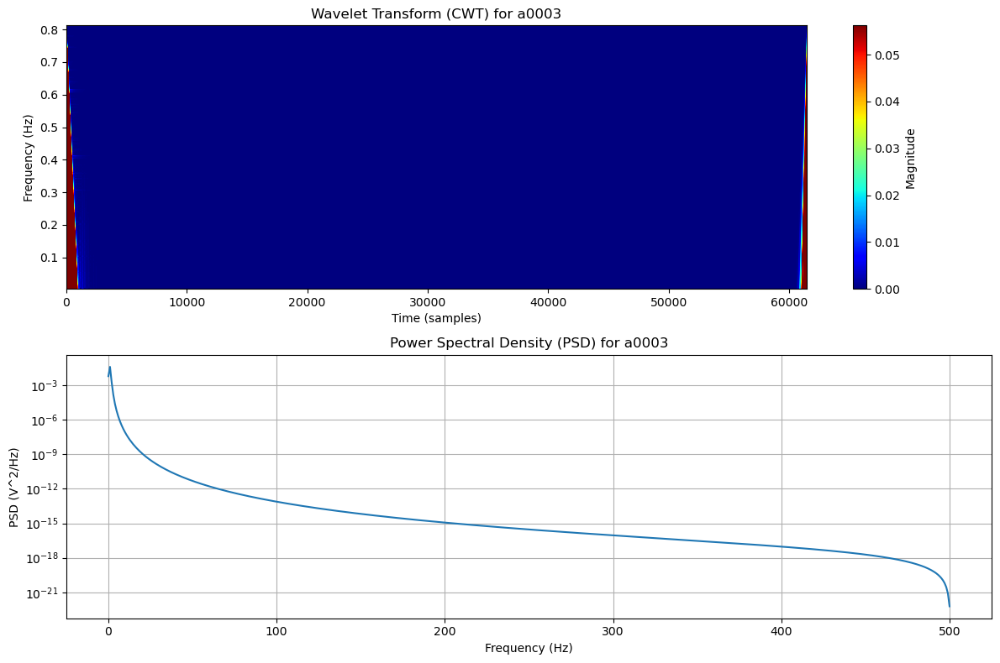

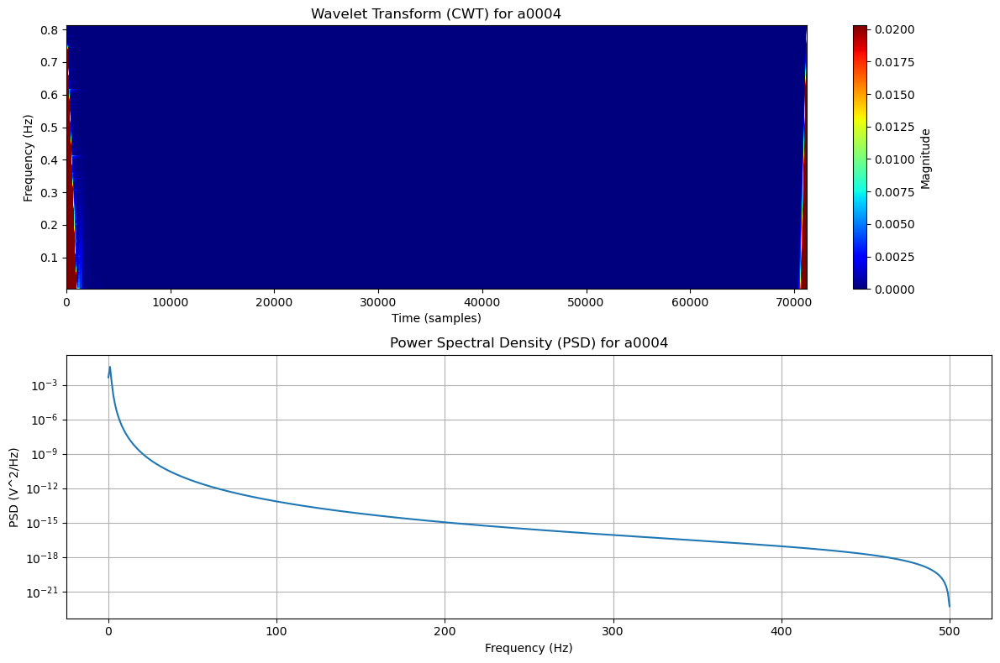

KeyboardInterrupt: 

In [9]:
import wfdb
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
from scipy.signal import butter, filtfilt, welch

# Set folder path containing your ECG files
folder_path = "./bsp_dataset/Training-a"

# List all ECG data samples (assuming they are in .dat format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.dat')]

# Function for wavelet denoising
def wavelet_denoising(signal, wavelet='db6', level=None):
    coeffs = pywt.wavedec(signal, wavelet, mode='per', level=level)
    sigma = np.median(np.abs(coeffs[-1])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(len(signal)))
    denoised_coeffs = [pywt.threshold(c, threshold, mode='soft') for c in coeffs]
    return pywt.waverec(denoised_coeffs, wavelet, mode='per')

# Function for bandpass filtering
def bandpass_filter(signal, lowcut=0.5, highcut=50.0, fs=1000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function for normalizing the signal
def normalize_signal(signal):
    normalized_signal = (signal - np.mean(signal)) / np.std(signal)  # Z-score normalization
    return normalized_signal

# Function to compute wavelet transform (time-frequency analysis)
def compute_wavelet_transform(signal, wavelet='morl', scales=np.arange(1, 256)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef, freqs

# Function to compute Power Spectral Density (PSD)
def compute_psd(signal, fs=1000):
    f, Pxx = welch(signal, fs, nperseg=1024)
    return f, Pxx

# Main function to process and visualize the ECG signal step-by-step
def process_ecg_signal(record_name, folder_path):
    # Step 1: Load ECG record
    record = wfdb.rdrecord(os.path.join(folder_path, record_name))
    ecg_signal = record.p_signal[:, 0]  # Assuming the first channel is ECG
    
    # Step 2: Apply wavelet denoising
    denoised_ecg = wavelet_denoising(ecg_signal)

    # Step 3: Apply bandpass filter
    filtered_ecg = bandpass_filter(denoised_ecg)

    # Step 4: Normalize the signal
    normalized_ecg = normalize_signal(filtered_ecg)

    # Step 5: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 256)  # Increase scale range to capture more frequency details
    coef, freqs = compute_wavelet_transform(normalized_ecg, scales=scales)

    # Step 6: Compute Power Spectral Density (PSD) of the original denoised and filtered signal
    f, Pxx = compute_psd(normalized_ecg)

    # Plot results
    plt.figure(figsize=(12, 8))

    # Plot Continuous Wavelet Transform (CWT)
    plt.subplot(2, 1, 1)
    plt.imshow(np.abs(coef), extent=[0, len(normalized_ecg), freqs.min(), freqs.max()],
               cmap='jet', aspect='auto', vmax=np.percentile(np.abs(coef), 99), vmin=np.percentile(np.abs(coef), 1))
    plt.colorbar(label='Magnitude')
    plt.title(f'Wavelet Transform (CWT) for {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Frequency (Hz)')

    # Plot Power Spectral Density (PSD) of the original signal
    plt.subplot(2, 1, 2)
    plt.semilogy(f, Pxx)
    plt.title(f'Power Spectral Density (PSD) for {record_name}')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('PSD (V^2/Hz)')
    plt.grid()

    plt.tight_layout()
    plt.show()

# Loop through the samples and process each ECG record
for sample in samples:
    record_name = sample.replace('.dat', '')
    process_ecg_signal(record_name, folder_path)


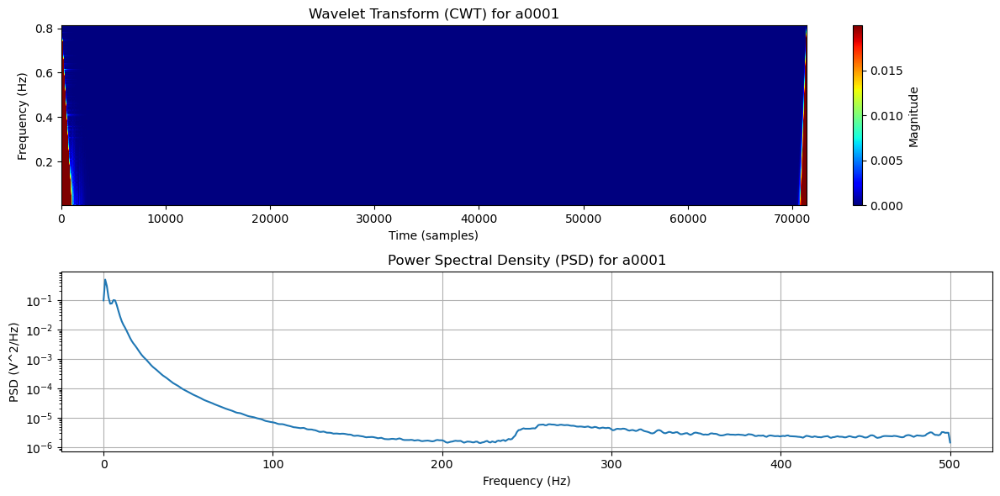

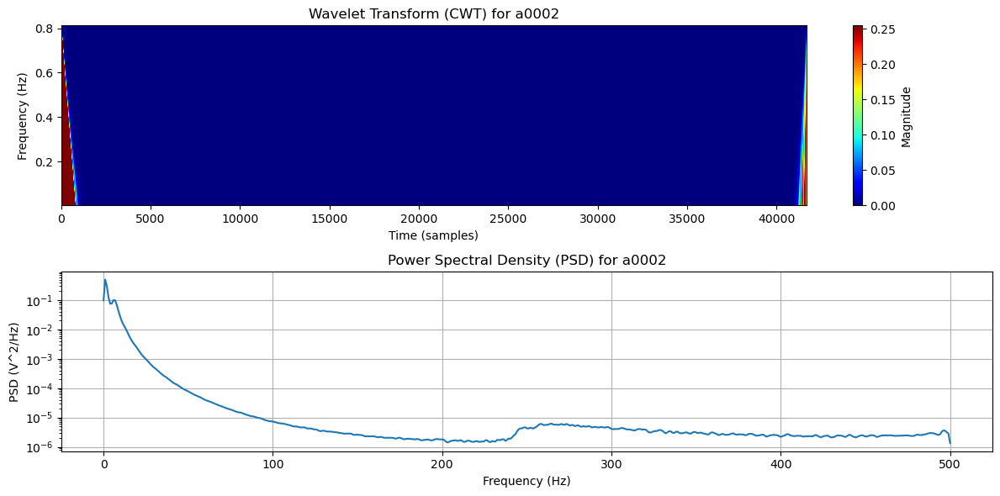

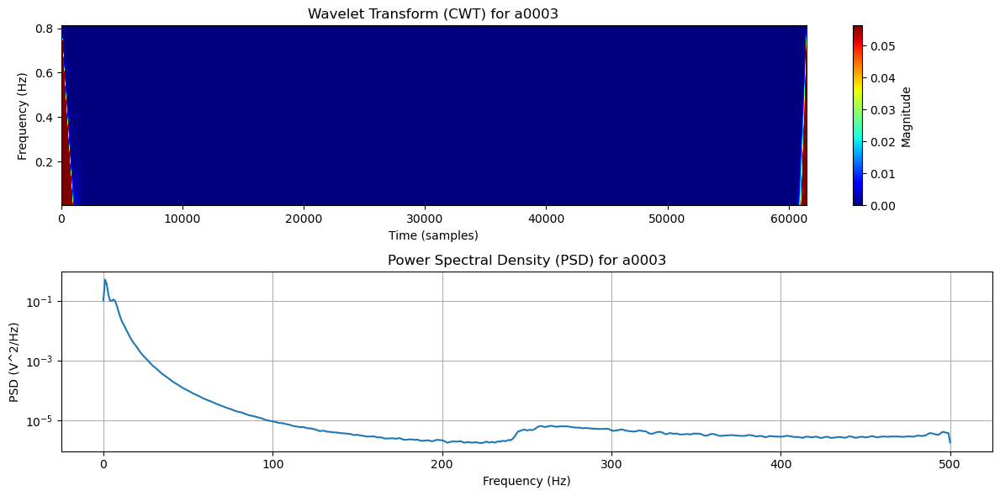

KeyboardInterrupt: 

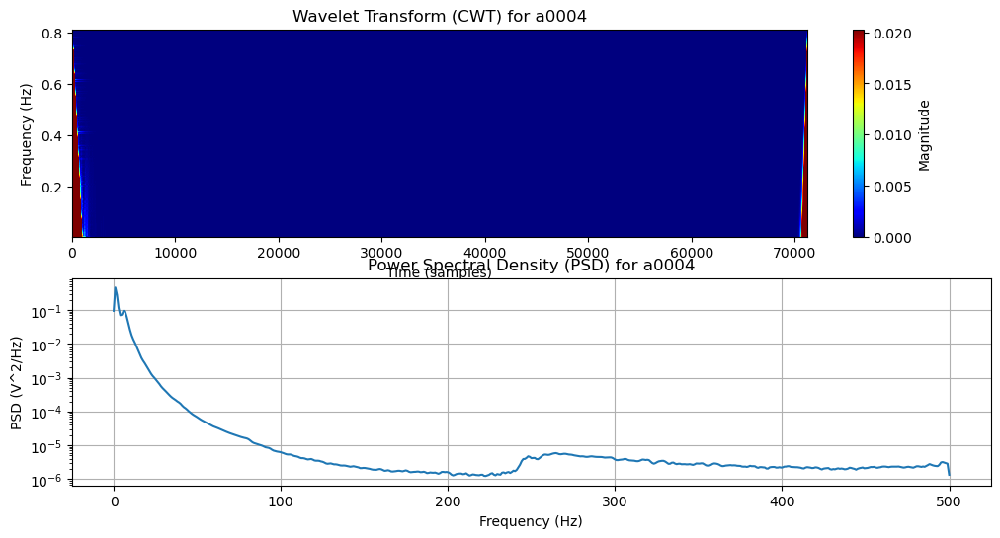

In [10]:
import wfdb
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
from scipy.signal import butter, filtfilt, welch

# Set folder path containing your ECG files
folder_path = "./bsp_dataset/Training-a"

# List all ECG data samples (assuming they are in .dat format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.dat')]

# Function for wavelet denoising
def wavelet_denoising(signal, wavelet='db6', level=None):
    coeffs = pywt.wavedec(signal, wavelet, mode='per', level=level)
    sigma = np.median(np.abs(coeffs[-1])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(len(signal)))
    denoised_coeffs = [pywt.threshold(c, threshold, mode='soft') for c in coeffs]
    return pywt.waverec(denoised_coeffs, wavelet, mode='per')

# Function for bandpass filtering
def bandpass_filter(signal, lowcut=0.5, highcut=50.0, fs=1000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function for normalizing the signal
def normalize_signal(signal):
    normalized_signal = (signal - np.mean(signal)) / np.std(signal)  # Z-score normalization
    return normalized_signal

# Function to compute wavelet transform (time-frequency analysis)
def compute_wavelet_transform(signal, wavelet='morl', scales=np.arange(1, 256)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef, freqs

# Function to compute Power Spectral Density (PSD)
def compute_psd(signal, fs=1000):
    f, Pxx = welch(signal, fs, nperseg=1024)
    return f, Pxx

# Main function to process and visualize the ECG signal step-by-step
def process_ecg_signal(record_name, folder_path):
    # Step 1: Load ECG record
    record = wfdb.rdrecord(os.path.join(folder_path, record_name))
    ecg_signal = record.p_signal[:, 0]  # Assuming the first channel is ECG
    
    # Step 2: Apply wavelet denoising
    denoised_ecg = wavelet_denoising(ecg_signal)

    # Step 3: Apply bandpass filter
    filtered_ecg = bandpass_filter(denoised_ecg)

    # Step 4: Normalize the signal
    normalized_ecg = normalize_signal(filtered_ecg)

    # Step 5: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 256)  # Increase scale range to capture more frequency details
    coef, freqs = compute_wavelet_transform(normalized_ecg, scales=scales)

    # Compute Power Spectral Density (PSD) of the CWT output
    f, Pxx = compute_psd(np.abs(coef).flatten())

    # Plot results
    plt.figure(figsize=(12, 6))

    # Plot Continuous Wavelet Transform (CWT)
    plt.subplot(2, 1, 1)
    plt.imshow(np.abs(coef), extent=[0, len(normalized_ecg), freqs.min(), freqs.max()],
               cmap='jet', aspect='auto', vmax=np.percentile(np.abs(coef), 99), vmin=np.percentile(np.abs(coef), 1))
    plt.colorbar(label='Magnitude')
    plt.title(f'Wavelet Transform (CWT) for {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Frequency (Hz)')

    # Plot Power Spectral Density (PSD)
    plt.subplot(2, 1, 2)
    plt.semilogy(f, Pxx)
    plt.title(f'Power Spectral Density (PSD) for {record_name}')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('PSD (V^2/Hz)')
    plt.grid()

    plt.tight_layout()
    plt.show()

# Loop through the samples and process each ECG record
for sample in samples:
    record_name = sample.replace('.dat', '')
    process_ecg_signal(record_name, folder_path)

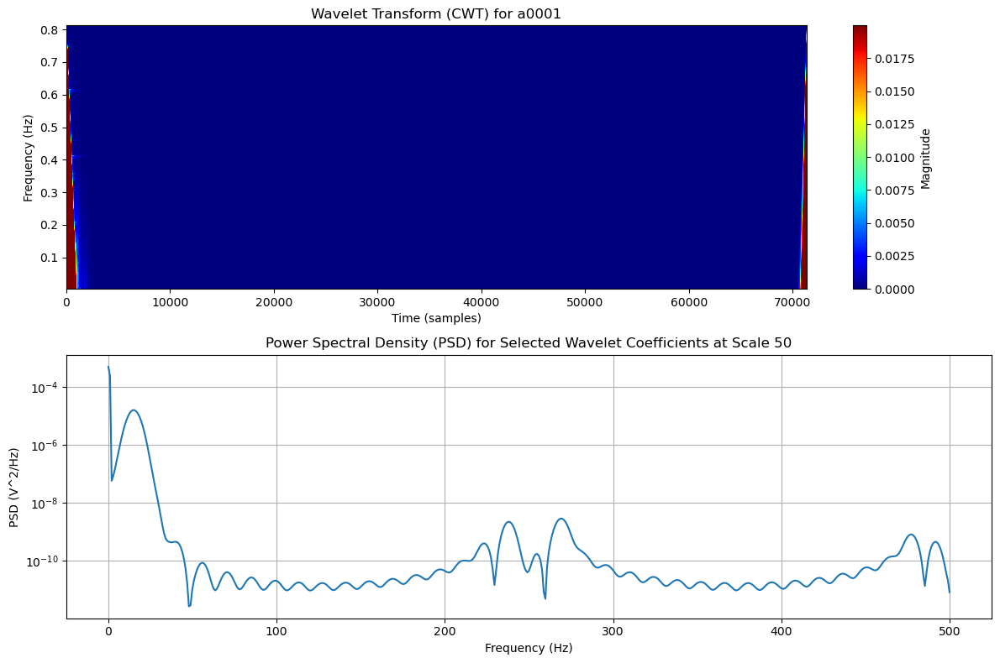

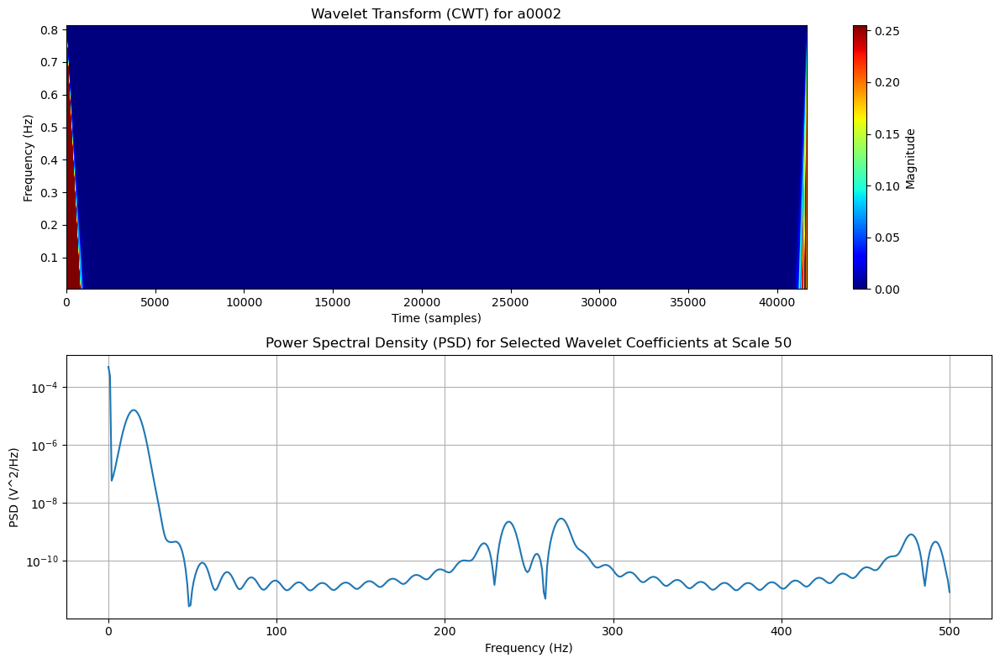

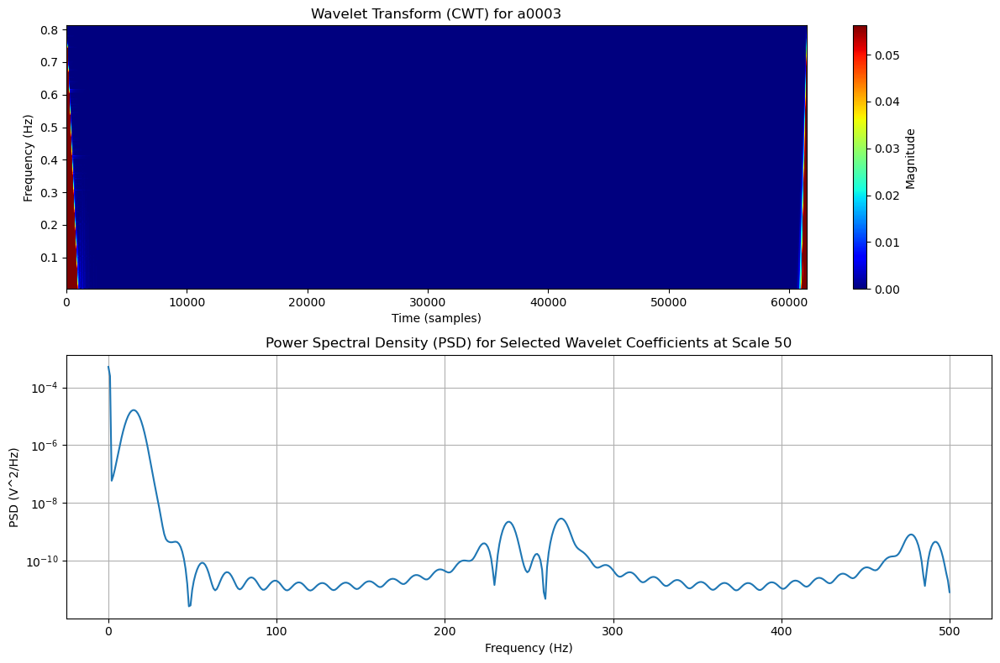

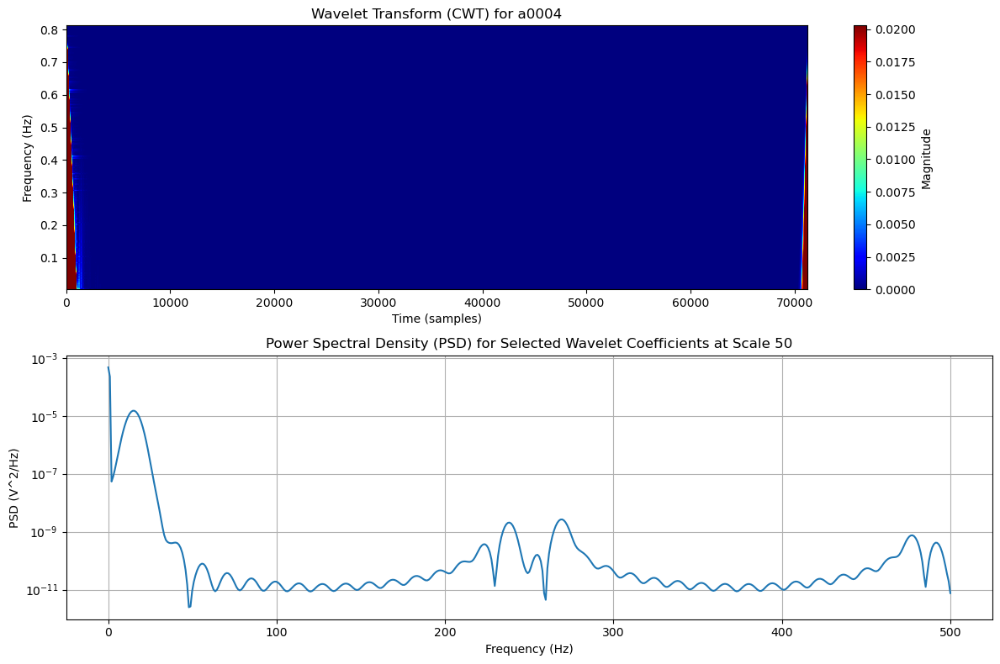

C:\Users\Harshith\AppData\Local\Temp\ipykernel_14420\2909188515.py:97: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  plt.tight_layout()


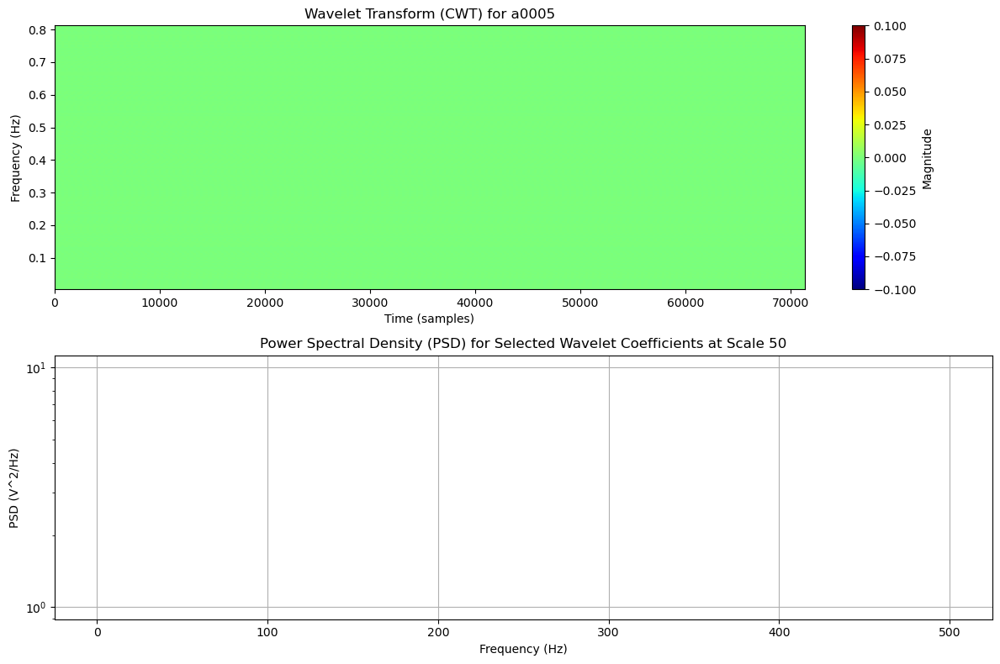

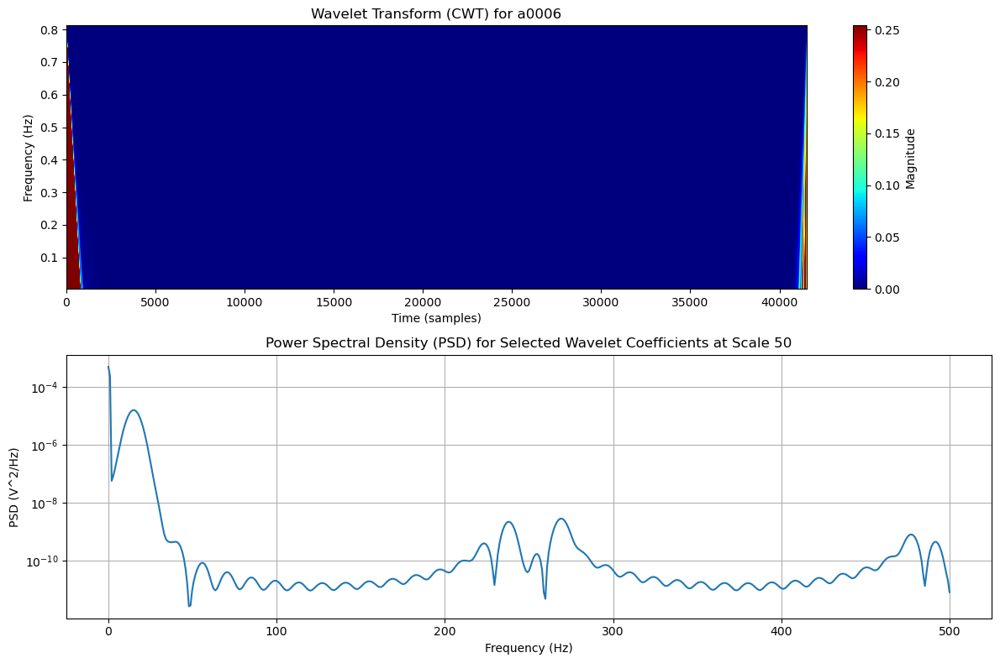

KeyboardInterrupt: 

In [11]:
import wfdb
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
from scipy.signal import butter, filtfilt, welch

# Set folder path containing your ECG files
folder_path = "./bsp_dataset/Training-a"

# List all ECG data samples (assuming they are in .dat format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.dat')]

# Function for wavelet denoising
def wavelet_denoising(signal, wavelet='db6', level=None):
    coeffs = pywt.wavedec(signal, wavelet, mode='per', level=level)
    sigma = np.median(np.abs(coeffs[-1])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(len(signal)))
    denoised_coeffs = [pywt.threshold(c, threshold, mode='soft') for c in coeffs]
    return pywt.waverec(denoised_coeffs, wavelet, mode='per')

# Function for bandpass filtering
def bandpass_filter(signal, lowcut=0.5, highcut=50.0, fs=1000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function for normalizing the signal
def normalize_signal(signal):
    normalized_signal = (signal - np.mean(signal)) / np.std(signal)  # Z-score normalization
    return normalized_signal

# Function to compute wavelet transform (time-frequency analysis)
def compute_wavelet_transform(signal, wavelet='morl', scales=np.arange(1, 256)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef, freqs

# Function to compute Power Spectral Density (PSD) from selected wavelet coefficients
def compute_psd_from_wavelet(coef, fs=1000, scale_idx=None):
    # Select specific scales (frequencies) if provided; otherwise, flatten all coefficients
    if scale_idx is not None:
        selected_wavelet_coeffs = coef[scale_idx, :]
    else:
        selected_wavelet_coeffs = coef.flatten()
    
    # Compute the PSD of the selected wavelet coefficients
    f, Pxx = welch(selected_wavelet_coeffs, fs, nperseg=1024)
    return f, Pxx

# Main function to process and visualize the ECG signal step-by-step
def process_ecg_signal(record_name, folder_path):
    # Step 1: Load ECG record
    record = wfdb.rdrecord(os.path.join(folder_path, record_name))
    ecg_signal = record.p_signal[:, 0]  # Assuming the first channel is ECG
    
    # Step 2: Apply wavelet denoising
    denoised_ecg = wavelet_denoising(ecg_signal)

    # Step 3: Apply bandpass filter
    filtered_ecg = bandpass_filter(denoised_ecg)

    # Step 4: Normalize the signal
    normalized_ecg = normalize_signal(filtered_ecg)

    # Step 5: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 256)  # Increase scale range to capture more frequency details
    coef, freqs = compute_wavelet_transform(normalized_ecg, scales=scales)

    # Step 6: Compute Power Spectral Density (PSD) from selected wavelet coefficients
    # Choose a specific scale for PSD (e.g., scale corresponding to a frequency band)
    scale_idx = 50  # Example: use the 50th scale for analysis (adjust as needed)
    f, Pxx = compute_psd_from_wavelet(coef, scale_idx=scale_idx)

    # Plot results
    plt.figure(figsize=(12, 8))

    # Plot Continuous Wavelet Transform (CWT)
    plt.subplot(2, 1, 1)
    plt.imshow(np.abs(coef), extent=[0, len(normalized_ecg), freqs.min(), freqs.max()],
               cmap='jet', aspect='auto', vmax=np.percentile(np.abs(coef), 99), vmin=np.percentile(np.abs(coef), 1))
    plt.colorbar(label='Magnitude')
    plt.title(f'Wavelet Transform (CWT) for {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Frequency (Hz)')

    # Plot Power Spectral Density (PSD) of the selected wavelet coefficients
    plt.subplot(2, 1, 2)
    plt.semilogy(f, Pxx)
    plt.title(f'Power Spectral Density (PSD) for Selected Wavelet Coefficients at Scale {scale_idx}')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('PSD (V^2/Hz)')
    plt.grid()

    plt.tight_layout()
    plt.show()

# Loop through the samples and process each ECG record
for sample in samples:
    record_name = sample.replace('.dat', '')
    process_ecg_signal(record_name, folder_path)


Lowcut: 0.02, Highcut: 0.99, Nyquist: 1000.0, fs: 2000


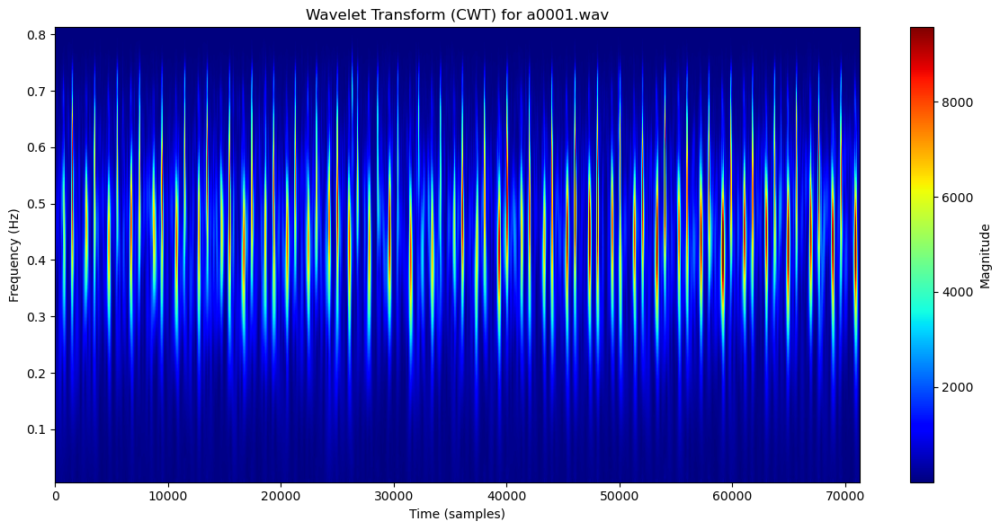

Lowcut: 0.02, Highcut: 0.99, Nyquist: 1000.0, fs: 2000


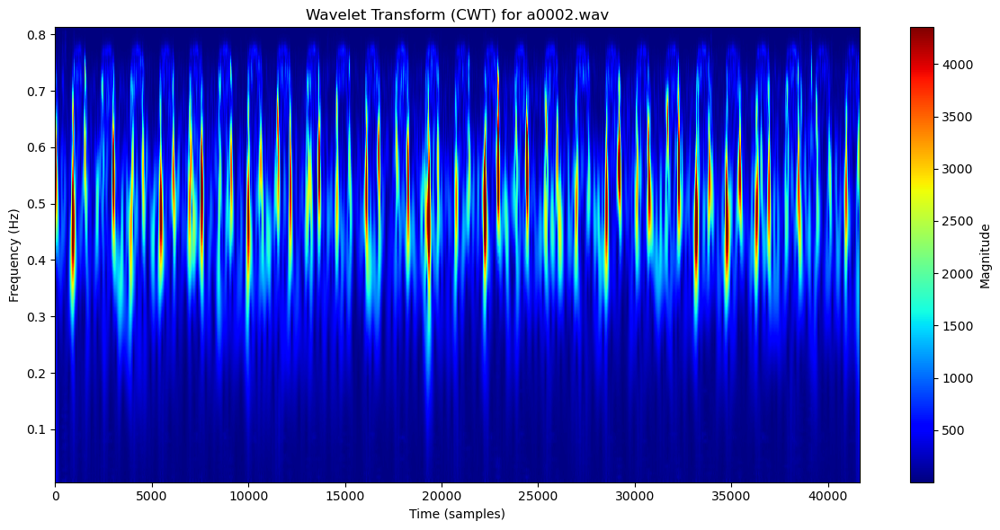

Lowcut: 0.02, Highcut: 0.99, Nyquist: 1000.0, fs: 2000


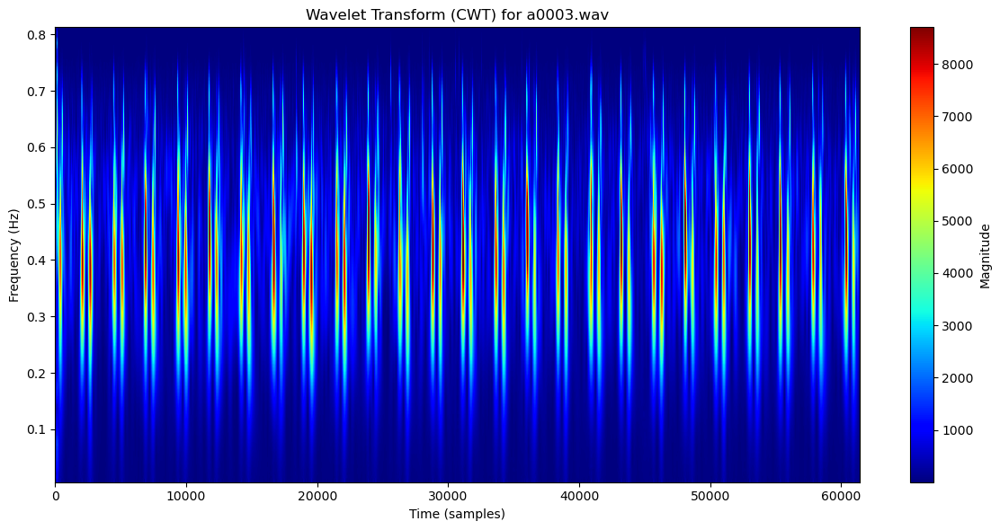

Lowcut: 0.02, Highcut: 0.99, Nyquist: 1000.0, fs: 2000


KeyboardInterrupt: 

In [6]:
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
from scipy.signal import butter, filtfilt
from scipy.io import wavfile

# Set folder path containing your PCG files
folder_path = "./bsp_dataset/Training-a"

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Function for wavelet denoising (optional if you want to denoise before processing)
def wavelet_denoising(signal, wavelet='db6', level=None):
    coeffs = pywt.wavedec(signal, wavelet, mode='per', level=level)
    sigma = np.median(np.abs(coeffs[-1])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(len(signal)))
    denoised_coeffs = [pywt.threshold(c, threshold, mode='soft') for c in coeffs]
    return pywt.waverec(denoised_coeffs, wavelet)

# Function for bandpass filtering
def bandpass_filter(signal, lowcut=20.0, highcut=1000.0, fs=5000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = (highcut / nyquist) * 0.99  # Adjust the highcut to be slightly less than 1.0
    print(f"Lowcut: {low}, Highcut: {high}, Nyquist: {nyquist}, fs: {fs}")  # Debugging print
    if low <= 0 or high >= 1:
        raise ValueError(f"Critical frequencies must be in the range (0, 1), but got low={low} and high={high}.")
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function to compute wavelet transform (time-frequency analysis)
def compute_wavelet_transform(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef, freqs

# Main function to process and visualize the PCG signal step-by-step
def process_pcg_signal(record_name, folder_path):
    # Step 1: Load PCG record from .wav file
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    
    # If the signal is stereo, take only the first channel
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]

    # Step 2: Apply bandpass filter
    filtered_pcg = bandpass_filter(pcg_signal, fs=fs)  # Use correct sampling frequency

    # Step 3: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 128)  # Scale range
    coef, freqs = compute_wavelet_transform(filtered_pcg, scales=scales)

    # Plot results
    plt.figure(figsize=(12, 6))

    # Plot Continuous Wavelet Transform (CWT)
    plt.imshow(np.abs(coef), extent=[0, len(filtered_pcg), freqs.min(), freqs.max()],
               cmap='jet', aspect='auto', vmax=np.percentile(np.abs(coef), 99), vmin=np.percentile(np.abs(coef), 1))  # Adjusting vmin and vmax for better contrast
    plt.colorbar(label='Magnitude')
    plt.title(f'Wavelet Transform (CWT) for {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Frequency (Hz)')

    plt.tight_layout()
    plt.show()

# Loop through the samples and process each PCG record
for sample in samples:
    process_pcg_signal(sample, folder_path)


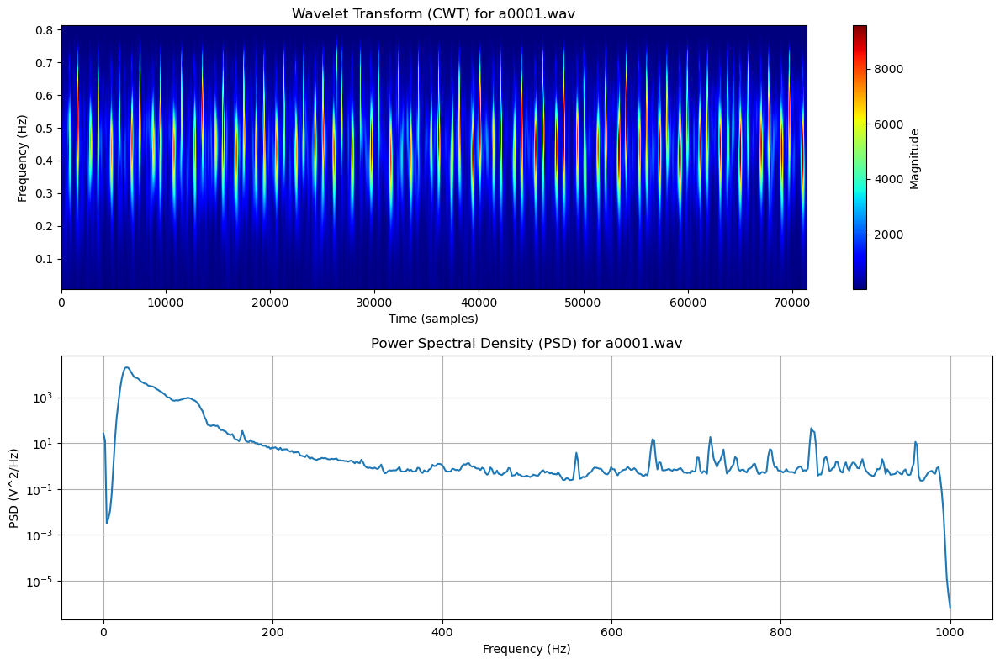

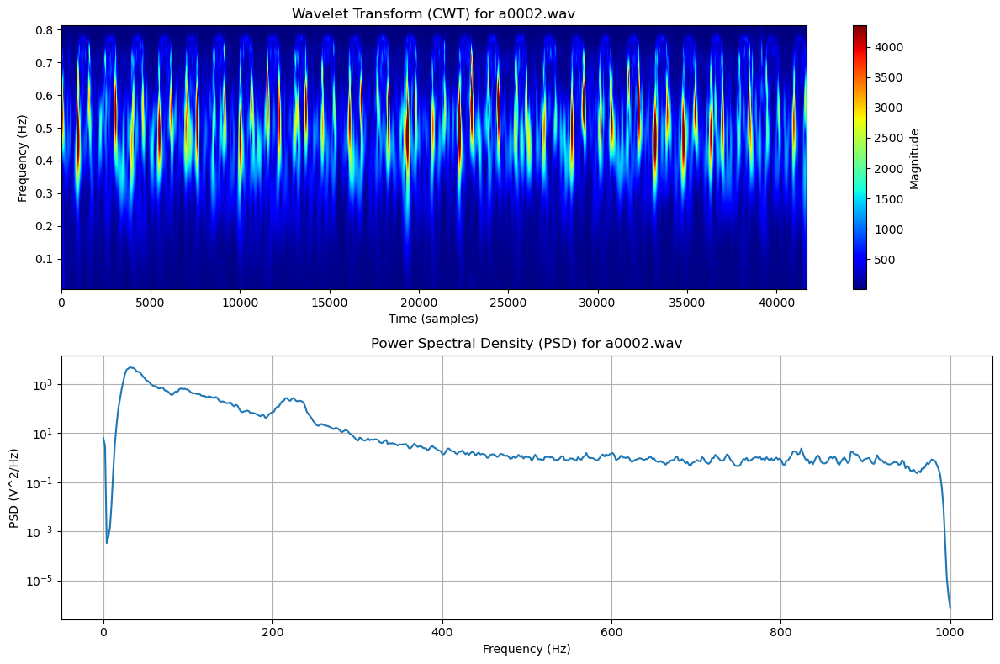

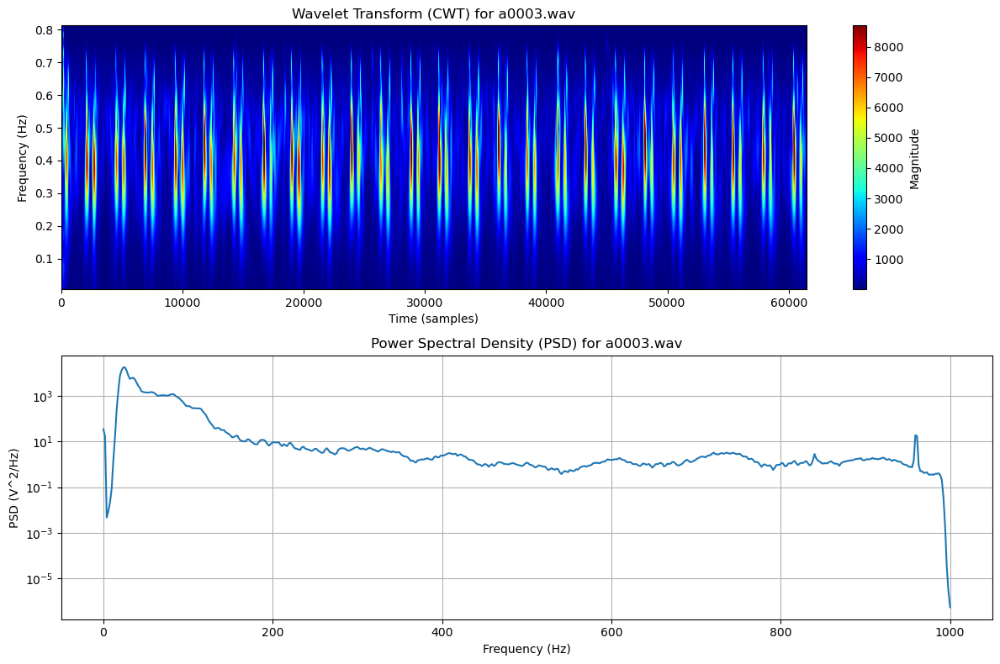

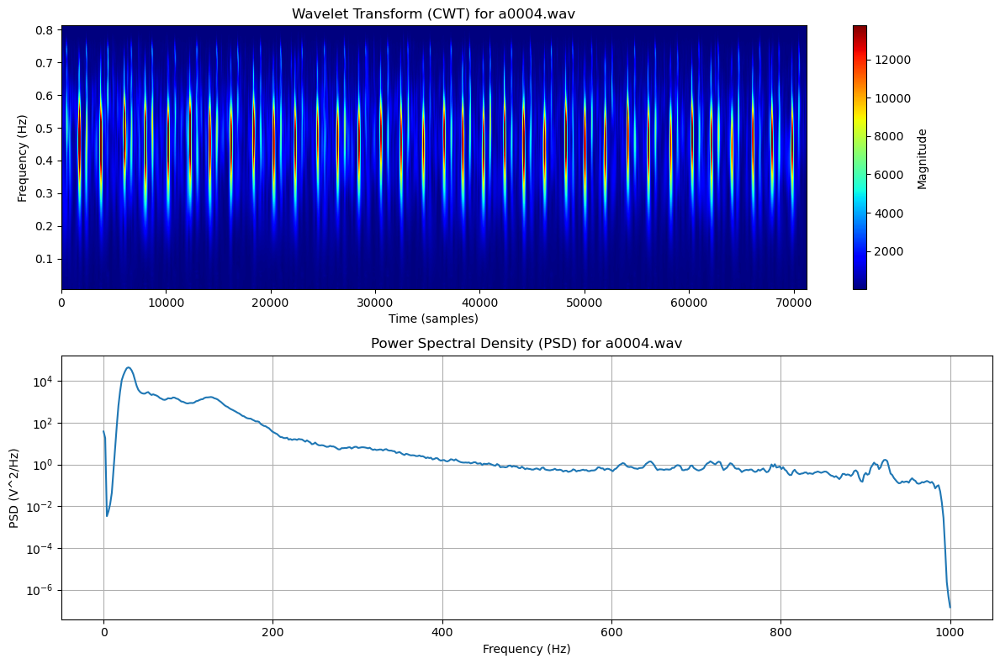

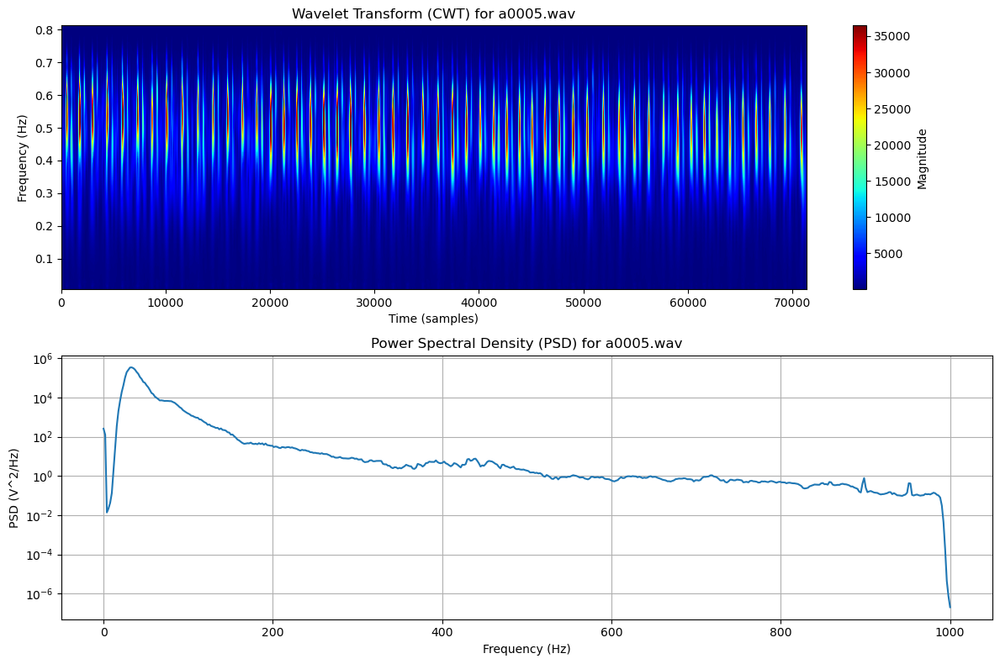

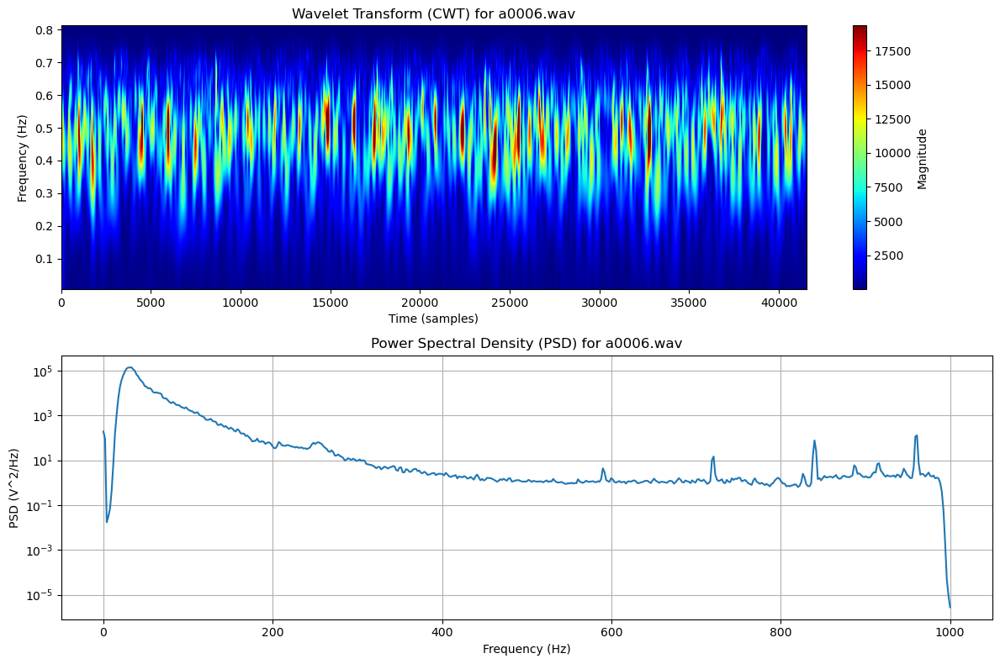

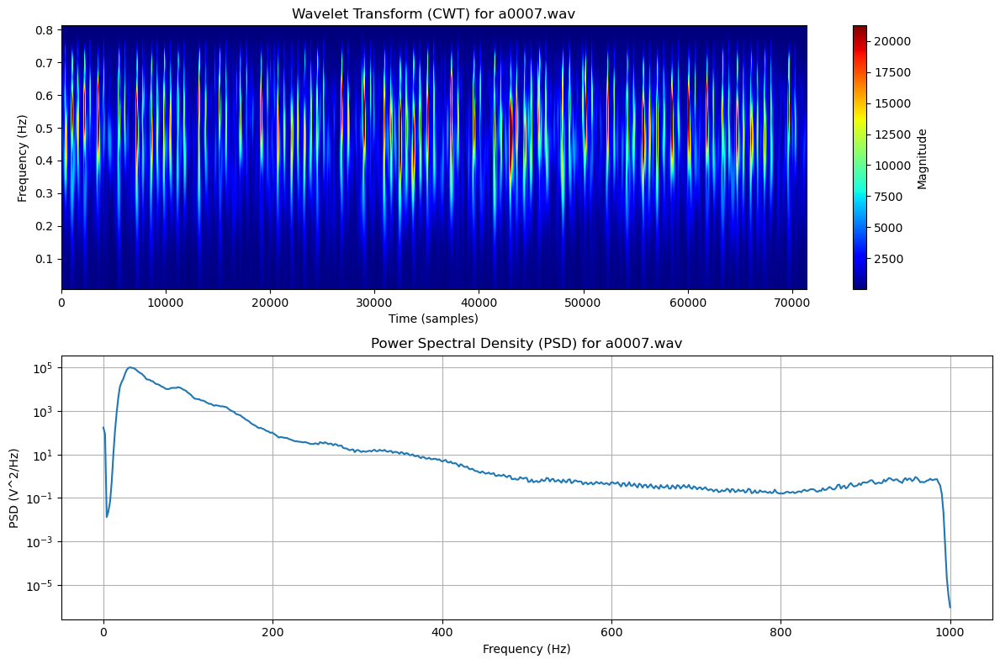

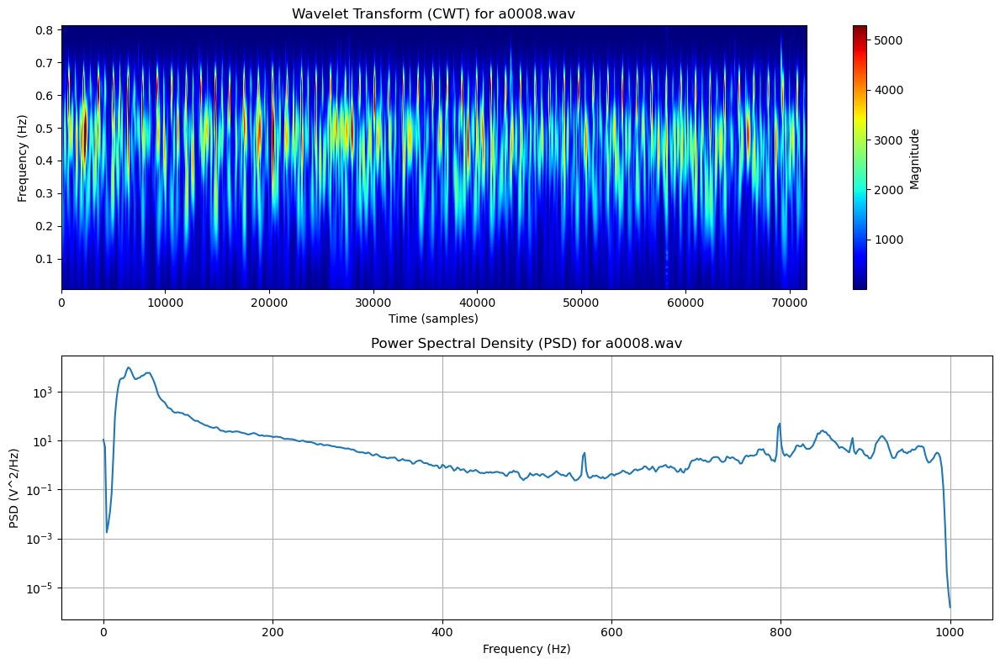

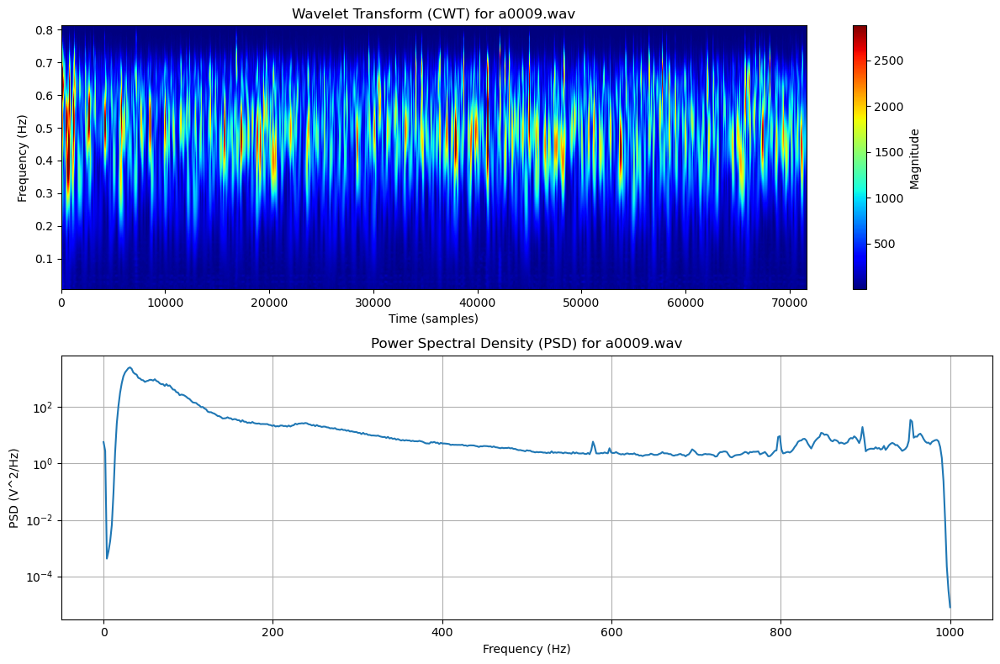

KeyboardInterrupt: 

In [12]:
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
from scipy.signal import butter, filtfilt, welch
from scipy.io import wavfile

# Set folder path containing your PCG files
folder_path = "./bsp_dataset/Training-a"

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Function for wavelet denoising (optional if you want to denoise before processing)
def wavelet_denoising(signal, wavelet='db6', level=None):
    coeffs = pywt.wavedec(signal, wavelet, mode='per', level=level)
    sigma = np.median(np.abs(coeffs[-1])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(len(signal)))
    denoised_coeffs = [pywt.threshold(c, threshold, mode='soft') for c in coeffs]
    return pywt.waverec(denoised_coeffs, wavelet)

# Function for bandpass filtering
def bandpass_filter(signal, lowcut=20.0, highcut=1000.0, fs=5000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = (highcut / nyquist) * 0.99  # Adjust the highcut to be slightly less than 1.0
    if low <= 0 or high >= 1:
        raise ValueError(f"Critical frequencies must be in the range (0, 1), but got low={low} and high={high}.")
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function to compute wavelet transform (time-frequency analysis)
def compute_wavelet_transform(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef, freqs

# Function to compute Power Spectral Density (PSD)
def compute_psd(signal, fs=5000):
    f, Pxx = welch(signal, fs, nperseg=1024)
    return f, Pxx

# Main function to process and visualize the PCG signal step-by-step
def process_pcg_signal(record_name, folder_path):
    # Step 1: Load PCG record from .wav file
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    
    # If the signal is stereo, take only the first channel
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]

    # Step 2: Apply bandpass filter
    filtered_pcg = bandpass_filter(pcg_signal, fs=fs)  # Use correct sampling frequency

    # Step 3: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 128)  # Scale range
    coef, freqs = compute_wavelet_transform(filtered_pcg, scales=scales)

    # Step 4: Compute Power Spectral Density (PSD)
    f, Pxx = compute_psd(filtered_pcg, fs=fs)  # Compute PSD of the filtered signal

    # Plot results
    plt.figure(figsize=(12, 8))

    # Plot Continuous Wavelet Transform (CWT)
    plt.subplot(2, 1, 1)
    plt.imshow(np.abs(coef), extent=[0, len(filtered_pcg), freqs.min(), freqs.max()],
               cmap='jet', aspect='auto', vmax=np.percentile(np.abs(coef), 99), vmin=np.percentile(np.abs(coef), 1))
    plt.colorbar(label='Magnitude')
    plt.title(f'Wavelet Transform (CWT) for {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Frequency (Hz)')

    # Plot Power Spectral Density (PSD)
    plt.subplot(2, 1, 2)
    plt.semilogy(f, Pxx)
    plt.title(f'Power Spectral Density (PSD) for {record_name}')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('PSD (V^2/Hz)')
    plt.grid()

    plt.tight_layout()
    plt.show()

# Loop through the samples and process each PCG record
for sample in samples:
    process_pcg_signal(sample, folder_path)


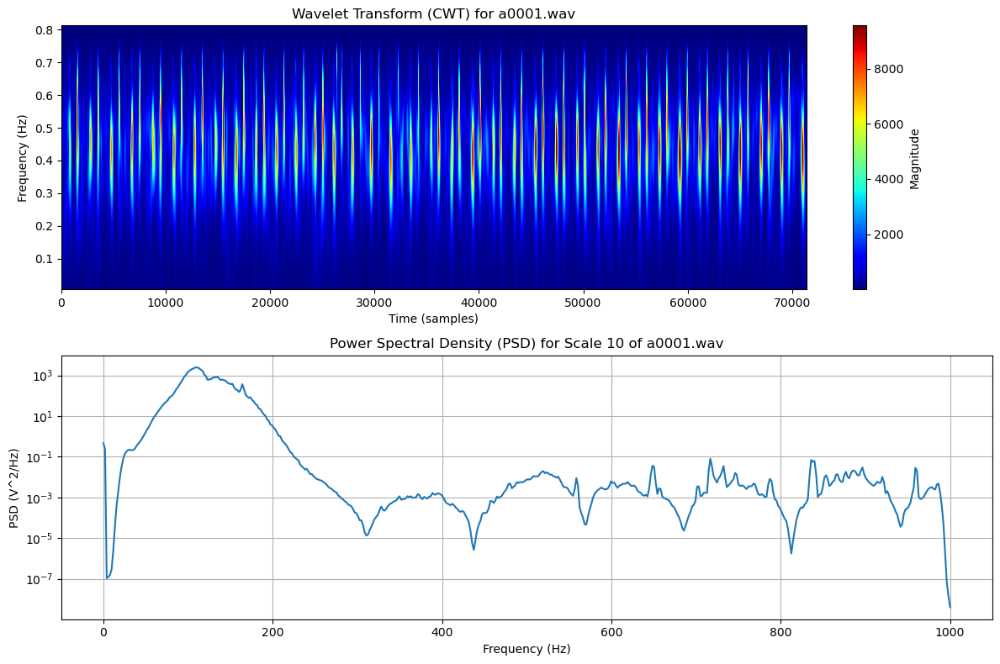

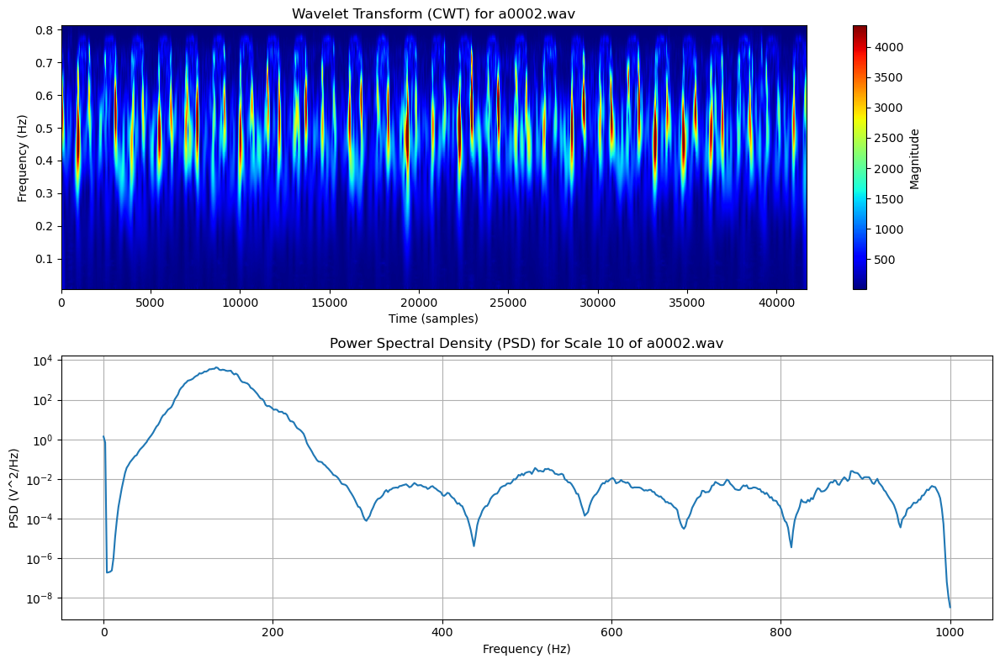

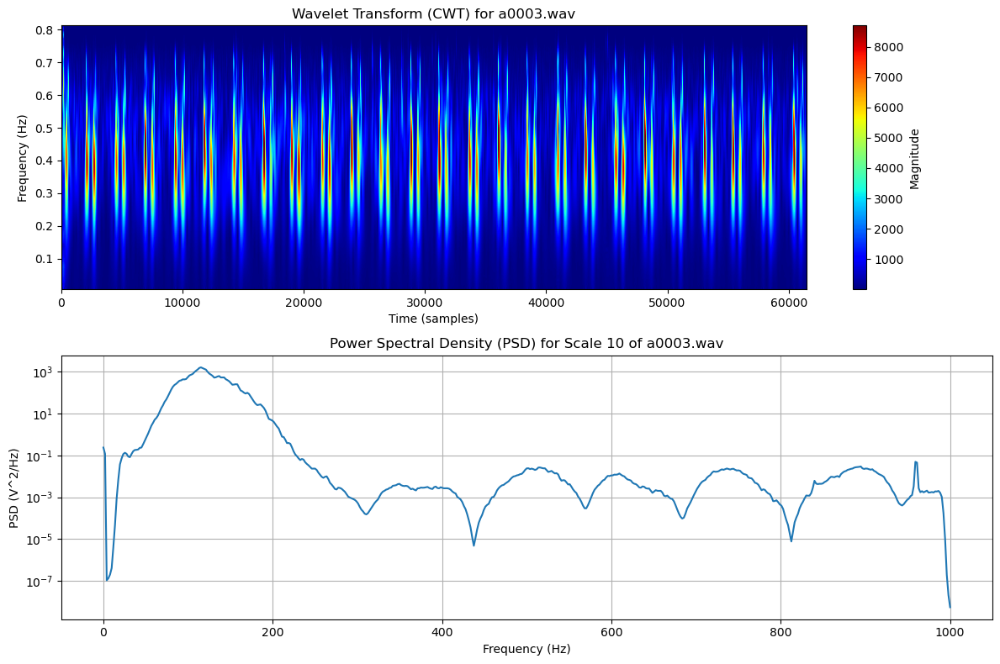

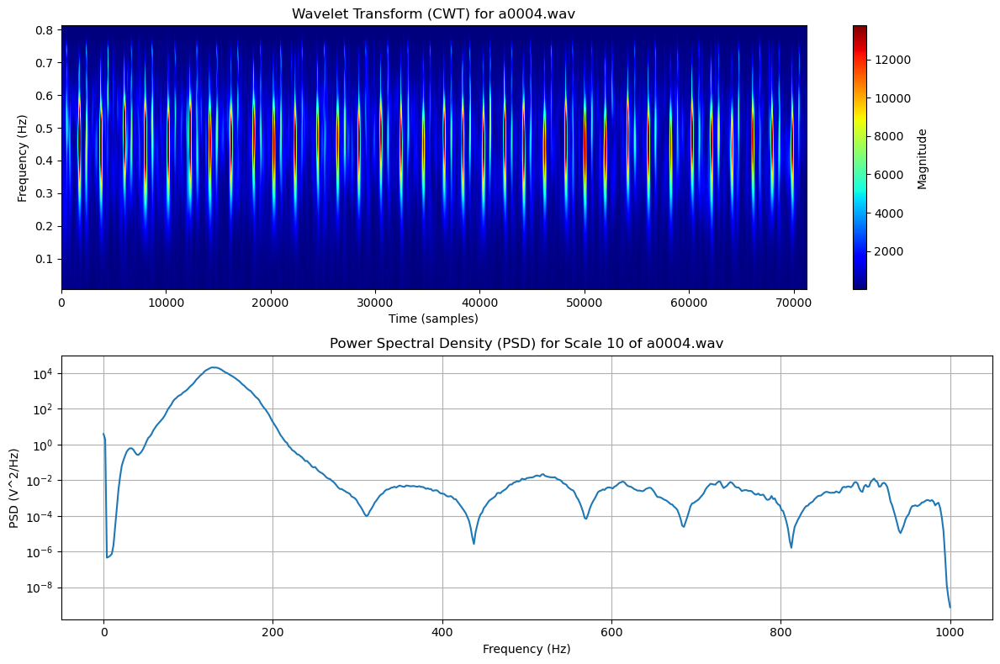

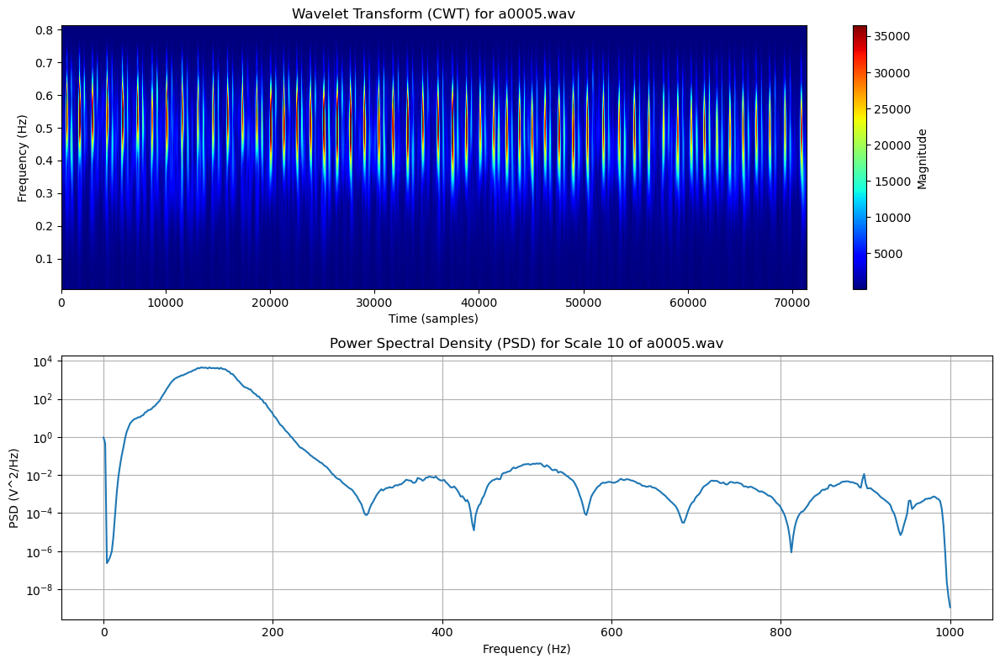

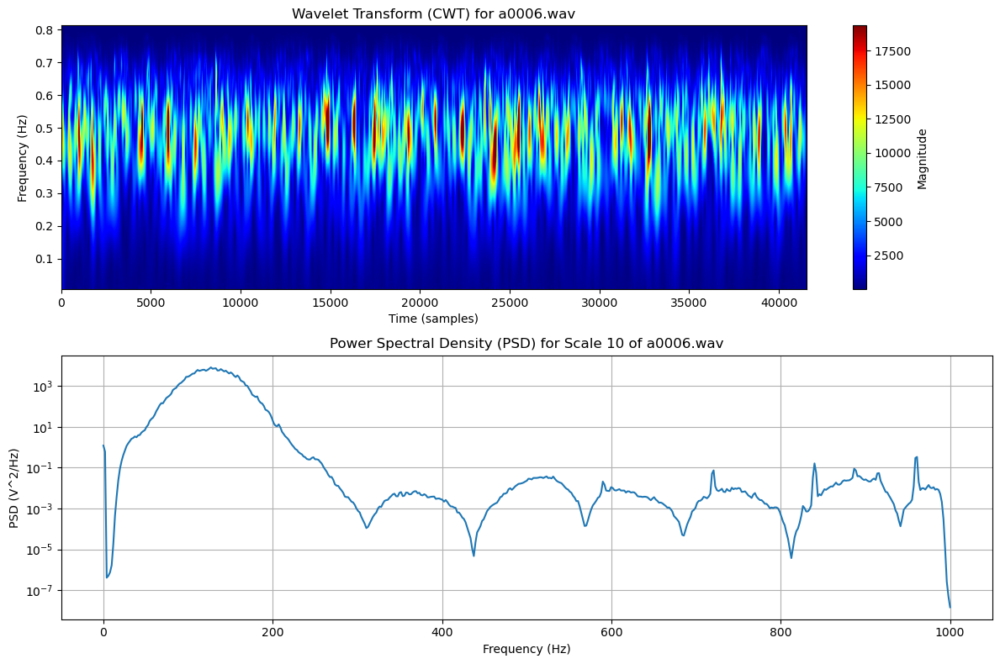

KeyboardInterrupt: 

In [13]:
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
from scipy.signal import butter, filtfilt, welch
from scipy.io import wavfile

# Set folder path containing your PCG files
folder_path = "./bsp_dataset/Training-a"

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Function for wavelet denoising (optional if you want to denoise before processing)
def wavelet_denoising(signal, wavelet='db6', level=None):
    coeffs = pywt.wavedec(signal, wavelet, mode='per', level=level)
    sigma = np.median(np.abs(coeffs[-1])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(len(signal)))
    denoised_coeffs = [pywt.threshold(c, threshold, mode='soft') for c in coeffs]
    return pywt.waverec(denoised_coeffs, wavelet)

# Function for bandpass filtering
def bandpass_filter(signal, lowcut=20.0, highcut=1000.0, fs=5000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = (highcut / nyquist) * 0.99  # Adjust the highcut to be slightly less than 1.0
    if low <= 0 or high >= 1:
        raise ValueError(f"Critical frequencies must be in the range (0, 1), but got low={low} and high={high}.")
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function to compute wavelet transform (time-frequency analysis)
def compute_wavelet_transform(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef, freqs

# Function to compute Power Spectral Density (PSD)
def compute_psd(signal, fs=5000):
    f, Pxx = welch(signal, fs, nperseg=1024)
    return f, Pxx

# Main function to process and visualize the PCG signal step-by-step
def process_pcg_signal(record_name, folder_path):
    # Step 1: Load PCG record from .wav file
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    
    # If the signal is stereo, take only the first channel
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]

    # Step 2: Apply bandpass filter
    filtered_pcg = bandpass_filter(pcg_signal, fs=fs)  # Use correct sampling frequency

    # Step 3: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 128)  # Scale range
    coef, freqs = compute_wavelet_transform(filtered_pcg, scales=scales)

    # Step 4: Compute Power Spectral Density (PSD) from wavelet coefficients
    # Select a scale for the PSD; for example, you can choose the first few scales
    selected_scale = 10  # Choose the scale you're interested in
    psd_signal = coef[selected_scale, :]  # Select the coefficients for the chosen scale
    f, Pxx = compute_psd(psd_signal, fs=fs)  # Compute PSD from the selected wavelet coefficients

    # Plot results
    plt.figure(figsize=(12, 8))

    # Plot Continuous Wavelet Transform (CWT)
    plt.subplot(2, 1, 1)
    plt.imshow(np.abs(coef), extent=[0, len(filtered_pcg), freqs.min(), freqs.max()],
               cmap='jet', aspect='auto', vmax=np.percentile(np.abs(coef), 99), vmin=np.percentile(np.abs(coef), 1))
    plt.colorbar(label='Magnitude')
    plt.title(f'Wavelet Transform (CWT) for {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Frequency (Hz)')

    # Plot Power Spectral Density (PSD) of the selected wavelet coefficients
    plt.subplot(2, 1, 2)
    plt.semilogy(f, Pxx)
    plt.title(f'Power Spectral Density (PSD) for Scale {selected_scale} of {record_name}')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('PSD (V^2/Hz)')
    plt.grid()

    plt.tight_layout()
    plt.show()

# Loop through the samples and process each PCG record
for sample in samples:
    process_pcg_signal(sample, folder_path)


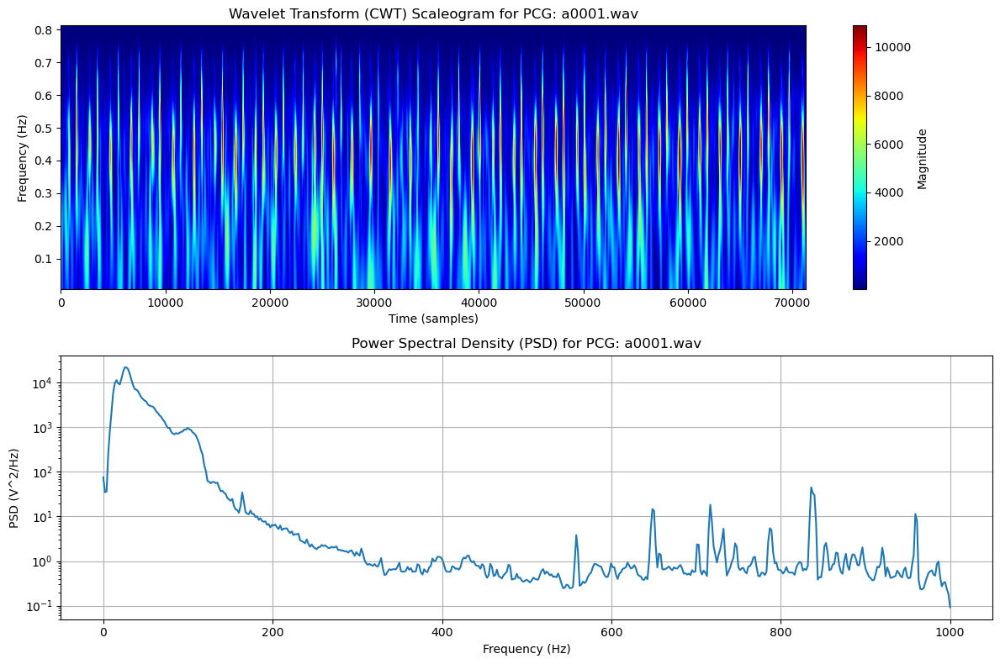

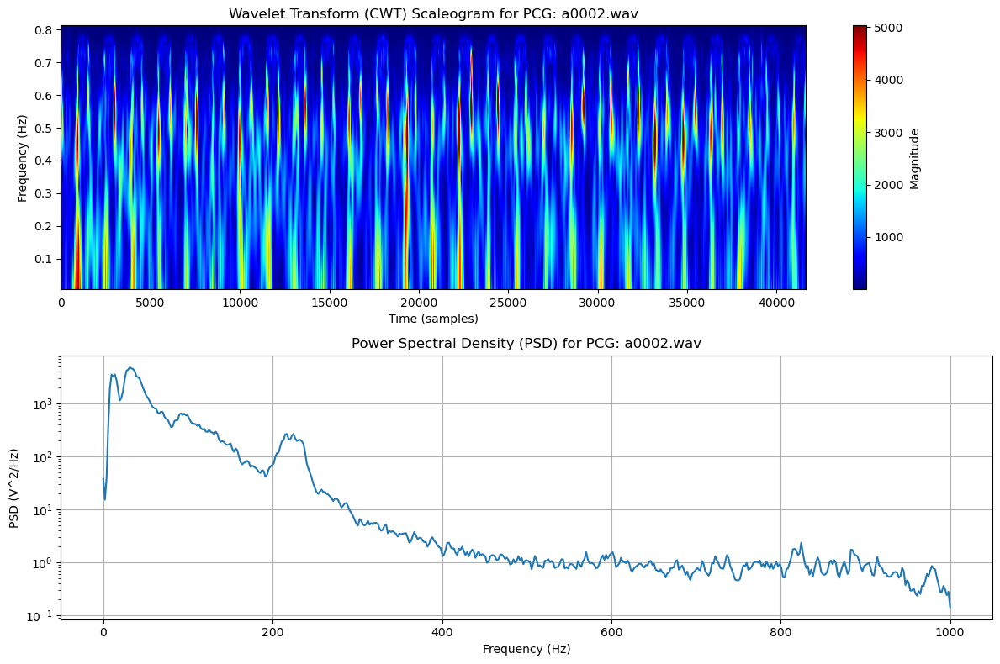

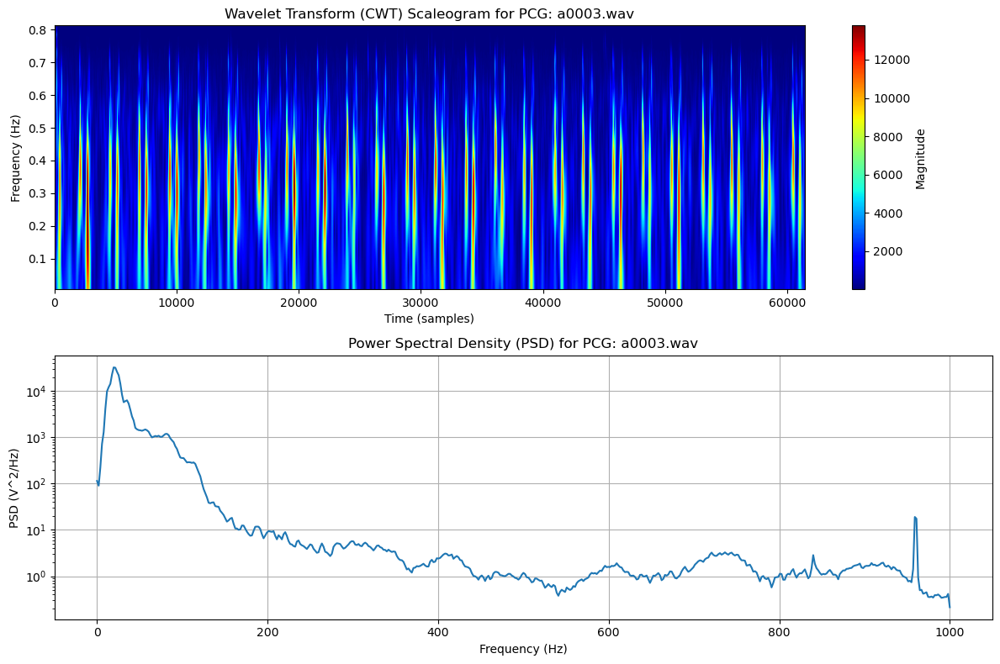

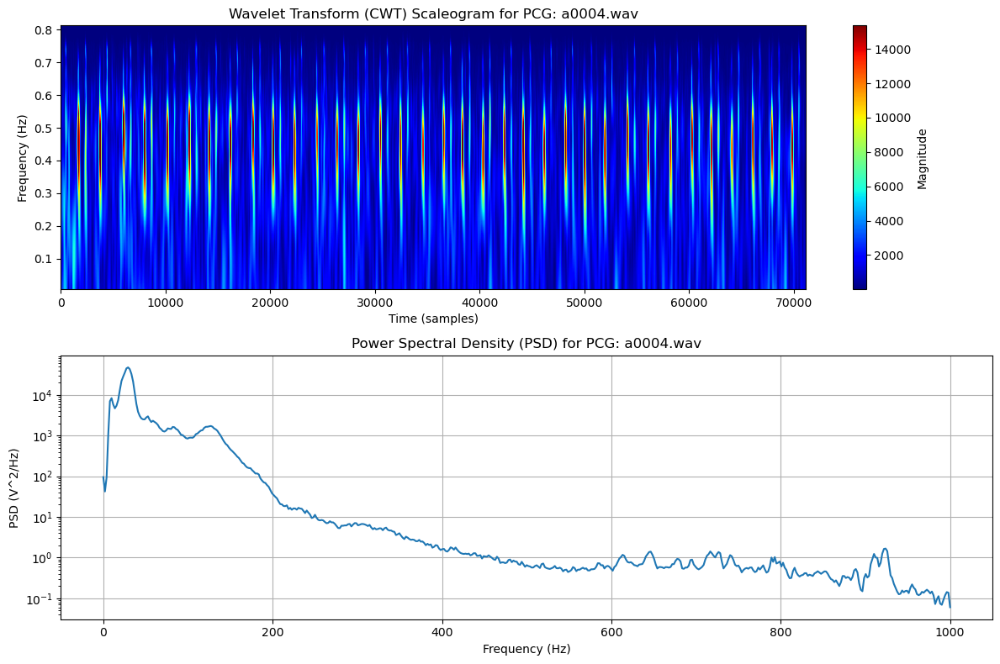

KeyboardInterrupt: 

In [5]:
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
from scipy.signal import welch
from scipy.io import wavfile

# Set folder path containing your PCG files
folder_path = "./bsp_dataset/Training-a"

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef, freqs

# Function to compute Power Spectral Density (PSD)
def compute_psd(signal, fs=5000):
    f, Pxx = welch(signal, fs, nperseg=1024)
    return f, Pxx

# Main function to process and visualize the PCG signal using CWT
def process_pcg_signal(record_name, folder_path):
    # Step 1: Load PCG record from .wav file
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    
    # If the signal is stereo, take only the first channel
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]

    # Step 2: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 128)  # Scale range for CWT
    coef, freqs = compute_cwt(pcg_signal, scales=scales)

    # Step 3: Compute Power Spectral Density (PSD) for PCG signal
    f, Pxx = compute_psd(pcg_signal, fs=fs)

    # Plot results
    plt.figure(figsize=(12, 8))

    # Plot Continuous Wavelet Transform (CWT) scaleogram (time-frequency)
    plt.subplot(2, 1, 1)
    plt.imshow(np.abs(coef), extent=[0, len(pcg_signal), freqs.min(), freqs.max()],
               cmap='jet', aspect='auto', vmax=np.percentile(np.abs(coef), 99), vmin=np.percentile(np.abs(coef), 1))
    plt.colorbar(label='Magnitude')
    plt.title(f'Wavelet Transform (CWT) Scaleogram for PCG: {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Frequency (Hz)')

    # Plot Power Spectral Density (PSD) of the PCG signal
    plt.subplot(2, 1, 2)
    plt.semilogy(f, Pxx)
    plt.title(f'Power Spectral Density (PSD) for PCG: {record_name}')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('PSD (V^2/Hz)')
    plt.grid()

    plt.tight_layout()
    plt.show()

# Loop through the samples and process each PCG record
for sample in samples:
    process_pcg_signal(sample, folder_path)


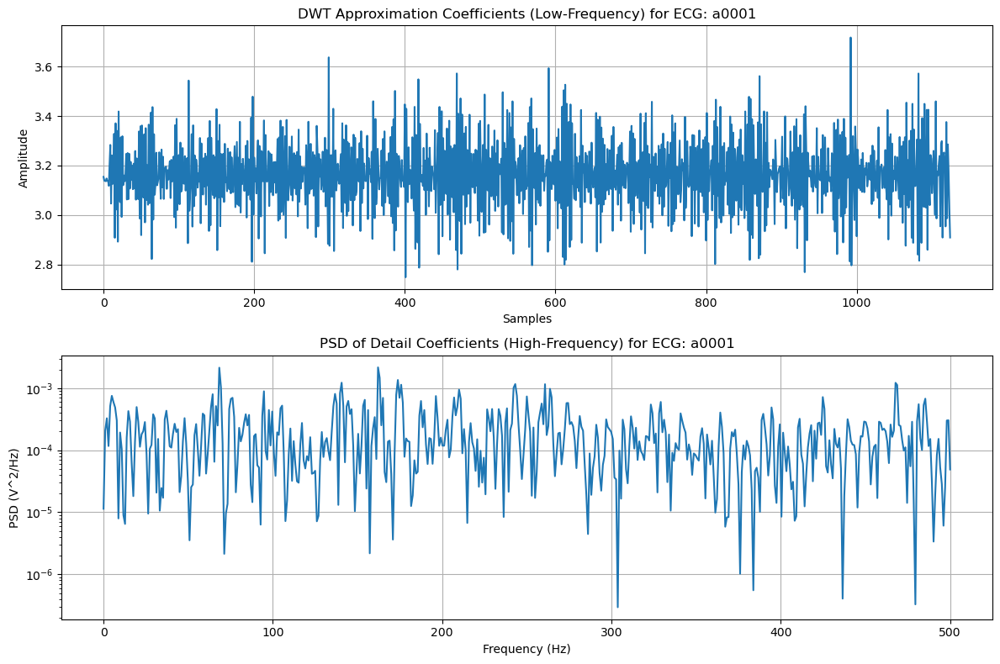

C:\Users\Harshith\anaconda3\Lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 1024 is greater than input length  = 661, using nperseg = 661
  warnings.warn('nperseg = {0:d} is greater than input length '


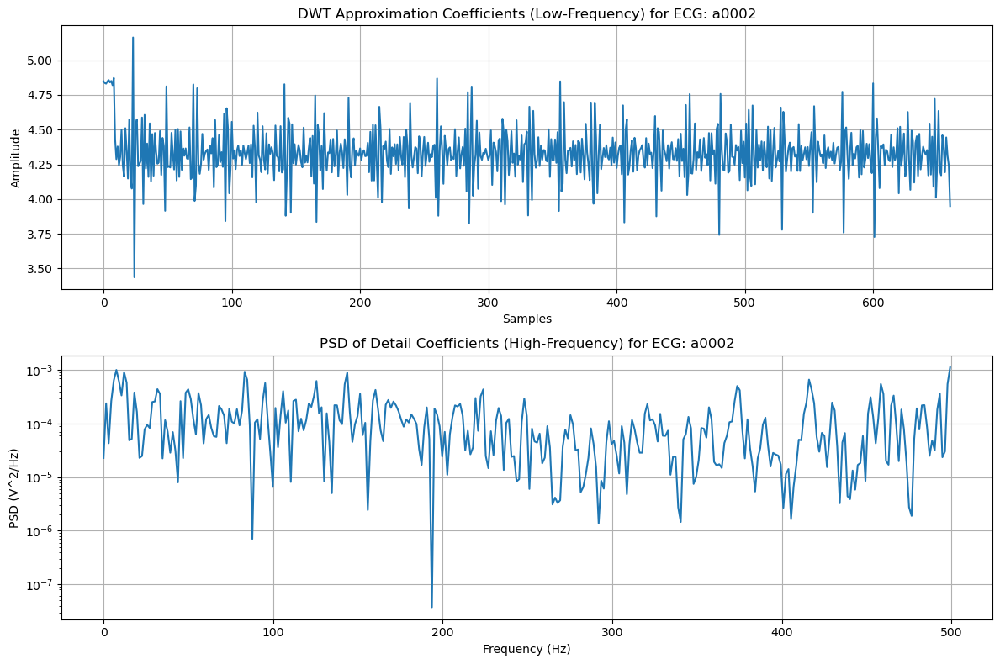

C:\Users\Harshith\anaconda3\Lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 1024 is greater than input length  = 970, using nperseg = 970
  warnings.warn('nperseg = {0:d} is greater than input length '


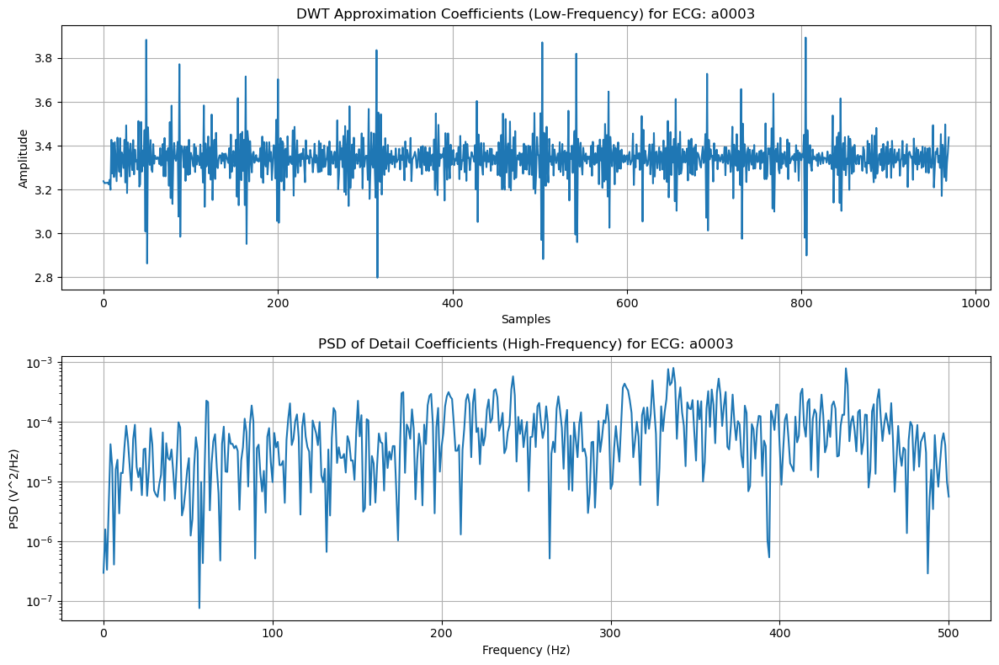

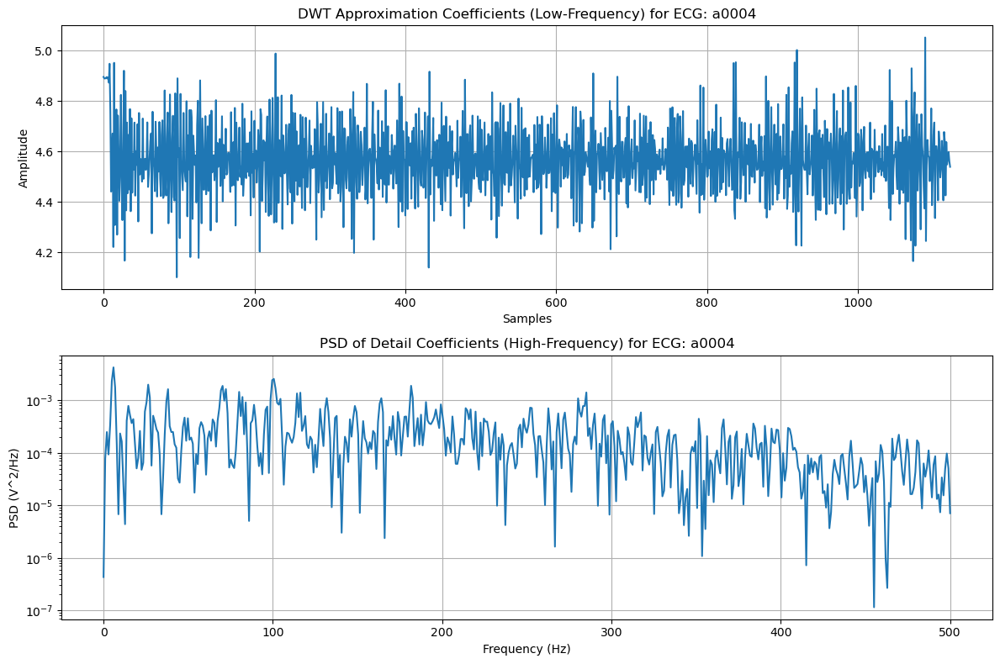

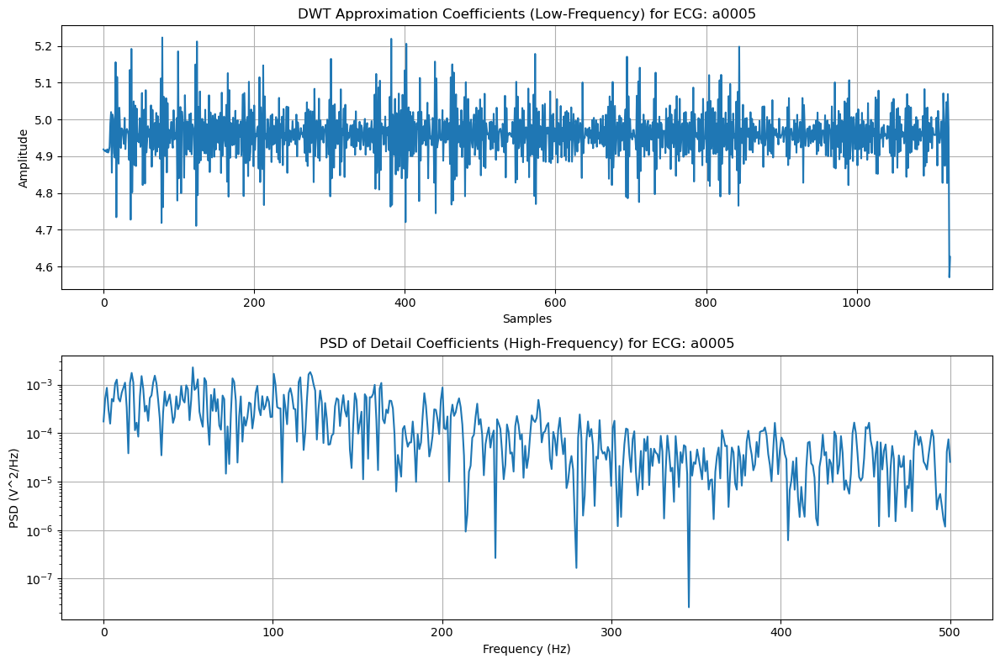

C:\Users\Harshith\anaconda3\Lib\site-packages\scipy\signal\_spectral_py.py:2014: UserWarning: nperseg = 1024 is greater than input length  = 659, using nperseg = 659
  warnings.warn('nperseg = {0:d} is greater than input length '


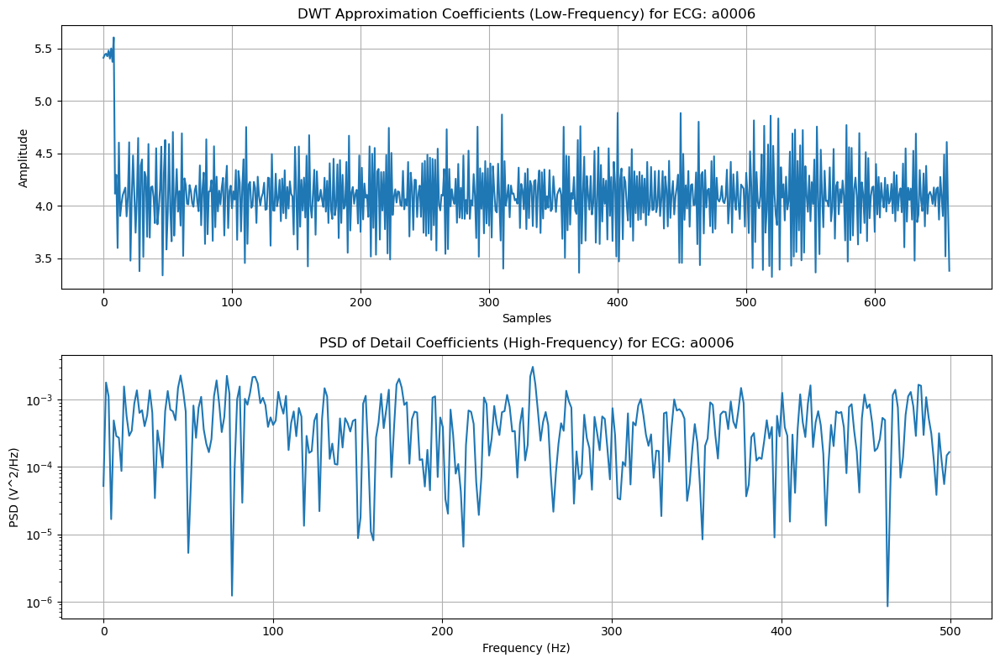

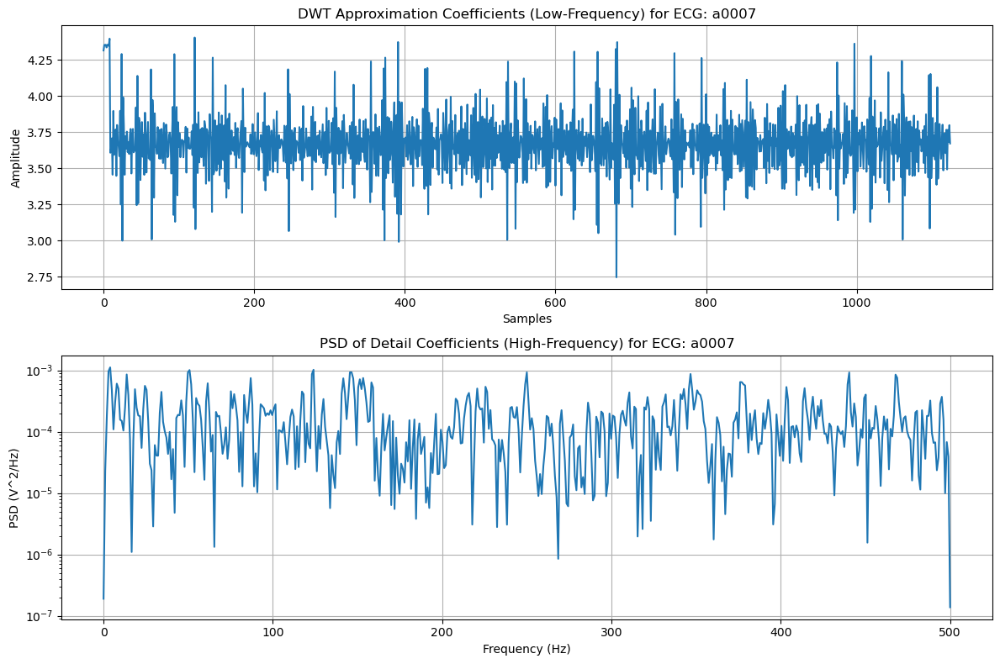

KeyboardInterrupt: 

In [1]:
import wfdb
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
from scipy.signal import welch

# Set folder path containing your ECG files
folder_path = "./bsp_dataset/Training-a"

# List all ECG data samples (assuming they are in .dat format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.dat')]

# Function to normalize the ECG signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    normalized_signal = (signal - min_val) / (max_val - min_val)
    return normalized_signal

# Function to compute Discrete Wavelet Transform (DWT)
def compute_dwt(signal, wavelet='db6', level=6):
    coeffs = pywt.wavedec(signal, wavelet, level=level)
    return coeffs

# Function to compute Power Spectral Density (PSD) from the wavelet detail coefficients
def compute_psd_from_wavelet(detail_coeffs, fs=1000):
    f, Pxx = welch(detail_coeffs, fs, nperseg=1024)
    return f, Pxx

# Main function to process and visualize the ECG signal using DWT
def process_ecg_signal(record_name, folder_path):
    # Step 1: Load ECG record from .dat file using wfdb
    record = wfdb.rdrecord(os.path.join(folder_path, record_name))
    ecg_signal = record.p_signal[:, 0]  # Assuming the first channel is ECG
    
    # Step 2: Normalize the ECG signal
    normalized_ecg_signal = normalize_signal(ecg_signal)

    # Step 3: Compute Discrete Wavelet Transform (DWT)
    coeffs = compute_dwt(normalized_ecg_signal)
    
    # Step 4: Extract approximation and detail coefficients
    approximation = coeffs[0]  # Approximation coefficients (low-frequency trends)
    detail = coeffs[1]         # Detail coefficients (high-frequency details)

    # Step 5: Compute Power Spectral Density (PSD) from the detail coefficients
    f, Pxx = compute_psd_from_wavelet(detail)

    # Plot results
    plt.figure(figsize=(12, 8))

    # Plot the approximation coefficients (low-frequency P-QRS-T complex)
    plt.subplot(2, 1, 1)
    plt.plot(approximation)
    plt.title(f'DWT Approximation Coefficients (Low-Frequency) for ECG: {record_name}')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid()

    # Plot the Power Spectral Density (PSD) of the detail coefficients
    plt.subplot(2, 1, 2)
    plt.semilogy(f, Pxx)
    plt.title(f'PSD of Detail Coefficients (High-Frequency) for ECG: {record_name}')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('PSD (V^2/Hz)')
    plt.grid()

    plt.tight_layout()
    plt.show()

# Loop through the samples and process each ECG record
for sample in samples:
    record_name = sample.replace('.dat', '')
    process_ecg_signal(record_name, folder_path)


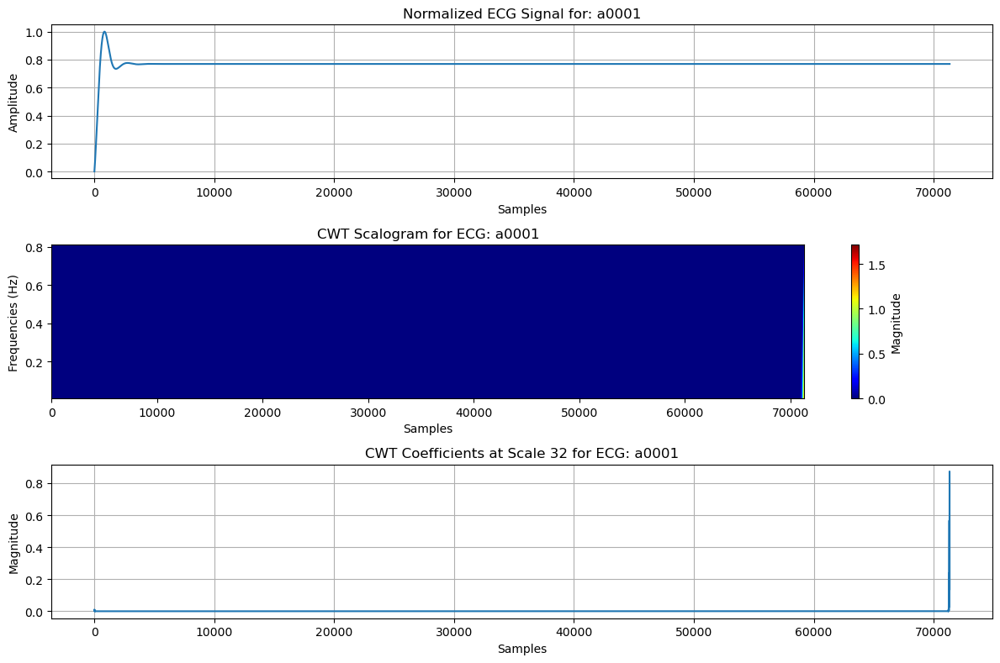

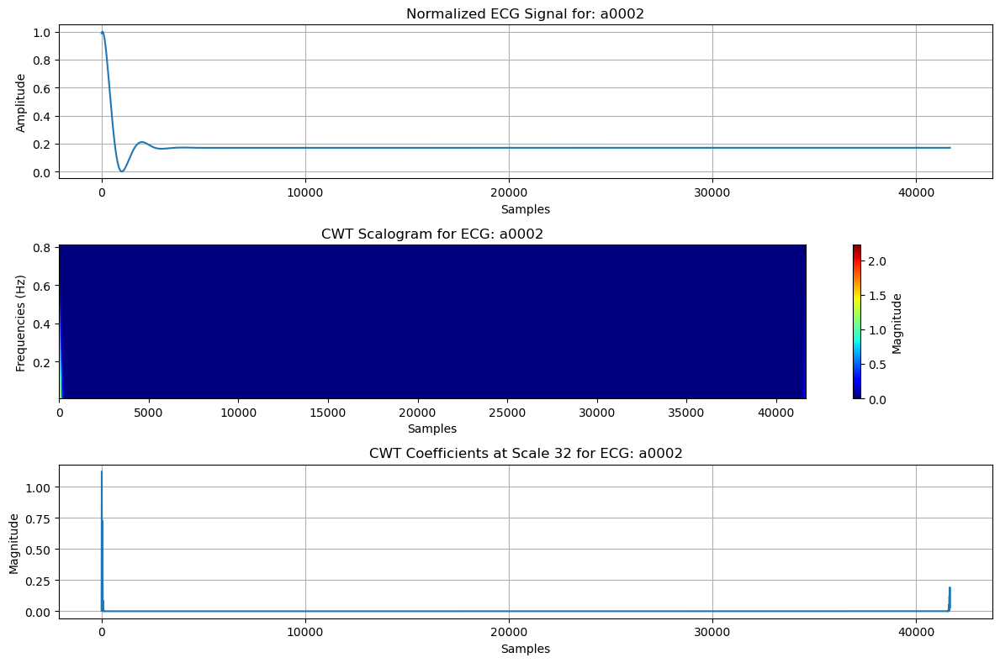

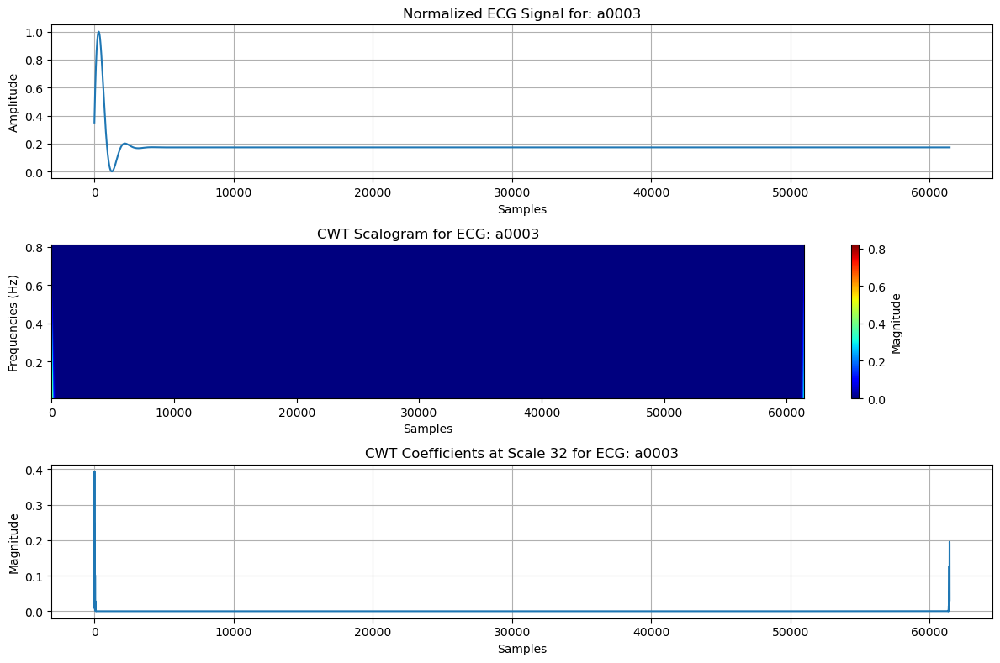

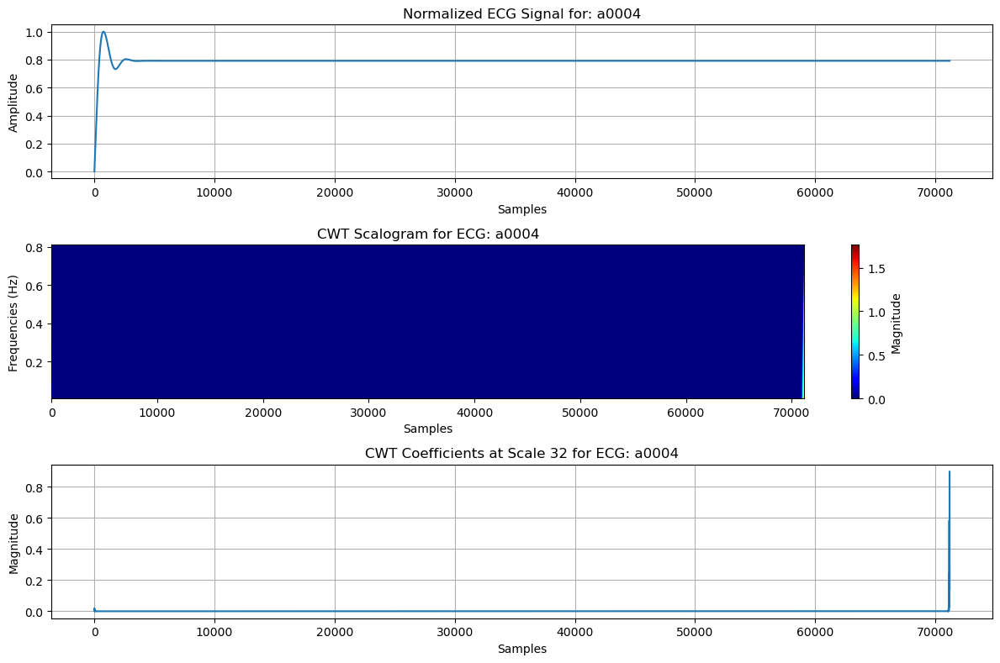

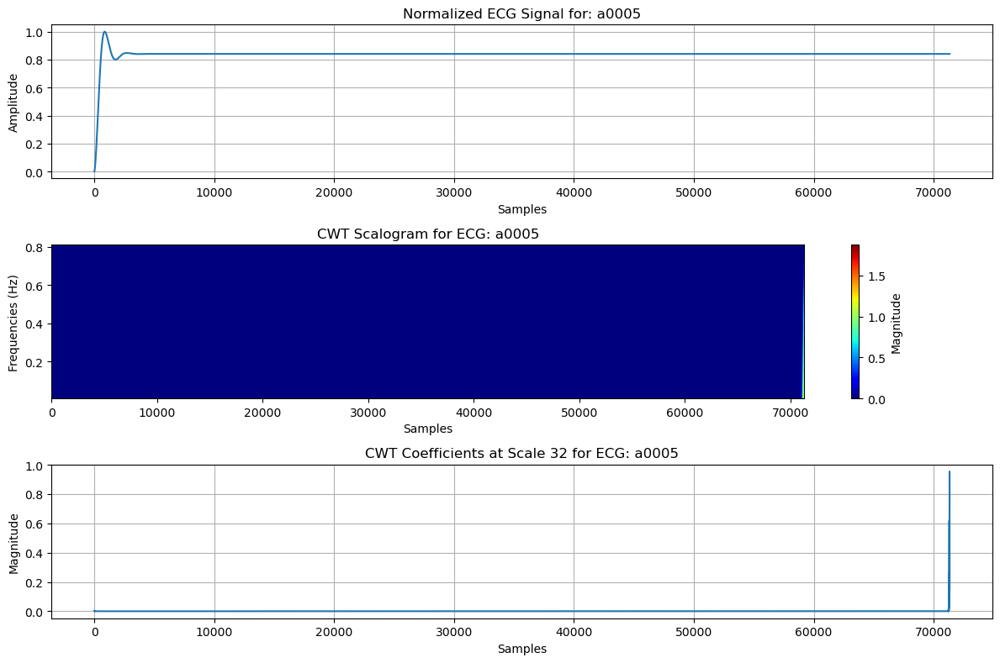

...

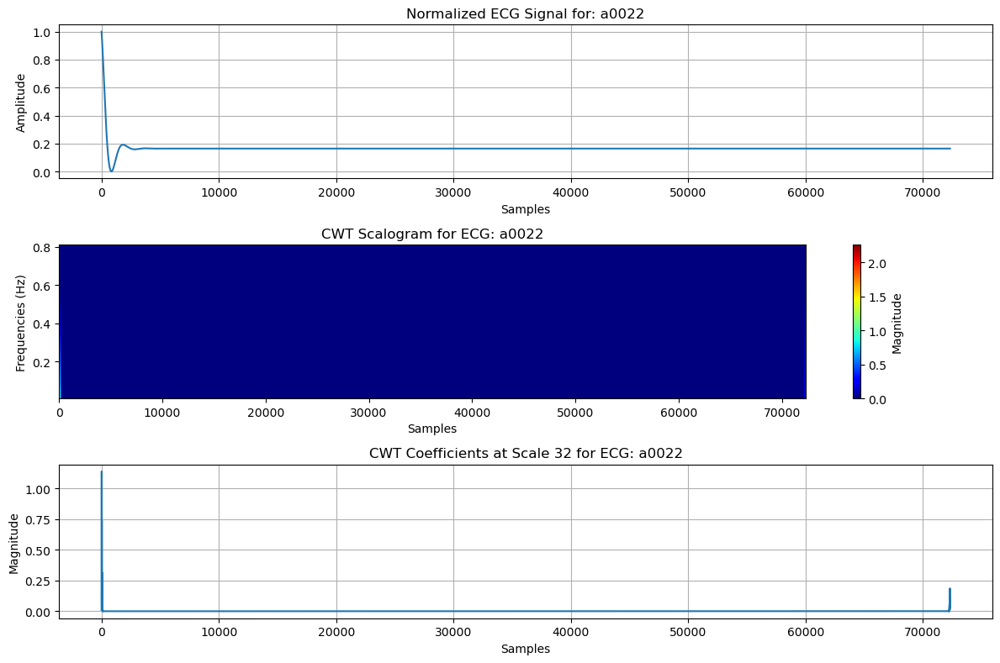

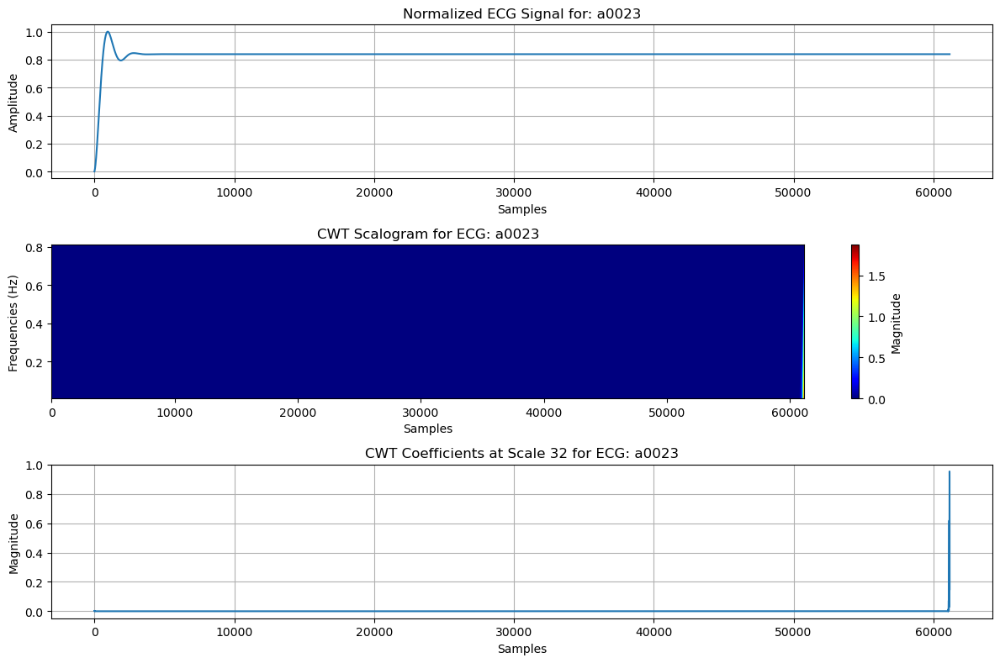

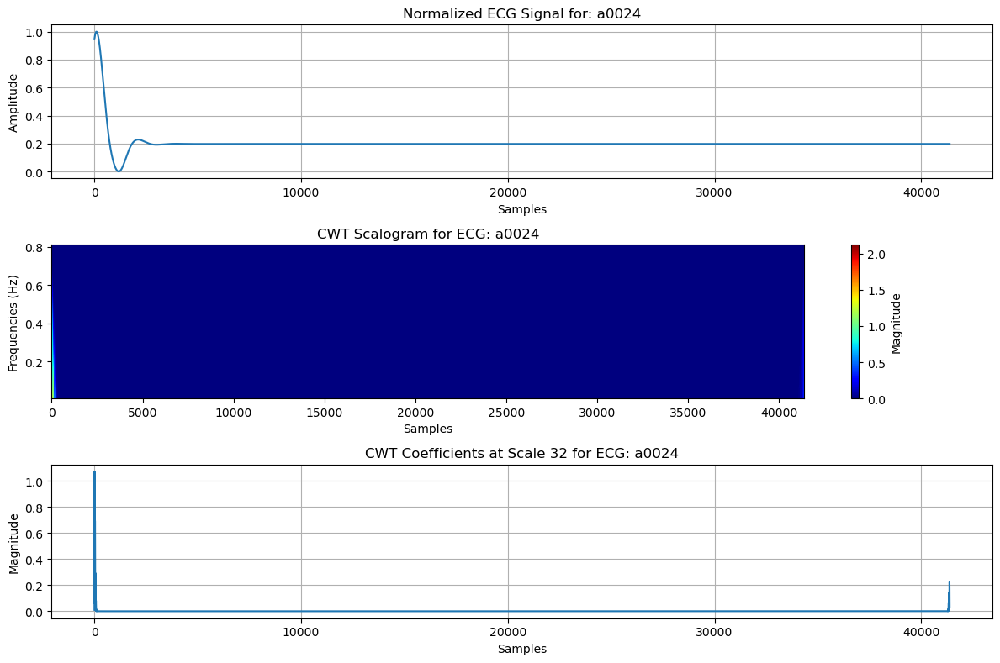

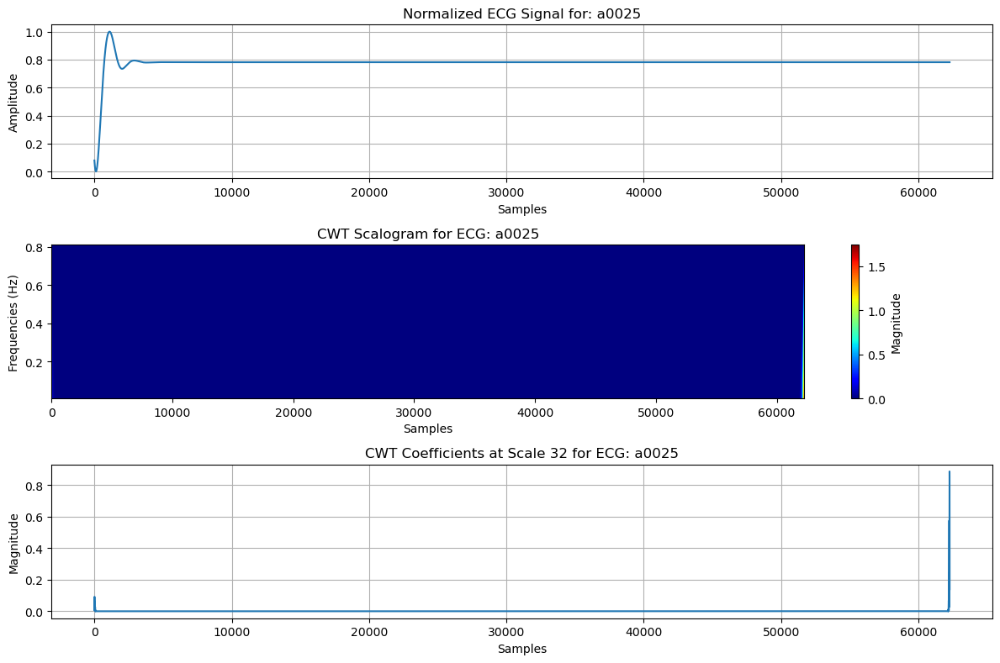

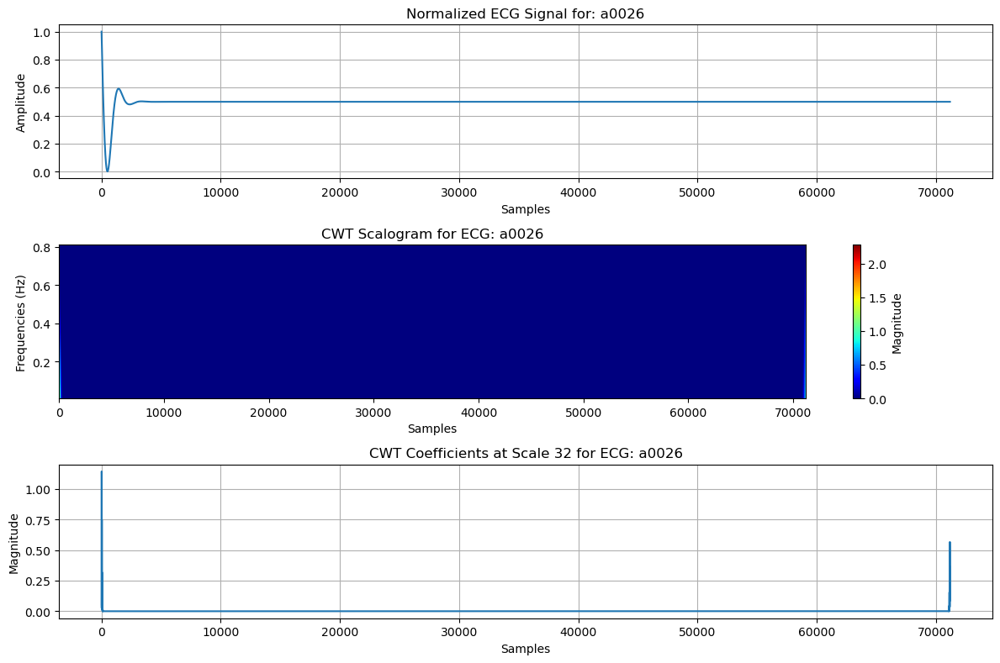

KeyboardInterrupt: 

In [1]:
import wfdb
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
from scipy.signal import butter, filtfilt

# Set folder path containing your ECG files
folder_path = "./bsp_dataset/Training-a"

# List all ECG data samples (assuming they are in .dat format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.dat')]

# Function to normalize the ECG signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    normalized_signal = (signal - min_val) / (max_val - min_val)
    return normalized_signal

# Function to apply bandpass filter to the ECG signal
def bandpass_filter(signal, lowcut=0.5, highcut=40.0, fs=1000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef, freqs

# Main function to process and visualize the ECG signal using CWT
def process_ecg_signal(record_name, folder_path):
    # Step 1: Load ECG record from .dat file using wfdb
    record = wfdb.rdrecord(os.path.join(folder_path, record_name))
    ecg_signal = record.p_signal[:, 0]  # Assuming the first channel is ECG

    # Step 2: Filter the ECG signal
    filtered_ecg_signal = bandpass_filter(ecg_signal)

    # Step 3: Normalize the ECG signal
    normalized_ecg_signal = normalize_signal(filtered_ecg_signal)

    # Step 4: Compute Continuous Wavelet Transform (CWT)
    cwt_coefficients, freqs = compute_cwt(normalized_ecg_signal)

    # Plot results
    plt.figure(figsize=(12, 8))

    # Plot the normalized ECG signal
    plt.subplot(3, 1, 1)
    plt.plot(normalized_ecg_signal)
    plt.title(f'Normalized ECG Signal for: {record_name}')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.grid()

    # Plot the CWT scalogram (time-frequency representation)
    plt.subplot(3, 1, 2)
    plt.imshow(np.abs(cwt_coefficients), aspect='auto', cmap='jet', extent=[0, len(ecg_signal), freqs[-1], freqs[0]])
    plt.title(f'CWT Scalogram for ECG: {record_name}')
    plt.xlabel('Samples')
    plt.ylabel('Frequencies (Hz)')
    plt.colorbar(label='Magnitude')

    # Plot a specific scale (e.g., 32nd scale for frequency analysis)
    plt.subplot(3, 1, 3)
    plt.plot(np.abs(cwt_coefficients[32, :]))
    plt.title(f'CWT Coefficients at Scale 32 for ECG: {record_name}')
    plt.xlabel('Samples')
    plt.ylabel('Magnitude')
    plt.grid()

    plt.tight_layout()
    plt.show()

# Loop through the samples and process each ECG record
for sample in samples:
    record_name = sample.replace('.dat', '')
    process_ecg_signal(record_name, folder_path)


In [ ]:
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
from scipy.io import wavfile
from scipy.signal import butter, filtfilt

# Set folder path containing your PCG files
folder_path = "./bsp_dataset/Training-a"

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Function to apply bandpass filter to the PCG signal (similar to ECG filtering)
def bandpass_filter(signal, lowcut=20.0, highcut=500.0, fs=5000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function to normalize the PCG signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    normalized_signal = (signal - min_val) / (max_val - min_val)
    return normalized_signal

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef, freqs

# Main function to process and visualize the PCG signal using CWT
def process_pcg_signal(record_name, folder_path):
    # Step 1: Load PCG record from .wav file
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    
    # If the signal is stereo, take only the first channel
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]

    # Step 2: Filter the PCG signal
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)

    # Step 3: Normalize the PCG signal
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)

    # Step 4: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 128)  # Scale range for CWT
    coef, freqs = compute_cwt(normalized_pcg_signal, scales=scales)

    # Plot results
    plt.figure(figsize=(12, 10))

    # Plot the normalized PCG signal (time-domain)
    plt.subplot(2, 1, 1)
    plt.plot(normalized_pcg_signal)
    plt.title(f'Normalized PCG Signal for: {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Amplitude')
    plt.grid()

    # Plot Continuous Wavelet Transform (CWT) scaleogram (time-frequency)
    plt.subplot(2, 1, 2)
    plt.imshow(np.abs(coef), extent=[0, len(normalized_pcg_signal), freqs.min(), freqs.max()],
               cmap='jet', aspect='auto', vmax=np.percentile(np.abs(coef), 99), vmin=np.percentile(np.abs(coef), 1))
    plt.colorbar(label='Magnitude')
    plt.title(f'Wavelet Transform (CWT) Scaleogram for PCG: {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Frequency (Hz)')



# Loop through the samples and process each PCG record
for sample in samples:
    process_pcg_signal(sample, folder_path)


C:\Users\Harshith\AppData\Local\Temp\ipykernel_15400\3917897170.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 10))


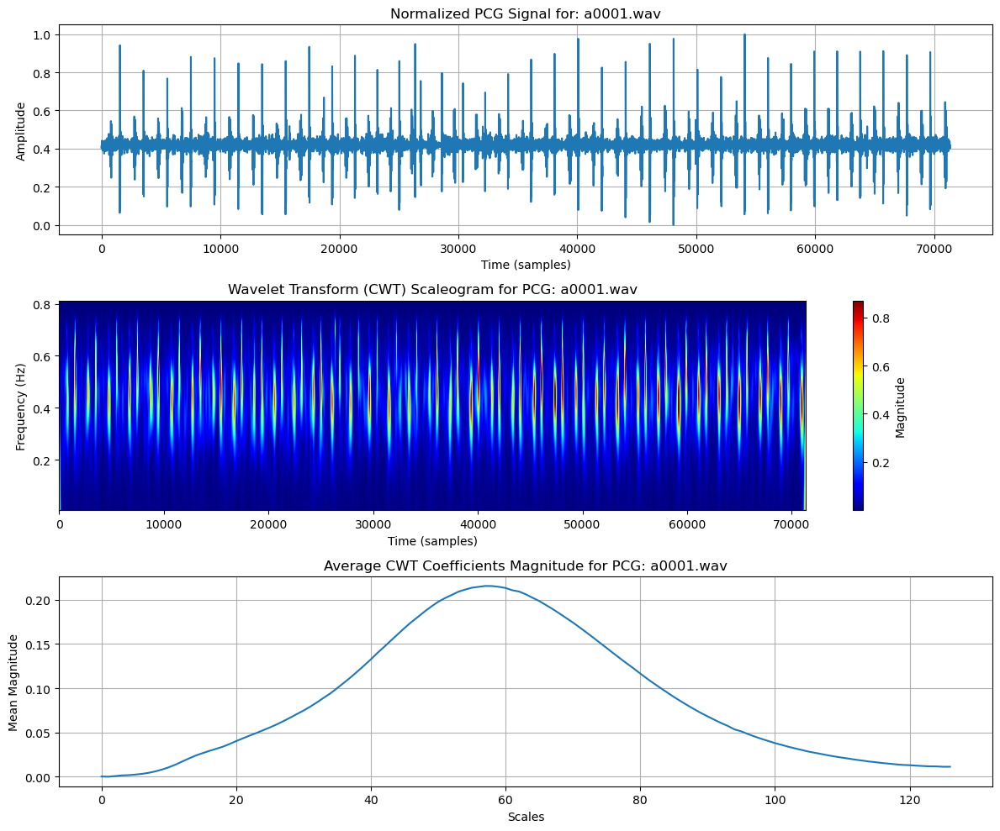

CWT coefficients for a0001.wav: [[-0.00079547 -0.05103351 -0.00092148 ...  0.0010434  -0.00203714
  -0.05199524]
 [ 0.0006652   0.07331023 -0.07291496 ...  0.03004516 -0.07293147
   0.07391159]
 [ 0.00235776  0.14240247 -0.01118114 ... -0.08953289 -0.00842231
   0.14388672]
 ...
 [ 0.00942465  0.08304583  0.08433851 ...  0.13181824  0.05920531
   0.05914509]
 [ 0.0087865   0.08230145  0.08290209 ...  0.13160282  0.05884591
   0.05887891]
 [ 0.00718193  0.08076068  0.0813637  ...  0.1321802   0.05927241
   0.05969382]]


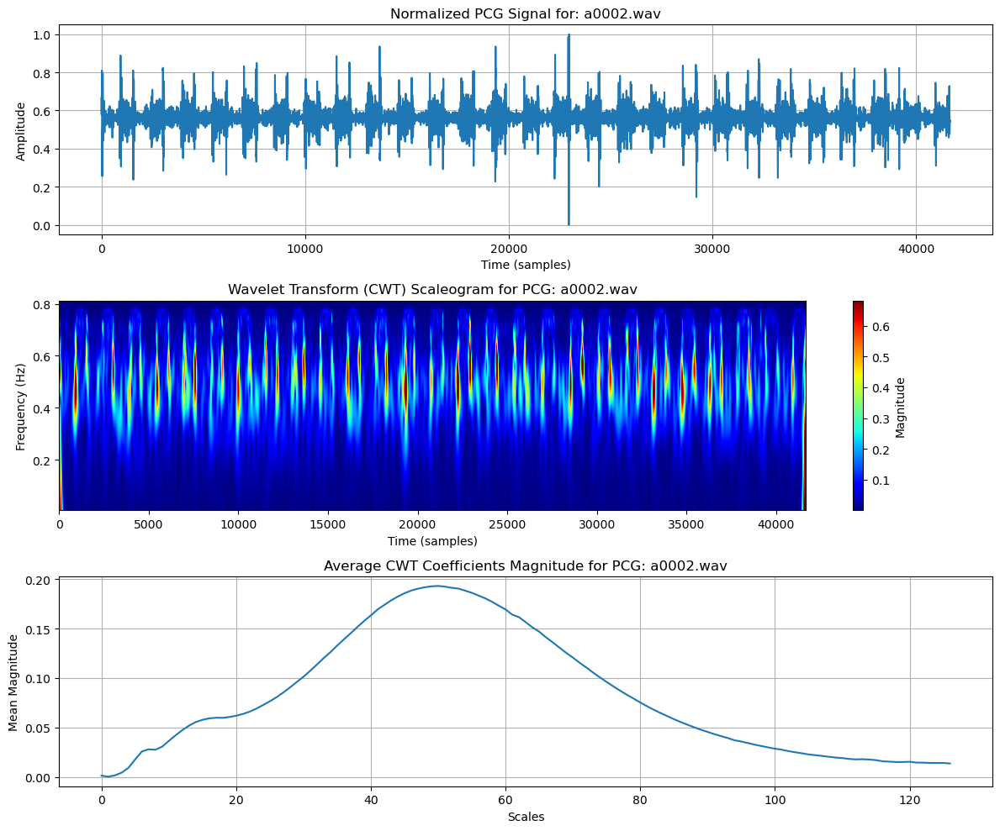

CWT coefficients for a0002.wav: [[ 0.00734313 -0.06749359 -0.01064036 ...  0.00037387 -0.00300614
  -0.0666535 ]
 [-0.00471752  0.09780279 -0.09304586 ...  0.03864779 -0.09416342
   0.0957019 ]
 [-0.01768527  0.18239003  0.00237583 ... -0.11459283 -0.01055589
   0.18495919]
 ...
 [ 0.12711079  0.23004957  0.23561727 ...  0.22241086  0.12544502
   0.12304414]
 [ 0.11365589  0.21788385  0.22497618 ...  0.23002617  0.13262565
   0.12877114]
 [ 0.11793568  0.22192904  0.22797523 ...  0.22650297  0.12743019
   0.12287785]]


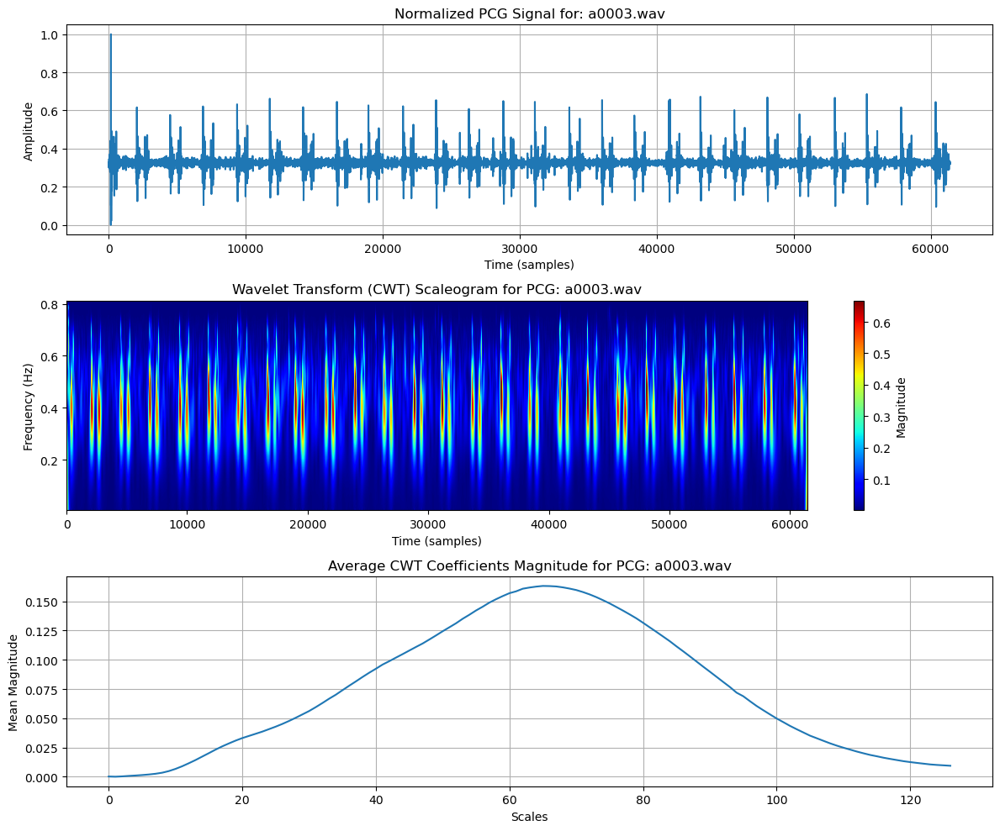

CWT coefficients for a0003.wav: [[-0.00138005 -0.04081373 -0.00017669 ...  0.00060834 -0.00140555
  -0.04032956]
 [ 0.00109367  0.05849232 -0.05871802 ...  0.02341839 -0.05705128
   0.05777478]
 [ 0.00376087  0.11347144 -0.01102672 ... -0.06987515 -0.00729836
   0.11206952]
 ...
 [-0.02133723  0.03346101  0.02939181 ...  0.10618372  0.04952457
   0.04977923]
 [-0.02371854  0.03236421  0.03088381 ...  0.10658386  0.05000096
   0.05052401]
 [-0.02000226  0.03620075  0.03387264 ...  0.10717874  0.05025079
   0.05064673]]


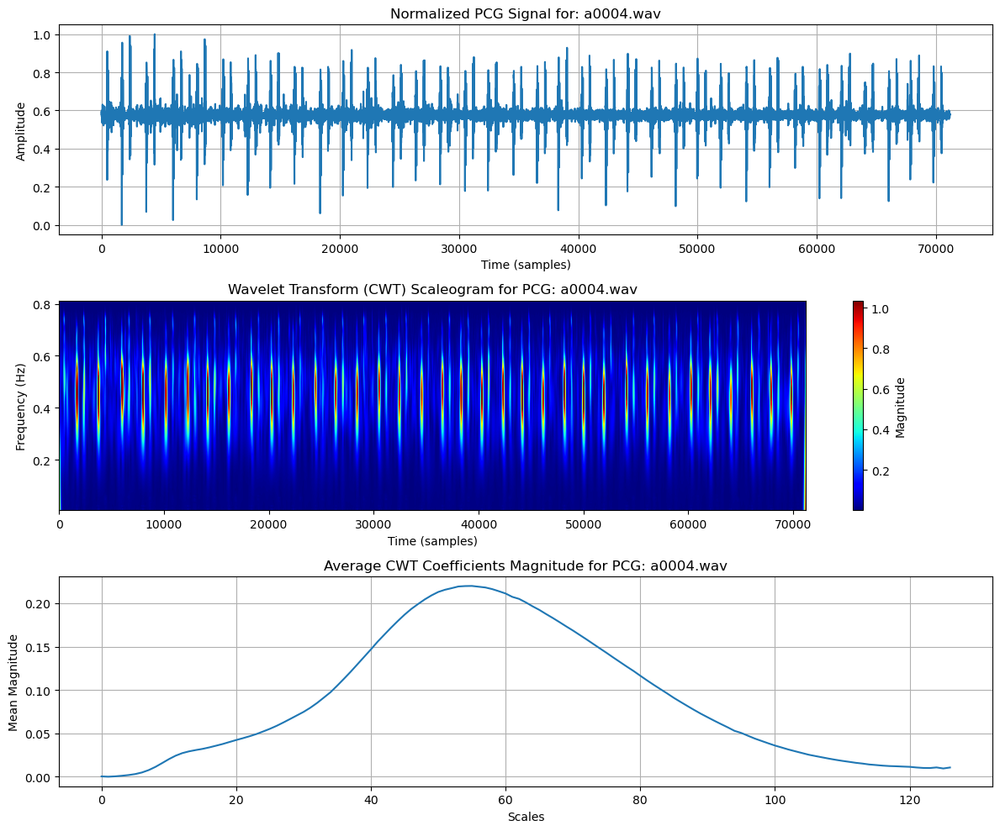

CWT coefficients for a0004.wav: [[ 0.00222217 -0.0699201  -0.00543061 ...  0.00092327 -0.00267919
  -0.07115521]
 [-0.00194832  0.09969293 -0.09644529 ...  0.04130553 -0.10064242
   0.10205043]
 [-0.00698551  0.19337705 -0.00441971 ... -0.12304629 -0.01233089
   0.19774253]
 ...
 [ 0.02446902  0.12766849  0.13165188 ...  0.19982311  0.09987216
   0.10023187]
 [ 0.02424407  0.12692158  0.13035295 ...  0.19959305  0.0988946
   0.09894795]
 [ 0.0264149   0.12904778  0.13198464 ...  0.20050555  0.09977077
   0.10016346]]


KeyboardInterrupt: 

In [1]:
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
from scipy.io import wavfile
from scipy.signal import butter, filtfilt

# Set folder path containing your PCG files
folder_path = "./bsp_dataset/Training-a"

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Function to apply bandpass filter to the PCG signal
def bandpass_filter(signal, lowcut=20.0, highcut=500.0, fs=5000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function to normalize the PCG signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    normalized_signal = (signal - min_val) / (max_val - min_val)
    return normalized_signal

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef, freqs

# Main function to process and return CWT coefficients for PCG signal
def process_pcg_signal(record_name, folder_path):
    # Step 1: Load PCG record from .wav file
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    
    # If the signal is stereo, take only the first channel
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]

    # Step 2: Filter the PCG signal
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)

    # Step 3: Normalize the PCG signal
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)

    # Step 4: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 128)  # Scale range for CWT
    coef, freqs = compute_cwt(normalized_pcg_signal, scales=scales)

    # Plot results
    plt.figure(figsize=(12, 10))

    # Plot the normalized PCG signal (time-domain)
    plt.subplot(3, 1, 1)
    plt.plot(normalized_pcg_signal)
    plt.title(f'Normalized PCG Signal for: {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Amplitude')
    plt.grid()

    # Plot Continuous Wavelet Transform (CWT) scaleogram (time-frequency)
    plt.subplot(3, 1, 2)
    plt.imshow(np.abs(coef), extent=[0, len(normalized_pcg_signal), freqs.min(), freqs.max()],
               cmap='jet', aspect='auto', vmax=np.percentile(np.abs(coef), 99), vmin=np.percentile(np.abs(coef), 1))
    plt.colorbar(label='Magnitude')
    plt.title(f'Wavelet Transform (CWT) Scaleogram for PCG: {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Frequency (Hz)')

    # Plot CWT Coefficient Magnitude (2D color plot)
    plt.subplot(3, 1, 3)
    plt.plot(np.mean(np.abs(coef), axis=1))  # Mean magnitude of coefficients across time
    plt.title(f'Average CWT Coefficients Magnitude for PCG: {record_name}')
    plt.xlabel('Scales')
    plt.ylabel('Mean Magnitude')
    plt.grid()

    plt.tight_layout()
    plt.show()

    # Return the computed CWT coefficients and frequencies
    return coef, freqs

# Loop through the samples and process each PCG record
for sample in samples:
    coef, freqs = process_pcg_signal(sample, folder_path)
    print(f'CWT coefficients for {sample}:', coef)


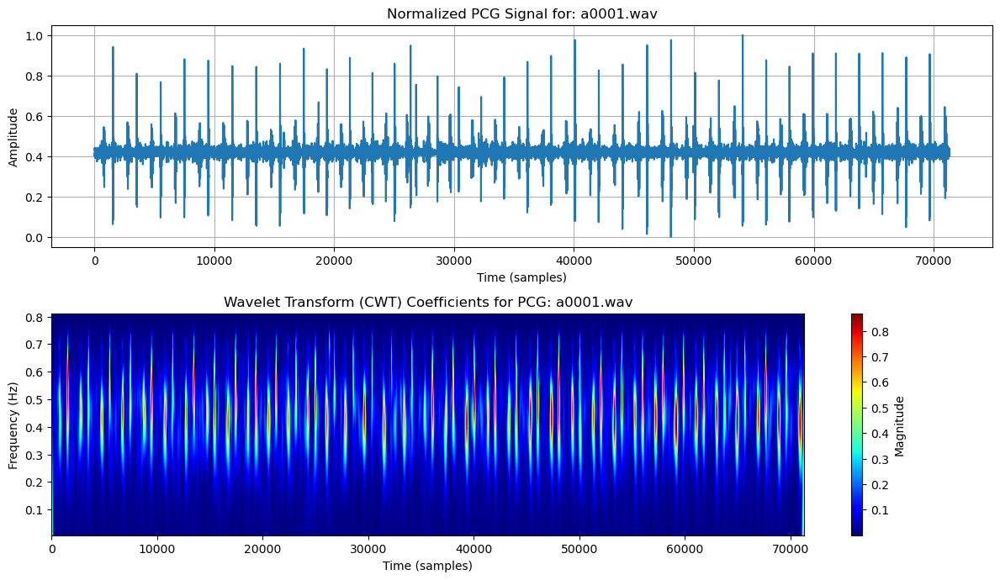

CWT coefficients for a0001.wav: [[-0.00079547 -0.05103351 -0.00092148 ...  0.0010434  -0.00203714
  -0.05199524]
 [ 0.0006652   0.07331023 -0.07291496 ...  0.03004516 -0.07293147
   0.07391159]
 [ 0.00235776  0.14240247 -0.01118114 ... -0.08953289 -0.00842231
   0.14388672]
 ...
 [ 0.00942465  0.08304583  0.08433851 ...  0.13181824  0.05920531
   0.05914509]
 [ 0.0087865   0.08230145  0.08290209 ...  0.13160282  0.05884591
   0.05887891]
 [ 0.00718193  0.08076068  0.0813637  ...  0.1321802   0.05927241
   0.05969382]]


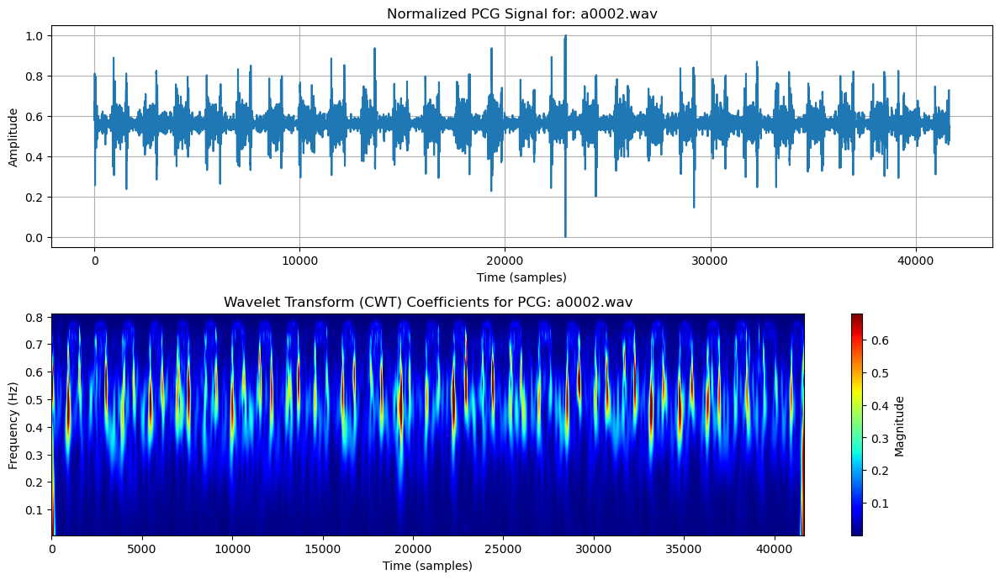

CWT coefficients for a0002.wav: [[ 0.00734313 -0.06749359 -0.01064036 ...  0.00037387 -0.00300614
  -0.0666535 ]
 [-0.00471752  0.09780279 -0.09304586 ...  0.03864779 -0.09416342
   0.0957019 ]
 [-0.01768527  0.18239003  0.00237583 ... -0.11459283 -0.01055589
   0.18495919]
 ...
 [ 0.12711079  0.23004957  0.23561727 ...  0.22241086  0.12544502
   0.12304414]
 [ 0.11365589  0.21788385  0.22497618 ...  0.23002617  0.13262565
   0.12877114]
 [ 0.11793568  0.22192904  0.22797523 ...  0.22650297  0.12743019
   0.12287785]]


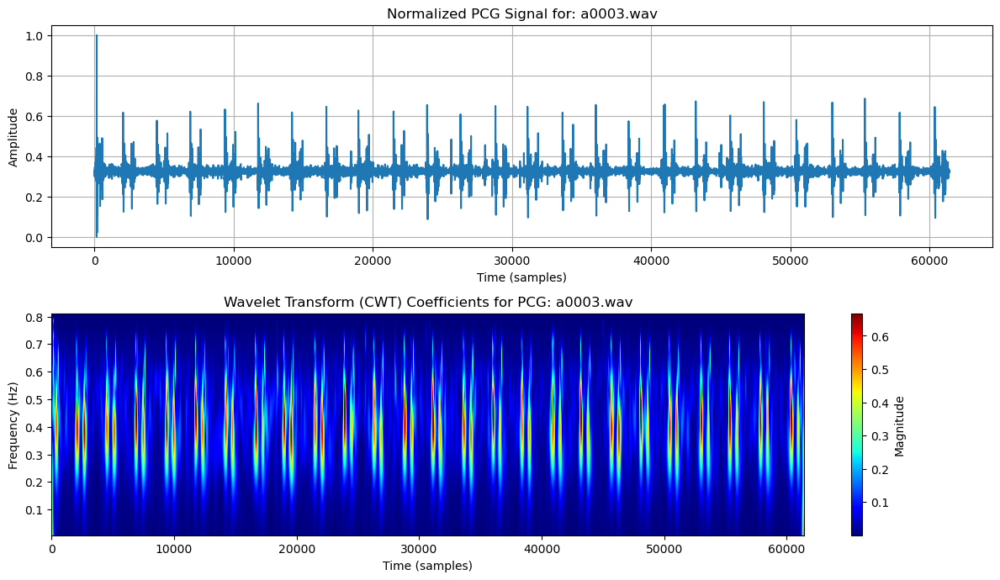

CWT coefficients for a0003.wav: [[-0.00138005 -0.04081373 -0.00017669 ...  0.00060834 -0.00140555
  -0.04032956]
 [ 0.00109367  0.05849232 -0.05871802 ...  0.02341839 -0.05705128
   0.05777478]
 [ 0.00376087  0.11347144 -0.01102672 ... -0.06987515 -0.00729836
   0.11206952]
 ...
 [-0.02133723  0.03346101  0.02939181 ...  0.10618372  0.04952457
   0.04977923]
 [-0.02371854  0.03236421  0.03088381 ...  0.10658386  0.05000096
   0.05052401]
 [-0.02000226  0.03620075  0.03387264 ...  0.10717874  0.05025079
   0.05064673]]


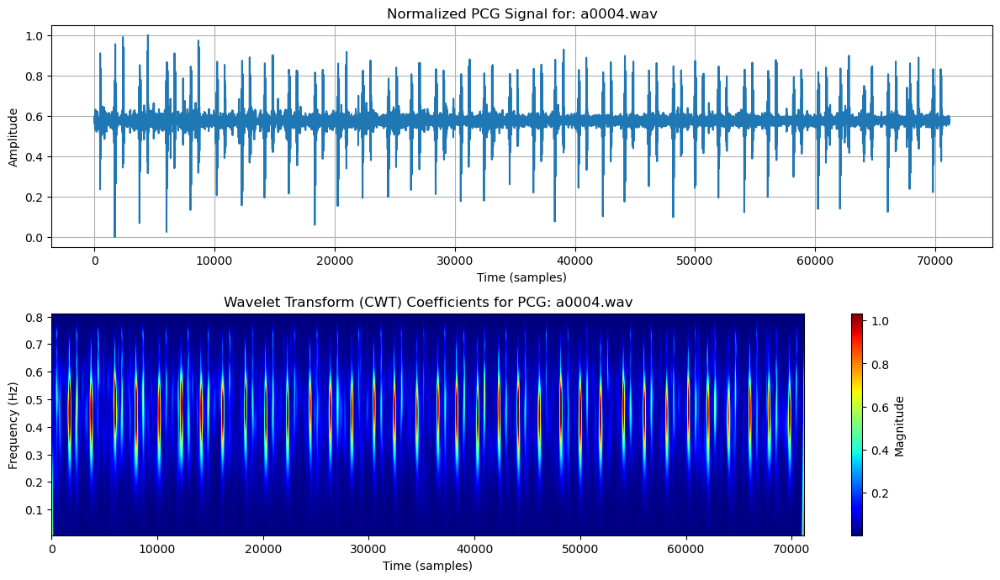

CWT coefficients for a0004.wav: [[ 0.00222217 -0.0699201  -0.00543061 ...  0.00092327 -0.00267919
  -0.07115521]
 [-0.00194832  0.09969293 -0.09644529 ...  0.04130553 -0.10064242
   0.10205043]
 [-0.00698551  0.19337705 -0.00441971 ... -0.12304629 -0.01233089
   0.19774253]
 ...
 [ 0.02446902  0.12766849  0.13165188 ...  0.19982311  0.09987216
   0.10023187]
 [ 0.02424407  0.12692158  0.13035295 ...  0.19959305  0.0988946
   0.09894795]
 [ 0.0264149   0.12904778  0.13198464 ...  0.20050555  0.09977077
   0.10016346]]


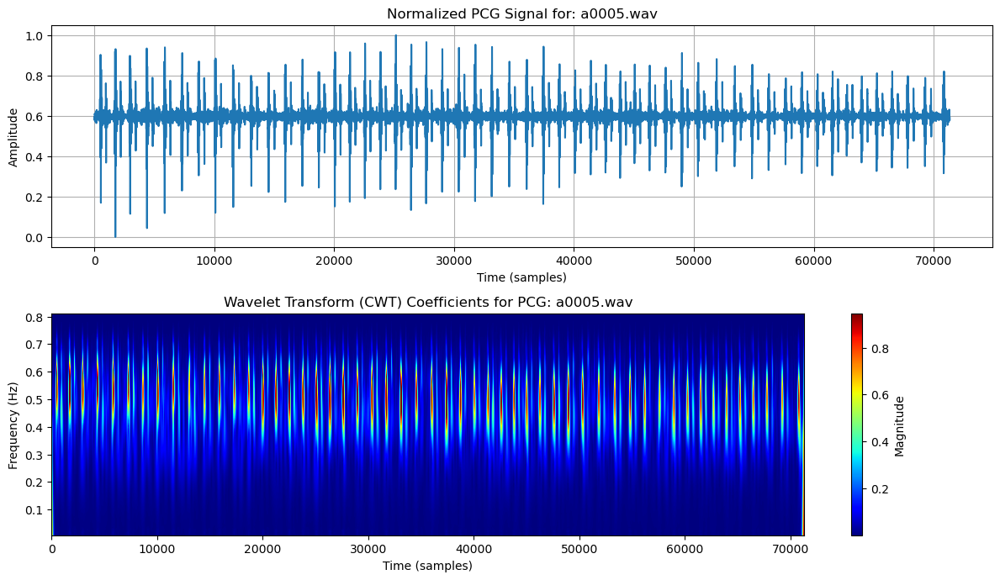

CWT coefficients for a0005.wav: [[-1.62319591e-04 -7.33755631e-02 -2.66477757e-03 ...  2.20635657e-03
  -1.32390533e-03 -7.35225919e-02]
 [ 1.06928015e-04  1.05139099e-01 -1.03788631e-01 ...  4.29571978e-02
  -1.04611115e-01  1.05395714e-01]
 [ 3.43187216e-04  2.03867790e-01 -1.30331987e-02 ... -1.28671251e-01
  -1.55989477e-02  2.05161358e-01]
 ...
 [-6.07053010e-03  9.81825344e-02  9.83883065e-02 ...  2.12690827e-01
   1.08790668e-01  1.09285850e-01]
 [-7.83492105e-03  9.69356872e-02  9.72591108e-02 ...  2.13762626e-01
   1.09418878e-01  1.09933626e-01]
 [-8.77742633e-03  9.61235120e-02  9.61725119e-02 ...  2.12935078e-01
   1.08372555e-01  1.09031090e-01]]


KeyboardInterrupt: 

In [2]:
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
from scipy.io import wavfile
from scipy.signal import butter, filtfilt

# Set folder path containing your PCG files
folder_path = "./bsp_dataset/Training-a"

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Function to apply bandpass filter to the PCG signal
def bandpass_filter(signal, lowcut=20.0, highcut=500.0, fs=5000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function to normalize the PCG signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    normalized_signal = (signal - min_val) / (max_val - min_val)
    return normalized_signal

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef, freqs

# Main function to process and return CWT coefficients for PCG signal
def process_pcg_signal(record_name, folder_path):
    # Step 1: Load PCG record from .wav file
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    
    # If the signal is stereo, take only the first channel
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]

    # Step 2: Filter the PCG signal
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)

    # Step 3: Normalize the PCG signal
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)

    # Step 4: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 128)  # Scale range for CWT
    coef, freqs = compute_cwt(normalized_pcg_signal, scales=scales)

    # Plot results
    plt.figure(figsize=(12, 10))

    # Plot the normalized PCG signal (time-domain)
    plt.subplot(3, 1, 1)
    plt.plot(normalized_pcg_signal)
    plt.title(f'Normalized PCG Signal for: {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Amplitude')
    plt.grid()

    # Plot Continuous Wavelet Transform (CWT) scaleogram (time-frequency)
    plt.subplot(3, 1, 2)
    plt.imshow(np.abs(coef), extent=[0, len(normalized_pcg_signal), freqs.min(), freqs.max()],
               cmap='jet', aspect='auto', vmax=np.percentile(np.abs(coef), 99), vmin=np.percentile(np.abs(coef), 1))
    plt.colorbar(label='Magnitude')
    plt.title(f'Wavelet Transform (CWT) Coefficients for PCG: {record_name}')
    plt.xlabel('Time (samples)')
    plt.ylabel('Frequency (Hz)')

    plt.tight_layout()
    plt.show()

    # Return the computed CWT coefficients and frequencies
    return coef, freqs

# Loop through the samples and process each PCG record
for sample in samples:
    coef, freqs = process_pcg_signal(sample, folder_path)
    print(f'CWT coefficients for {sample}:', coef)


In [1]:
import os
import matplotlib.pyplot as plt
import pywt
import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy.signal import butter, filtfilt
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
import random

# Set folder path containing your PCG files and REFERENCE.csv
folder_path = "./bsp_dataset/Training-a"
reference_path = "./bsp_dataset/Training-a/REFERENCE.csv"  # Adjust path as needed

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Load the reference CSV file for labels
reference_df = pd.read_csv(reference_path)
reference_df.columns = reference_df.columns.str.strip()  # Strip any extra whitespace in column names

# Check the first few rows of the reference file to ensure correct loading
print(reference_df.head())

# Function to apply bandpass filter to the PCG signal
def bandpass_filter(signal, lowcut=20.0, highcut=500.0, fs=5000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function to normalize the PCG signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    normalized_signal = (signal - min_val) / (max_val - min_val)
    return normalized_signal

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef, freqs

# Function to process PCG signals and return features for the SVM model
def process_pcg_signal(record_name, folder_path):
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    
    # If stereo signal, take only the first channel
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]

    # Step 2: Filter the PCG signal
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)

    # Step 3: Normalize the PCG signal
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)

    # Step 4: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 128)
    coef, freqs = compute_cwt(normalized_pcg_signal, scales=scales)

    # Flatten the CWT coefficients to create a feature vector
    feature_vector = np.abs(coef).flatten()

    return feature_vector

# Function to train the SVM model
def train_svm_model(X, y):
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    
    svm_model = SVC(kernel='rbf')
    svm_model.fit(X_scaled, y)
    
    return svm_model, scaler

# Collect features and labels from the dataset
features = []
labels = []

for sample in samples:
    record_name = sample.split('.')[0]
    label_row = reference_df[reference_df['Record'] == record_name]

    if not label_row.empty:
        label = label_row['Label'].values[0]  # Assuming 'Label' column contains -1 (normal) and 1 (abnormal)
        feature_vector = process_pcg_signal(sample, folder_path)
        features.append(feature_vector)
        labels.append(label)

# Convert features and labels to numpy arrays
X = np.array(features)
y = np.array(labels)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the SVM model
svm_model, scaler = train_svm_model(X_train, y_train)

# Predict on the test set
X_test_scaled = scaler.transform(X_test)
y_pred = svm_model.predict(X_test_scaled)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {accuracy * 100:.2f}%")

# Select a random sample from the folder and predict its class
random_sample = random.choice(samples)
random_feature_vector = process_pcg_signal(random_sample, folder_path)
random_feature_vector_scaled = scaler.transform([random_feature_vector])
prediction = svm_model.predict(random_feature_vector_scaled)

# Print the result
print(f"Prediction for {random_sample}: {'Abnormal (1)' if prediction[0] == 1 else 'Normal (-1)'}")

# Compare with the actual label from the reference
actual_label_row = reference_df[reference_df['Record'] == random_sample.split('.')[0]]
if not actual_label_row.empty:
    actual_label = actual_label_row['Label'].values[0]
    print(f"Actual label for {random_sample}: {'Abnormal (1)' if actual_label == 1 else 'Normal (-1)'}")
    if prediction[0] == actual_label:
        print("The prediction is correct!")
    else:
        print("The prediction is incorrect.")

   a0001  1
0  a0002  1
1  a0003  1
2  a0004  1
3  a0005  1
4  a0006  1


KeyError: 'Record'

In [1]:
import os
import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy.signal import butter, filtfilt
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
import random
import pywt

# Set folder path containing your PCG files and REFERENCE.csv
folder_path = "./bsp_dataset/Training-a"
reference_path = "./bsp_dataset/Training-a/REFERENCE.csv"  # Adjust path as needed

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Load the reference CSV file for labels without headers
reference_df = pd.read_csv(reference_path, header=None)
# Manually set column names
reference_df.columns = ['Record', 'Label']

# Function to apply bandpass filter to the PCG signal
def bandpass_filter(signal, lowcut=20.0, highcut=500.0, fs=5000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function to normalize the PCG signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    normalized_signal = (signal - min_val) / (max_val - min_val)
    return normalized_signal

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef

# Function to process PCG signals and return features for the SVM model
def process_pcg_signal(record_name, folder_path):
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    
    # If stereo signal, take only the first channel
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]

    # Step 2: Filter the PCG signal
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)

    # Step 3: Normalize the PCG signal
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)

    # Step 4: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 64)  # Reduced scales for lower dimensionality
    coef = compute_cwt(normalized_pcg_signal, scales=scales)

    # Flatten the CWT coefficients to create a feature vector
    feature_vector = np.abs(coef).flatten()

    return feature_vector.astype(np.float32)  # Use float32 to save memory

# Function to train the SVM model
def train_svm_model(X, y):
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    
    svm_model = SVC(kernel='rbf')
    svm_model.fit(X_scaled, y)
    
    return svm_model, scaler

# Collect features and labels from the dataset
features = []
labels = []

for sample in samples:
    record_name = sample.split('.')[0]
    label_row = reference_df[reference_df['Record'] == record_name]

    if not label_row.empty:
        label = label_row['Label'].values[0]  # Assuming 'Label' column contains -1 (normal) and 1 (abnormal)
        feature_vector = process_pcg_signal(sample, folder_path)
        features.append(feature_vector)
        labels.append(label)

# Limit features to a maximum length (if necessary)
max_length = 4096  # Set a fixed length for feature vectors, adjust as needed
features_padded = np.array([np.pad(f, (0, max_length - len(f)), 'constant')[:max_length] for f in features], dtype=np.float32)

# Convert labels to numpy arrays
y = np.array(labels)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features_padded, y, test_size=0.2, random_state=42)

# Train the SVM model
svm_model, scaler = train_svm_model(X_train, y_train)

# Predict on the test set
X_test_scaled = scaler.transform(X_test)
y_pred = svm_model.predict(X_test_scaled)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {accuracy * 100:.2f}%")

# Select a random sample from the folder and predict its class
random_sample = random.choice(samples)
random_feature_vector = process_pcg_signal(random_sample, folder_path)
random_feature_vector_padded = np.pad(random_feature_vector, (0, max_length - len(random_feature_vector)), 'constant')[:max_length]
random_feature_vector_scaled = scaler.transform([random_feature_vector_padded])
prediction = svm_model.predict(random_feature_vector_scaled)

# Print the result
print(f"Prediction for {random_sample}: {'Abnormal (1)' if prediction[0] == 1 else 'Normal (-1)'}")

# Compare with the actual label from the reference
actual_label_row = reference_df[reference_df['Record'] == random_sample.split('.')[0]]
if not actual_label_row.empty:
    actual_label = actual_label_row['Label'].values[0]
    print(f"Actual label for {random_sample}: {'Abnormal (1)' if actual_label == 1 else 'Normal (-1)'}")
    if prediction[0] == actual_label:
        print("The prediction is correct!")
    else:
        print("The prediction is incorrect.")


ValueError: index can't contain negative values

ValueError: index can't contain negative values

In [5]:
import os
import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy.signal import butter, filtfilt
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
import random
import pywt

# Set folder path containing your PCG files and REFERENCE.csv
folder_path = "./bsp_dataset/Training-a"
reference_path = "./bsp_dataset/Training-a/REFERENCE.csv"  # Adjust path as needed

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Load the reference CSV file for labels without headers
reference_df = pd.read_csv(reference_path, header=None)
# Manually set column names
reference_df.columns = ['Record', 'Label']

# Function to apply bandpass filter to the PCG signal
def bandpass_filter(signal, lowcut=20.0, highcut=500.0, fs=5000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function to normalize the PCG signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    normalized_signal = (signal - min_val) / (max_val - min_val)
    return normalized_signal

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef

# Function to process PCG signals and return features for the SVM model
def process_pcg_signal(record_name, folder_path):
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    
    # If stereo signal, take only the first channel
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]

    # Step 2: Filter the PCG signal
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)

    # Step 3: Normalize the PCG signal
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)

    # Step 4: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 64)  # Reduced scales for lower dimensionality
    coef = compute_cwt(normalized_pcg_signal, scales=scales)

    # Flatten the CWT coefficients to create a feature vector
    feature_vector = np.abs(coef).flatten()

    return feature_vector.astype(np.float32)  # Use float32 to save memory

# Function to train the SVM model
def train_svm_model(X, y):
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    
    svm_model = SVC(kernel='rbf')
    svm_model.fit(X_scaled, y)
    
    return svm_model, scaler

# Collect features and labels from the dataset
features = []
labels = []

for sample in samples[:50]:  # Limit to the first 50 samples
    record_name = sample.split('.')[0]
    label_row = reference_df[reference_df['Record'] == record_name]

    if not label_row.empty:
        label = label_row['Label'].values[0]  # Assuming 'Label' column contains -1 (normal) and 1 (abnormal)
        feature_vector = process_pcg_signal(sample, folder_path)
        features.append(feature_vector)
        labels.append(label)

# Limit features to a maximum length (if necessary)
max_length = 4096  # Set a fixed length for feature vectors
features_padded = []

for f in features:
    if len(f) < max_length:
        padded = np.pad(f, (0, max_length - len(f)), 'constant')  # Pad only if shorter
    else:
        padded = f[:max_length]  # Truncate if longer
    features_padded.append(padded)

# Convert features and labels to numpy arrays
features_padded = np.array(features_padded, dtype=np.float32)
y = np.array(labels)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features_padded, y, test_size=0.2, random_state=42)

# Train the SVM model
svm_model, scaler = train_svm_model(X_train, y_train)

# Predict on the test set
X_test_scaled = scaler.transform(X_test)
y_pred = svm_model.predict(X_test_scaled)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {accuracy * 100:.2f}%")

# Select a random sample from the folder and predict its class
# Process a random sample and pad or truncate it to match max_length
random_sample = random.choice(samples[:50])  # Choose from the first 50 samples
random_feature_vector = process_pcg_signal(random_sample, folder_path)

# Pad if shorter than max_length, truncate if longer
if len(random_feature_vector) < max_length:
    random_feature_vector_padded = np.pad(random_feature_vector, (0, max_length - len(random_feature_vector)), 'constant')
else:
    random_feature_vector_padded = random_feature_vector[:max_length]

# Scale and predict
random_feature_vector_scaled = scaler.transform([random_feature_vector_padded])
prediction = svm_model.predict(random_feature_vector_scaled)

# Print the result
print(f"Prediction for {random_sample}: {'Abnormal (1)' if prediction[0] == 1 else 'Normal (-1)'}")

# Compare with the actual label from the reference
actual_label_row = reference_df[reference_df['Record'] == random_sample.split('.')[0]]
if not actual_label_row.empty:
    actual_label = actual_label_row['Label'].values[0]
    print(f"Actual label for {random_sample}: {'Abnormal (1)' if actual_label == 1 else 'Normal (-1)'}")
    if prediction[0] == actual_label:
        print("The prediction is correct!")
    else:
        print("The prediction is incorrect.")



Test Accuracy: 80.00%
Prediction for a0016.wav: Normal (-1)
Actual label for a0016.wav: Normal (-1)
The prediction is correct!


In [7]:
import os
import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy.signal import butter, filtfilt
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
import random
import pywt

# Set folder path containing your PCG files and REFERENCE.csv
folder_path = "./bsp_dataset/Training-a"
reference_path = "./bsp_dataset/Training-a/REFERENCE.csv"  # Adjust path as needed
online_appendix_path = "./bsp_dataset/annotations/Online_Appendix_Training_Set.csv"  # Adjust path as needed

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Load the reference CSV file for labels without headers
reference_df = pd.read_csv(reference_path, header=None)
# Manually set column names
reference_df.columns = ['Record', 'Label']

# Function to apply bandpass filter to the PCG signal
def bandpass_filter(signal, lowcut=20.0, highcut=500.0, fs=5000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Function to normalize the PCG signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    normalized_signal = (signal - min_val) / (max_val - min_val)
    return normalized_signal

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, freqs = pywt.cwt(signal, scales, wavelet)
    return coef

# Function to process PCG signals and return features for the SVM model
def process_pcg_signal(record_name, folder_path):
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    
    # If stereo signal, take only the first channel
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]

    # Step 2: Filter the PCG signal
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)

    # Step 3: Normalize the PCG signal
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)

    # Step 4: Compute Continuous Wavelet Transform (CWT)
    scales = np.arange(1, 64)  # Reduced scales for lower dimensionality
    coef = compute_cwt(normalized_pcg_signal, scales=scales)

    # Flatten the CWT coefficients to create a feature vector
    feature_vector = np.abs(coef).flatten()

    return feature_vector.astype(np.float32)  # Use float32 to save memory

# Function to train the SVM model
def train_svm_model(X, y):
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    
    svm_model = SVC(kernel='rbf')
    svm_model.fit(X_scaled, y)
    
    return svm_model, scaler

# Load and inspect Online_Appendix_Training_Set.csv
diagnosis_df = pd.read_csv(online_appendix_path)

# Inspect the first few rows and columns to see the structure
print(diagnosis_df.head())
print(diagnosis_df.columns)

# After inspecting, assign correct column names if necessary (modify based on actual column names)
# For example, if the diagnosis information is stored in a column named 'Diagnosis' or similar
# diagnosis_df.columns = ['Record', 'Diagnosis']  # Uncomment if needed

# Map the diagnosis labels to integer classes (assuming diagnosis column name is 'Diagnosis')
# Adjust the column name based on inspection
diagnosis_mapping = {diagnosis: idx for idx, diagnosis in enumerate(diagnosis_df['Diagnosis'].unique())}
diagnosis_df['Diagnosis_Class'] = diagnosis_df['Diagnosis'].map(diagnosis_mapping)

# Collect features and labels from the dataset
features = []
labels = []

for sample in samples[:100]:  # Use the first 100 samples
    record_name = sample.split('.')[0]
    label_row = diagnosis_df[diagnosis_df['Record'] == record_name]

    if not label_row.empty:
        diagnosis_label = label_row['Diagnosis_Class'].values[0]  # Map the diagnosis to the corresponding class
        feature_vector = process_pcg_signal(sample, folder_path)
        features.append(feature_vector)
        labels.append(diagnosis_label)

# Limit features to a maximum length (if necessary)
max_length = 4096  # Set a fixed length for feature vectors
features_padded = []

for f in features:
    if len(f) < max_length:
        padded = np.pad(f, (0, max_length - len(f)), 'constant')  # Pad only if shorter
    else:
        padded = f[:max_length]  # Truncate if longer
    features_padded.append(padded)

# Convert features and labels to numpy arrays
features_padded = np.array(features_padded, dtype=np.float32)
y = np.array(labels)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features_padded, y, test_size=0.2, random_state=42)

# Train the SVM model
svm_model, scaler = train_svm_model(X_train, y_train)

# Predict on the test set
X_test_scaled = scaler.transform(X_test)
y_pred = svm_model.predict(X_test_scaled)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {accuracy * 100:.2f}%")

# Select a random sample from the folder and predict its diagnosis class
random_sample = random.choice(samples[:100])  # Choose from the first 100 samples
random_feature_vector = process_pcg_signal(random_sample, folder_path)

# Pad if shorter than max_length, truncate if longer
if len(random_feature_vector) < max_length:
    random_feature_vector_padded = np.pad(random_feature_vector, (0, max_length - len(random_feature_vector)), 'constant')
else:
    random_feature_vector_padded = random_feature_vector[:max_length]

# Scale and predict
random_feature_vector_scaled = scaler.transform([random_feature_vector_padded])
prediction = svm_model.predict(random_feature_vector_scaled)

# Print the predicted diagnosis class
predicted_diagnosis_class = prediction[0]
predicted_diagnosis = list(diagnosis_mapping.keys())[list(diagnosis_mapping.values()).index(predicted_diagnosis_class)]
print(f"Prediction for {random_sample}: {predicted_diagnosis}")

# Compare with the actual diagnosis label from the reference
actual_label_row = diagnosis_df[diagnosis_df['Record'] == random_sample.split('.')[0]]
if not actual_label_row.empty:
    actual_diagnosis_class = actual_label_row['Diagnosis_Class'].values[0]
    actual_diagnosis = list(diagnosis_mapping.keys())[list(diagnosis_mapping.values()).index(actual_diagnosis_class)]
    print(f"Actual diagnosis for {random_sample}: {actual_diagnosis}")
    if predicted_diagnosis_class == actual_diagnosis_class:
        print("The prediction is correct!")
    else:
        print("The prediction is incorrect.")

  Record    Database Original record name Diagnosis  \
0  a0001  training-a                C45S1       MVP   
1  a0002  training-a                C19S3       MVP   
2  a0003  training-a                C23S0       MVP   
3  a0004  training-a               C35S18    Benign   
4  a0005  training-a               C63S20    Benign   

   Class (-1=normal 1=abnormal)  # Beat (automated algorithm)  \
0                             1                            36   
1                             1                            27   
2                             1                            25   
3                             1                            35   
4                             1                            52   

   # Beats requiring hand correction Gender  Age (year)  Height (m)  ...  \
0                                  0    NaN         NaN         NaN  ...   
1                                  7    NaN         NaN         NaN  ...   
2                                  0    NaN       

Test Accuracy: 25.00%
Prediction for a0084.wav: Normal 
Actual diagnosis for a0084.wav: Benign
The prediction is incorrect.


In [10]:
import os
import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy.signal import butter, filtfilt
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
import random
import pywt

# Set folder path containing your PCG files and REFERENCE.csv
folder_path = "./bsp_dataset/Training-a"
reference_path = "./bsp_dataset/Training-a/REFERENCE.csv"  # Adjust path as needed
online_appendix_path = "./bsp_dataset/annotations/Online_Appendix_Training_Set.csv"  # Adjust path as needed

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Load the reference CSV file for labels without headers
reference_df = pd.read_csv(reference_path, header=None)
reference_df.columns = ['Record', 'Label']

# Function to apply bandpass filter to the PCG signal
def bandpass_filter(signal, lowcut=20.0, highcut=500.0, fs=5000, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, signal)

# Function to normalize the PCG signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    return (signal - min_val) / (max_val - min_val)

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, _ = pywt.cwt(signal, scales, wavelet)
    return coef

# Function to process PCG signals and return features for the SVM model
def process_pcg_signal(record_name, folder_path):
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)
    scales = np.arange(1, 64)
    coef = compute_cwt(normalized_pcg_signal, scales=scales)
    return np.abs(coef).flatten().astype(np.float32)

# Load and inspect Online_Appendix_Training_Set.csv
diagnosis_df = pd.read_csv(online_appendix_path)
diagnosis_mapping = {diagnosis: idx for idx, diagnosis in enumerate(diagnosis_df['Diagnosis'].unique())}
diagnosis_df['Diagnosis_Class'] = diagnosis_df['Diagnosis'].map(diagnosis_mapping)

# Map binary labels for normal/abnormal detection (0: Normal, 1: Abnormal)
diagnosis_df['Abnormal'] = diagnosis_df['Diagnosis_Class'].apply(lambda x: 1 if x > 0 else 0)

# Collect features and labels for binary and multi-class classification
features, binary_labels, multiclass_labels = [], [], []

for sample in samples[:100]:
    record_name = sample.split('.')[0]
    label_row = diagnosis_df[diagnosis_df['Record'] == record_name]
    if not label_row.empty:
        abnormal_label = label_row['Abnormal'].values[0]
        diagnosis_label = label_row['Diagnosis_Class'].values[0]
        feature_vector = process_pcg_signal(sample, folder_path)
        features.append(feature_vector)
        binary_labels.append(abnormal_label)
        multiclass_labels.append(diagnosis_label)

# Pad/truncate features to max_length
max_length = 4096
features_padded = [
    np.pad(f, (0, max_length - len(f)), 'constant') if len(f) < max_length else f[:max_length]
    for f in features
]

features_padded = np.array(features_padded, dtype=np.float32)
binary_labels = np.array(binary_labels)
multiclass_labels = np.array(multiclass_labels)

# Split data for binary classification (normal vs. abnormal)
X_train_bin, X_test_bin, y_train_bin, y_test_bin = train_test_split(features_padded, binary_labels, test_size=0.2, random_state=42)
scaler_bin = StandardScaler()
X_train_bin_scaled = scaler_bin.fit_transform(X_train_bin)
binary_svm_model = SVC(kernel='rbf')
binary_svm_model.fit(X_train_bin_scaled, y_train_bin)

# Split data for multi-class classification (disease type) only for abnormal samples
X_train_multi, X_test_multi, y_train_multi, y_test_multi = train_test_split(features_padded[binary_labels == 1], multiclass_labels[binary_labels == 1], test_size=0.2, random_state=42)
scaler_multi = StandardScaler()
X_train_multi_scaled = scaler_multi.fit_transform(X_train_multi)
multiclass_svm_model = SVC(kernel='rbf')
multiclass_svm_model.fit(X_train_multi_scaled, y_train_multi)

# Binary classifier performance
X_test_bin_scaled = scaler_bin.transform(X_test_bin)
y_pred_bin = binary_svm_model.predict(X_test_bin_scaled)
binary_accuracy = accuracy_score(y_test_bin, y_pred_bin)
print(f"Binary Test Accuracy (Normal vs Abnormal): {binary_accuracy * 100:.2f}%")

# Multi-class classifier performance (for abnormal samples)
X_test_multi_scaled = scaler_multi.transform(X_test_multi)
y_pred_multi = multiclass_svm_model.predict(X_test_multi_scaled)
multiclass_accuracy = accuracy_score(y_test_multi, y_pred_multi)
print(f"Multi-Class Test Accuracy (Disease Classification): {multiclass_accuracy * 100:.2f}%")

# Predict normal/abnormal and specific disease type for a random sample
random_sample = random.choice(samples[:250])
random_feature_vector = process_pcg_signal(random_sample, folder_path)
random_feature_vector_padded = np.pad(random_feature_vector, (0, max_length - len(random_feature_vector)), 'constant') if len(random_feature_vector) < max_length else random_feature_vector[:max_length]

# Scale and predict normal/abnormal
random_feature_scaled_bin = scaler_bin.transform([random_feature_vector_padded])
abnormal_prediction = binary_svm_model.predict(random_feature_scaled_bin)[0]

if abnormal_prediction == 1:
    # If abnormal, predict specific disease type
    random_feature_scaled_multi = scaler_multi.transform([random_feature_vector_padded])
    disease_class_prediction = multiclass_svm_model.predict(random_feature_scaled_multi)[0]
    predicted_disease = list(diagnosis_mapping.keys())[list(diagnosis_mapping.values()).index(disease_class_prediction)]
    print(f"Prediction for {random_sample}: Abnormal - {predicted_disease}")
else:
    print(f"Prediction for {random_sample}: Normal")

# Compare with actual diagnosis
actual_label_row = diagnosis_df[diagnosis_df['Record'] == random_sample.split('.')[0]]
if not actual_label_row.empty:
    actual_abnormal = actual_label_row['Abnormal'].values[0]
    actual_disease_class = actual_label_row['Diagnosis_Class'].values[0]
    if abnormal_prediction == actual_abnormal:
        if abnormal_prediction == 1:
            actual_diagnosis = list(diagnosis_mapping.keys())[list(diagnosis_mapping.values()).index(actual_disease_class)]
            print(f"Actual diagnosis for {random_sample}: Abnormal - {actual_diagnosis}")
            if disease_class_prediction == actual_disease_class:
                print("The disease type prediction is correct!")
            else:
                print("The disease type prediction is incorrect.")
        else:
            print("The normal/abnormal prediction is correct!")
    else:
        print("The normal/abnormal prediction is incorrect.")


Binary Test Accuracy (Normal vs Abnormal): 60.00%
Multi-Class Test Accuracy (Disease Classification): 35.71%
Prediction for a0226.wav: Abnormal - Benign
The normal/abnormal prediction is incorrect.


In [1]:
import os
import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy.signal import butter, filtfilt
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
import random
import pywt

# Set folder path containing PCG files, ECG files, and reference CSVs
folder_path = "./bsp_dataset/Training-a"
reference_path = "./bsp_dataset/Training-a/REFERENCE.csv"  # Adjust path as needed
online_appendix_path = "./bsp_dataset/annotations/Online_Appendix_Training_Set.csv"  # Adjust path as needed

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Load the reference CSV file for labels without headers
reference_df = pd.read_csv(reference_path, header=None)
reference_df.columns = ['Record', 'Label']

# Function to apply bandpass filter to the signal
def bandpass_filter(signal, lowcut=0.5, highcut=150.0, fs=500, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, signal)

# Function to normalize the signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    return (signal - min_val) / (max_val - min_val)

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, _ = pywt.cwt(signal, scales, wavelet)
    return coef

# Function to process PCG signals and return features
def process_pcg_signal(record_name, folder_path):
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)
    scales = np.arange(1, 64)
    coef = compute_cwt(normalized_pcg_signal, scales=scales)
    return np.abs(coef).flatten().astype(np.float32)

# Function to process ECG signals from .dat files and return features
def process_ecg_signal(record_name, folder_path):
    ecg_file_path = os.path.join(folder_path, record_name.replace('.wav', '.dat'))
    if not os.path.isfile(ecg_file_path):
        return None  # Return None if ECG file is missing
    ecg_signal = np.fromfile(ecg_file_path, dtype=np.int16)
    filtered_ecg_signal = bandpass_filter(ecg_signal, lowcut=0.5, highcut=40.0, fs=500)
    normalized_ecg_signal = normalize_signal(filtered_ecg_signal)
    scales = np.arange(1, 64)
    coef = compute_cwt(normalized_ecg_signal, scales=scales)
    return np.abs(coef).flatten().astype(np.float32)

# Load and inspect Online_Appendix_Training_Set.csv
diagnosis_df = pd.read_csv(online_appendix_path)
diagnosis_mapping = {diagnosis: idx for idx, diagnosis in enumerate(diagnosis_df['Diagnosis'].unique())}
diagnosis_df['Diagnosis_Class'] = diagnosis_df['Diagnosis'].map(diagnosis_mapping)

# Map binary labels for normal/abnormal detection (0: Normal, 1: Abnormal)
diagnosis_df['Abnormal'] = diagnosis_df['Diagnosis_Class'].apply(lambda x: 1 if x > 0 else 0)

# Collect combined features from PCG and ECG signals
features, binary_labels, multiclass_labels = [], [], []

for sample in samples:
    record_name = sample.split('.')[0]
    label_row = diagnosis_df[diagnosis_df['Record'] == record_name]
    if not label_row.empty:
        abnormal_label = label_row['Abnormal'].values[0]
        diagnosis_label = label_row['Diagnosis_Class'].values[0]
        
        # Check if both PCG and ECG signals are available
        pcg_file_path = os.path.join(folder_path, sample)
        ecg_file_path = os.path.join(folder_path, sample.replace('.wav', '.dat'))
        
        if not os.path.isfile(pcg_file_path) or not os.path.isfile(ecg_file_path):
            continue  # Skip if either PCG or ECG file is missing
        
        # Process both PCG and ECG features
        pcg_features = process_pcg_signal(sample, folder_path)
        ecg_features = process_ecg_signal(sample, folder_path)
        
        if ecg_features is None:
            continue  # Skip if ECG processing failed (e.g., empty or unreadable file)
        
        # Combine PCG and ECG features
        combined_features = np.concatenate([pcg_features, ecg_features])
        features.append(combined_features)
        binary_labels.append(abnormal_label)
        multiclass_labels.append(diagnosis_label)

# Pad/truncate features to max_length
max_length = 8192
features_padded = [
    np.pad(f, (0, max_length - len(f)), 'constant') if len(f) < max_length else f[:max_length]
    for f in features
]

features_padded = np.array(features_padded, dtype=np.float32)
binary_labels = np.array(binary_labels)
multiclass_labels = np.array(multiclass_labels)

# Split data for binary classification (normal vs. abnormal)
X_train_bin, X_test_bin, y_train_bin, y_test_bin = train_test_split(features_padded, binary_labels, test_size=0.2, random_state=42)
scaler_bin = StandardScaler()
X_train_bin_scaled = scaler_bin.fit_transform(X_train_bin)
binary_svm_model = SVC(kernel='rbf')
binary_svm_model.fit(X_train_bin_scaled, y_train_bin)

# Split data for multi-class classification (disease type) only for abnormal samples
X_train_multi, X_test_multi, y_train_multi, y_test_multi = train_test_split(features_padded[binary_labels == 1], multiclass_labels[binary_labels == 1], test_size=0.2, random_state=42)
scaler_multi = StandardScaler()
X_train_multi_scaled = scaler_multi.fit_transform(X_train_multi)
multiclass_svm_model = SVC(kernel='rbf')
multiclass_svm_model.fit(X_train_multi_scaled, y_train_multi)

# Binary classifier performance
X_test_bin_scaled = scaler_bin.transform(X_test_bin)
y_pred_bin = binary_svm_model.predict(X_test_bin_scaled)
binary_accuracy = accuracy_score(y_test_bin, y_pred_bin)
print(f"Binary Test Accuracy (Normal vs Abnormal): {binary_accuracy * 100:.2f}%")

# Multi-class classifier performance (for abnormal samples)
X_test_multi_scaled = scaler_multi.transform(X_test_multi)
y_pred_multi = multiclass_svm_model.predict(X_test_multi_scaled)
multiclass_accuracy = accuracy_score(y_test_multi, y_pred_multi)
print(f"Multi-Class Test Accuracy (Disease Classification): {multiclass_accuracy * 100:.2f}%")

# Predict normal/abnormal and specific disease type for a random sample
random_sample = random.choice(samples)
random_pcg_features = process_pcg_signal(random_sample, folder_path)
random_ecg_features = process_ecg_signal(random_sample, folder_path)
if random_ecg_features is not None:
    random_combined_features = np.concatenate([random_pcg_features, random_ecg_features])
    random_combined_features_padded = np.pad(random_combined_features, (0, max_length - len(random_combined_features)), 'constant') if len(random_combined_features) < max_length else random_combined_features[:max_length]

    # Scale and predict normal/abnormal
    random_feature_scaled_bin = scaler_bin.transform([random_combined_features_padded])
    abnormal_prediction = binary_svm_model.predict(random_feature_scaled_bin)[0]

    if abnormal_prediction == 1:
        # If abnormal, predict specific disease type
        random_feature_scaled_multi = scaler_multi.transform([random_combined_features_padded])
        disease_class_prediction = multiclass_svm_model.predict(random_feature_scaled_multi)[0]
        predicted_disease = list(diagnosis_mapping.keys())[list(diagnosis_mapping.values()).index(disease_class_prediction)]
        print(f"Prediction for {random_sample}: Abnormal - {predicted_disease}")
    else:
        print(f"Prediction for {random_sample}: Normal")

    # Compare with actual diagnosis
    actual_label_row = diagnosis_df[diagnosis_df['Record'] == random_sample.split('.')[0]]
    if not actual_label_row.empty:
        actual_abnormal = actual_label_row['Abnormal'].values[0]
        actual_disease_class = actual_label_row['Diagnosis_Class'].values[0]
        if abnormal_prediction == actual_abnormal:
            if abnormal_prediction == 1:
                actual_diagnosis = list(diagnosis_mapping.keys())[list(diagnosis_mapping.values()).index(actual_disease_class)]
                print(f"Actual diagnosis for {random_sample}:{actual_diagnosis}")
                if disease_class_prediction == actual_disease_class:
                    print("The disease type prediction is correct!")
                else:
                    print("The disease type prediction is incorrect.")
            else:
                print("The normal/abnormal prediction is correct!")
        else:
            print("The normal/abnormal prediction is incorrect.")
else:
    print(f"Skipped prediction for {random_sample} due to missing ECG signal.")


Binary Test Accuracy (Normal vs Abnormal): 67.07%
Multi-Class Test Accuracy (Disease Classification): 43.64%
Prediction for a0153.wav: Abnormal - Normal 
Actual diagnosis for a0153.wav:Normal 
The disease type prediction is correct!


In [1]:
import os
import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy.signal import butter, filtfilt
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
import random
import pywt

# Set folder paths
folder_path = "./bsp_dataset/Training-a"
reference_path = "./bsp_dataset/Training-a/REFERENCE.csv"
online_appendix_path = "./bsp_dataset/annotations/Online_Appendix_Training_Set.csv"

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Load the reference CSV file for labels without headers
reference_df = pd.read_csv(reference_path, header=None)
reference_df.columns = ['Record', 'Label']

# Function to apply bandpass filter to the signal
def bandpass_filter(signal, lowcut=0.5, highcut=150.0, fs=500, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, signal)

# Function to normalize the signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    return (signal - min_val) / (max_val - min_val)

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 64)):
    coef, _ = pywt.cwt(signal, scales, wavelet)
    return np.abs(coef).flatten().astype(np.float32)

# Function to process PCG signals and return features
def process_pcg_signal(record_name, folder_path):
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)
    return compute_cwt(normalized_pcg_signal)

# Function to process ECG signals from .dat files and return features
def process_ecg_signal(record_name, folder_path):
    ecg_file_path = os.path.join(folder_path, record_name.replace('.wav', '.dat'))
    if not os.path.isfile(ecg_file_path):
        return None  # Return None if ECG file is missing
    ecg_signal = np.fromfile(ecg_file_path, dtype=np.int16)
    filtered_ecg_signal = bandpass_filter(ecg_signal, lowcut=0.5, highcut=40.0, fs=500)
    normalized_ecg_signal = normalize_signal(filtered_ecg_signal)
    return compute_cwt(normalized_ecg_signal)

# Load and inspect Online_Appendix_Training_Set.csv
diagnosis_df = pd.read_csv(online_appendix_path)
diagnosis_mapping = {diagnosis: idx for idx, diagnosis in enumerate(diagnosis_df['Diagnosis'].unique())}
diagnosis_df['Diagnosis_Class'] = diagnosis_df['Diagnosis'].map(diagnosis_mapping)

# Map binary labels for normal/abnormal detection (0: Normal, 1: Abnormal)
diagnosis_df['Abnormal'] = diagnosis_df['Diagnosis_Class'].apply(lambda x: 1 if x > 0 else 0)

# Collect combined features from PCG and ECG signals
features, binary_labels = [], []

for sample in samples:
    record_name = sample.split('.')[0]
    label_row = diagnosis_df[diagnosis_df['Record'] == record_name]
    if not label_row.empty:
        abnormal_label = label_row['Abnormal'].values[0]
        
        # Check if both PCG and ECG signals are available
        pcg_file_path = os.path.join(folder_path, sample)
        ecg_file_path = os.path.join(folder_path, sample.replace('.wav', '.dat'))
        
        if not os.path.isfile(pcg_file_path) or not os.path.isfile(ecg_file_path):
            continue  # Skip if either PCG or ECG file is missing
        
        # Process both PCG and ECG features
        pcg_features = process_pcg_signal(sample, folder_path)
        ecg_features = process_ecg_signal(sample, folder_path)
        
        if ecg_features is None:
            continue  # Skip if ECG processing failed
        
        # Combine PCG and ECG features
        combined_features = np.concatenate([pcg_features, ecg_features])
        
        features.append(combined_features)
        binary_labels.append(abnormal_label)

# Pad/truncate features to max_length
max_length = 8192
features_padded = [
    np.pad(f, (0, max_length - len(f)), 'constant') if len(f) < max_length else f[:max_length]
    for f in features
]

features_padded = np.array(features_padded, dtype=np.float32)
binary_labels = np.array(binary_labels)

# Split data for binary classification (normal vs. abnormal)
X_train, X_test, y_train, y_test = train_test_split(features_padded, binary_labels, test_size=0.2, random_state=42)

# Standardize features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Train binary SVM model
binary_svm_model = SVC(kernel='rbf')
binary_svm_model.fit(X_train_scaled, y_train)

# Binary classifier performance
y_pred_bin = binary_svm_model.predict(X_test_scaled)
binary_accuracy = accuracy_score(y_test, y_pred_bin)
print(f"Binary Test Accuracy (Normal vs Abnormal): {binary_accuracy * 100:.2f}%")

# Predict normal/abnormal for a random sample
random_sample = random.choice(samples)
random_pcg_features = process_pcg_signal(random_sample, folder_path)
random_ecg_features = process_ecg_signal(random_sample, folder_path)
if random_ecg_features is not None:
    random_combined_features = np.concatenate([random_pcg_features, random_ecg_features])
    random_combined_features_padded = np.pad(random_combined_features, (0, max_length - len(random_combined_features)), 'constant') if len(random_combined_features) < max_length else random_combined_features[:max_length]

    # Scale and predict normal/abnormal
    random_feature_scaled = scaler.transform([random_combined_features_padded])
    abnormal_prediction = binary_svm_model.predict(random_feature_scaled)[0]

    # Output prediction
    if abnormal_prediction == 1:
        print(f"Prediction for {random_sample}: Abnormal")
    else:
        print(f"Prediction for {random_sample}: Normal")

    # Compare with actual diagnosis
    actual_label_row = diagnosis_df[diagnosis_df['Record'] == random_sample.split('.')[0]]
    if not actual_label_row.empty:
        actual_abnormal = actual_label_row['Abnormal'].values[0]
        if abnormal_prediction == actual_abnormal:
            print("The normal/abnormal prediction is correct!")
        else:
            print("The normal/abnormal prediction is incorrect.")
else:
    print(f"Skipped prediction for {random_sample} due to missing ECG signal.")


Binary Test Accuracy (Normal vs Abnormal): 67.07%
Prediction for a0288.wav: Abnormal
The normal/abnormal prediction is correct!


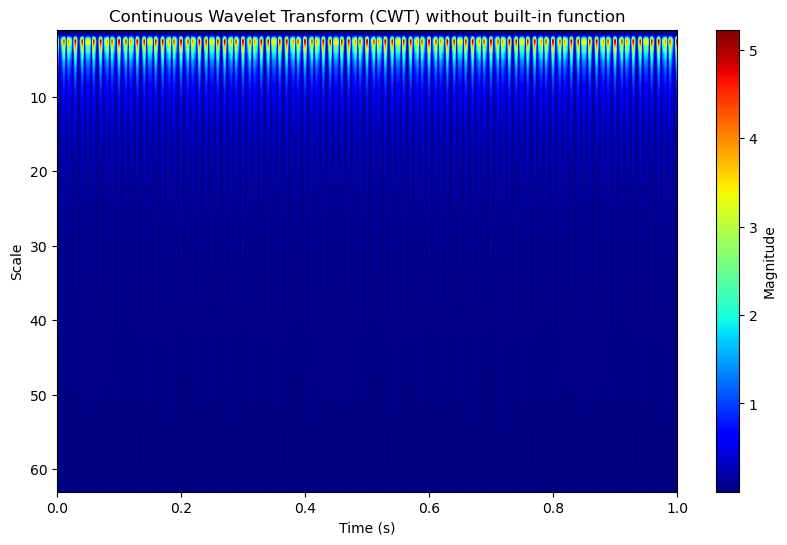

In [5]:
import numpy as np
import matplotlib.pyplot as plt

def morlet_wavelet(t, s, f0=1.0):
    """
    Compute the Morlet wavelet for a given time array t and scale s.
    f0 is the central frequency of the Morlet wavelet (default is 1.0).
    """
    return np.exp(1j * 2 * np.pi * f0 * t / s) * np.exp(-t**2 / (2 * s**2))

def compute_custom_cwt(signal, scales, wavelet_func=morlet_wavelet, sampling_rate=1.0):
    """
    Compute the Continuous Wavelet Transform (CWT) of a signal.

    Parameters:
    - signal: 1D numpy array, the input signal.
    - scales: list or array of scales to use in the transform.
    - wavelet_func: function, wavelet function to use (default is Morlet wavelet).
    - sampling_rate: float, sampling rate of the signal (default is 1.0).

    Returns:
    - coef: 2D numpy array of CWT coefficients.
    """
    n = len(signal)
    t = np.arange(-n // 2, n // 2) / sampling_rate
    coef = np.zeros((len(scales), n), dtype=np.complex_)

    # Perform the CWT by convolving with scaled wavelets
    for i, scale in enumerate(scales):
        wavelet = wavelet_func(t, scale)
        wavelet /= np.sqrt(scale)  # Normalize by the square root of the scale
        # Convolution in the frequency domain (Fourier Transform)
        signal_ft = np.fft.fft(signal)
        wavelet_ft = np.fft.fft(wavelet, n)
        conv_result = np.fft.ifft(signal_ft * wavelet_ft)
        coef[i, :] = conv_result

    return np.abs(coef)

sampling_rate = 1000  # Sampling rate in Hz
t = np.linspace(0, 1, sampling_rate, endpoint=False)  # Time vector of 1 second
signal = np.sin(2 * np.pi * 50 * t) + 0.5 * np.sin(2 * np.pi * 120 * t)  # Composite signal with two frequencies

# Define scales for the CWT
scales = np.arange(1, 64)

# Compute the CWT coefficients
cwt_coefficients = compute_custom_cwt(signal, scales, sampling_rate=sampling_rate)

# Plot the CWT result as a time-scale representation
plt.figure(figsize=(10, 6))
plt.imshow(cwt_coefficients, extent=[0, 1, scales[-1], scales[0]], aspect='auto', cmap='jet')
plt.colorbar(label='Magnitude')
plt.xlabel('Time (s)')
plt.ylabel('Scale')
plt.title('Continuous Wavelet Transform (CWT) without built-in function')
plt.show()


In [1]:
import os
import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy.signal import butter, filtfilt
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
import random
import pywt

# Set folder path containing PCG files, ECG files, and reference CSVs
folder_path = "./bsp_dataset/Training-a"
reference_path = "./bsp_dataset/Training-a/REFERENCE.csv"  # Adjust path as needed
online_appendix_path = "./bsp_dataset/annotations/Online_Appendix_Training_Set.csv"  # Adjust path as needed

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Load the reference CSV file for labels without headers
reference_df = pd.read_csv(reference_path, header=None)
reference_df.columns = ['Record', 'Label']

# Function to apply bandpass filter to the signal
def bandpass_filter(signal, lowcut=0.5, highcut=150.0, fs=500, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, signal)

# Function to normalize the signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    return (signal - min_val) / (max_val - min_val)

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, _ = pywt.cwt(signal, scales, wavelet)
    return coef

# Function to process PCG signals and return features
def process_pcg_signal(record_name, folder_path):
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)
    scales = np.arange(1, 64)
    coef = compute_cwt(normalized_pcg_signal, scales=scales)
    return np.abs(coef).flatten().astype(np.float32)

# Function to process ECG signals from .dat files and return features
def process_ecg_signal(record_name, folder_path):
    ecg_file_path = os.path.join(folder_path, record_name.replace('.wav', '.dat'))
    if not os.path.isfile(ecg_file_path):
        return None  # Return None if ECG file is missing
    ecg_signal = np.fromfile(ecg_file_path, dtype=np.int16)
    filtered_ecg_signal = bandpass_filter(ecg_signal, lowcut=0.5, highcut=40.0, fs=500)
    normalized_ecg_signal = normalize_signal(filtered_ecg_signal)
    scales = np.arange(1, 64)
    coef = compute_cwt(normalized_ecg_signal, scales=scales)
    return np.abs(coef).flatten().astype(np.float32)

# Load and inspect Online_Appendix_Training_Set.csv
diagnosis_df = pd.read_csv(online_appendix_path)
diagnosis_mapping = {diagnosis: idx for idx, diagnosis in enumerate(diagnosis_df['Diagnosis'].unique())}
diagnosis_df['Diagnosis_Class'] = diagnosis_df['Diagnosis'].map(diagnosis_mapping)

# Map binary labels for normal/abnormal detection (0: Normal, 1: Abnormal)
diagnosis_df['Abnormal'] = diagnosis_df['Diagnosis_Class'].apply(lambda x: 1 if x > 0 else 0)

# Collect combined features from PCG and ECG signals
features, binary_labels, multiclass_labels = [], [], []

for sample in samples:
    record_name = sample.split('.')[0]
    label_row = diagnosis_df[diagnosis_df['Record'] == record_name]
    if not label_row.empty:
        abnormal_label = label_row['Abnormal'].values[0]
        diagnosis_label = label_row['Diagnosis_Class'].values[0]
        
        # Check if both PCG and ECG signals are available
        pcg_file_path = os.path.join(folder_path, sample)
        ecg_file_path = os.path.join(folder_path, sample.replace('.wav', '.dat'))
        
        if not os.path.isfile(pcg_file_path) or not os.path.isfile(ecg_file_path):
            continue  # Skip if either PCG or ECG file is missing
        
        # Process both PCG and ECG features
        pcg_features = process_pcg_signal(sample, folder_path)
        ecg_features = process_ecg_signal(sample, folder_path)
        
        if ecg_features is None:
            continue  # Skip if ECG processing failed (e.g., empty or unreadable file)
        
        # Combine PCG and ECG features
        combined_features = np.concatenate([pcg_features, ecg_features])
        print(combined_features)
        features.append(combined_features)
        binary_labels.append(abnormal_label)
        multiclass_labels.append(diagnosis_label)

# Pad/truncate features to max_length
max_length = 8192
features_padded = [
    np.pad(f, (0, max_length - len(f)), 'constant') if len(f) < max_length else f[:max_length]
    for f in features
]

features_padded = np.array(features_padded, dtype=np.float32)
binary_labels = np.array(binary_labels)
multiclass_labels = np.array(multiclass_labels)

# Split data for binary classification (normal vs. abnormal)
X_train_bin, X_test_bin, y_train_bin, y_test_bin = train_test_split(features_padded, binary_labels, test_size=0.2, random_state=42)
scaler_bin = StandardScaler()
X_train_bin_scaled = scaler_bin.fit_transform(X_train_bin)
binary_svm_model = SVC(kernel='rbf')
binary_svm_model.fit(X_train_bin_scaled, y_train_bin)

# Split data for multi-class classification (disease type) only for abnormal samples
X_train_multi, X_test_multi, y_train_multi, y_test_multi = train_test_split(features_padded[binary_labels == 1], multiclass_labels[binary_labels == 1], test_size=0.2, random_state=42)
scaler_multi = StandardScaler()
X_train_multi_scaled = scaler_multi.fit_transform(X_train_multi)
multiclass_svm_model = SVC(kernel='rbf')
multiclass_svm_model.fit(X_train_multi_scaled, y_train_multi)

# Binary classifier performance
X_test_bin_scaled = scaler_bin.transform(X_test_bin)
y_pred_bin = binary_svm_model.predict(X_test_bin_scaled)
binary_accuracy = accuracy_score(y_test_bin, y_pred_bin)
print(f"Binary Test Accuracy (Normal vs Abnormal): {binary_accuracy * 100:.2f}%")

# Multi-class classifier performance (for abnormal samples)
X_test_multi_scaled = scaler_multi.transform(X_test_multi)
y_pred_multi = multiclass_svm_model.predict(X_test_multi_scaled)
multiclass_accuracy = accuracy_score(y_test_multi, y_pred_multi)
print(f"Multi-Class Test Accuracy (Disease Classification): {multiclass_accuracy * 100:.2f}%")

# Predict normal/abnormal and specific disease type for a random sample
random_sample = random.choice(samples)
random_pcg_features = process_pcg_signal(random_sample, folder_path)
random_ecg_features = process_ecg_signal(random_sample, folder_path)
if random_ecg_features is not None:
    random_combined_features = np.concatenate([random_pcg_features, random_ecg_features])
    random_combined_features_padded = np.pad(random_combined_features, (0, max_length - len(random_combined_features)), 'constant') if len(random_combined_features) < max_length else random_combined_features[:max_length]

    # Scale and predict normal/abnormal
    random_feature_scaled_bin = scaler_bin.transform([random_combined_features_padded])
    abnormal_prediction = binary_svm_model.predict(random_feature_scaled_bin)[0]

    if abnormal_prediction == 1:
        # If abnormal, predict specific disease type
        random_feature_scaled_multi = scaler_multi.transform([random_combined_features_padded])
        disease_class_prediction = multiclass_svm_model.predict(random_feature_scaled_multi)[0]
        predicted_disease = list(diagnosis_mapping.keys())[list(diagnosis_mapping.values()).index(disease_class_prediction)]
        print(f"Prediction for {random_sample}: Abnormal - {predicted_disease}")
    else:
        print(f"Prediction for {random_sample}: Normal")

    # Compare with actual diagnosis
    actual_label_row = diagnosis_df[diagnosis_df['Record'] == random_sample.split('.')[0]]
    if not actual_label_row.empty:
        actual_abnormal = actual_label_row['Abnormal'].values[0]
        actual_disease_class = actual_label_row['Diagnosis_Class'].values[0]
        if abnormal_prediction == actual_abnormal:
            if abnormal_prediction == 1:
                actual_diagnosis = list(diagnosis_mapping.keys())[list(diagnosis_mapping.values()).index(actual_disease_class)]
                print(f"Actual diagnosis for {random_sample}:{actual_diagnosis}")
                if disease_class_prediction == actual_disease_class:
                    print("The disease type prediction is correct!")
                else:
                    print("The disease type prediction is incorrect.")
            else:
                print("The normal/abnormal prediction is correct!")
        else:
            print("The normal/abnormal prediction is incorrect.")
else:
    print(f"Skipped prediction for {random_sample} due to missing ECG signal.")


[0.00079547 0.05103351 0.00092148 ... 0.03105167 0.01447398 0.00221305]
[0.00734313 0.06749359 0.01064036 ... 0.06354472 0.04655166 0.02926253]
[0.00138005 0.04081373 0.00017669 ... 0.06181451 0.0410178  0.01994288]
[0.00222217 0.0699201  0.00543061 ... 0.05842333 0.03981078 0.02096169]
[1.6231959e-04 7.3375560e-02 2.6647777e-03 ... 1.8035372e-01 1.4735968e-01
 1.1355672e-01]
[0.00904844 0.05662674 0.00916725 ... 0.04346108 0.0274225  0.01126682]
[0.00607782 0.05998427 0.00905715 ... 0.10065899 0.06976194 0.03843023]
[0.00622292 0.05010071 0.00482616 ... 0.3025397  0.22183327 0.13985705]
[0.00099842 0.05733949 0.00177978 ... 0.18336262 0.1117178  0.03945215]
[0.00085254 0.05409089 0.00170982 ... 0.05445922 0.03500012 0.01530694]
[0.00015598 0.06549747 0.00222559 ... 0.11418965 0.08035646 0.04598821]
[0.00136107 0.05348819 0.00454227 ... 0.3130092  0.23028362 0.14786343]
[0.00100861 0.07030114 0.00227524 ... 0.42031616 0.32813814 0.23427528]
[0.00074405 0.06584452 0.00253566 ... 0.05010

[0.00334521 0.08083687 0.00864062 ... 0.20583498 0.1235349  0.04042132]
[0.00121311 0.06214167 0.00387793 ... 0.26906437 0.1832136  0.09641501]
[0.00157411 0.06671233 0.0039523  ... 0.18642727 0.14324577 0.1002969 ]
[0.006633   0.05992978 0.00663722 ... 0.19295637 0.12664218 0.05950588]
[0.00131045 0.06052557 0.00033364 ... 0.05504713 0.03778859 0.02029848]
[2.4073957e-03 7.3071830e-02 7.7697630e-05 ... 6.3874193e-02 4.6097845e-02
 2.8048890e-02]
[0.02001033 0.0864463  0.02855921 ... 0.14019094 0.04565246 0.04904873]
[0.00106933 0.05593573 0.00064288 ... 0.14644194 0.2377857  0.3276606 ]
[0.00197418 0.0662688  0.00277098 ... 0.04471531 0.02623428 0.00758437]
[0.00074158 0.05980596 0.00335952 ... 0.2824304  0.20046543 0.11726162]
[0.00115684 0.06435124 0.00137842 ... 0.01297794 0.00516755 0.02324346]
[0.00338438 0.0704865  0.00217392 ... 0.06230632 0.03996363 0.01734972]
[0.00013398 0.04727575 0.00205415 ... 0.08231442 0.00390409 0.07386504]
[1.9168921e-04 5.9179991e-02 2.4262322e-03 ..

[0.0011483  0.04372377 0.00266573 ... 0.01353641 0.0099854  0.0333711 ]
[0.00015026 0.05618988 0.00193062 ... 0.02576862 0.00859658 0.00862339]
[0.00129706 0.04896114 0.00363455 ... 0.21358943 0.1381867  0.06165262]
[0.00442943 0.06731496 0.00868377 ... 0.13847016 0.08619157 0.03334312]
[0.00125487 0.05665704 0.00343735 ... 0.12962544 0.10724975 0.0842368 ]
[0.00084866 0.06190427 0.00232714 ... 0.45425206 0.40174913 0.34717962]
[1.0821645e-04 5.5424005e-02 2.1566621e-03 ... 2.0686905e-01 1.3210741e-01
 5.6435592e-02]
[0.00014914 0.05856665 0.00272159 ... 0.05308956 0.03645651 0.01957004]
[0.00900451 0.071257   0.00891862 ... 0.22556067 0.14318614 0.05990751]
[0.00034845 0.06252697 0.00211996 ... 0.242688   0.22353645 0.20314306]
[0.00339828 0.05893031 0.00788849 ... 0.30431503 0.2214747  0.13749696]
[0.00070473 0.06940924 0.0018297  ... 0.15478119 0.1167279  0.07802568]
[0.00378947 0.05906104 0.00210087 ... 0.05549883 0.03641404 0.01712466]
[0.00105888 0.05871556 0.00097038 ... 0.06518

[0.00388297 0.06432345 0.00148321 ... 0.09407291 0.06936228 0.04418657]
[1.6619189e-04 6.1841980e-02 2.6991870e-03 ... 3.8211787e-01 3.3854547e-01
 2.9481626e-01]
[0.00016336 0.05027026 0.00372332 ... 0.0495141  0.02978406 0.0098663 ]
[0.00378494 0.08324158 0.00137073 ... 0.04306563 0.02727177 0.01130085]
[0.00079383 0.04751459 0.00150257 ... 0.13205424 0.13502984 0.1370767 ]
[0.00095806 0.06607657 0.00161922 ... 0.03037962 0.01822899 0.0058403 ]
[0.00115411 0.0683763  0.0010866  ... 0.19649948 0.09962808 0.0032947 ]
[0.00077671 0.05687303 0.00396833 ... 0.4973811  0.450275   0.4007323 ]
[9.2839211e-04 6.6784307e-02 1.3251631e-03 ... 1.0238107e+00 9.3039143e-01
 8.3079696e-01]
[0.00838792 0.0642153  0.00667714 ... 0.05583026 0.03799644 0.01990364]
[0.00248604 0.06898004 0.00613135 ... 0.0160621  0.04702368 0.07761414]
[0.00337563 0.06483562 0.01027477 ... 0.05904099 0.03117505 0.00309764]
[0.00223864 0.06646495 0.00029644 ... 0.0446998  0.01229936 0.02019947]
[0.0002675  0.06341388 0.0

In [1]:
import os
import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy.signal import butter, filtfilt
import random
import pywt
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score

# Set folder path containing PCG files, ECG files, and reference CSVs
folder_path = "./bsp_dataset/Training-a"
reference_path = "./bsp_dataset/Training-a/REFERENCE.csv"  # Adjust path as needed
online_appendix_path = "./bsp_dataset/annotations/Online_Appendix_Training_Set.csv"  # Adjust path as needed

# List all PCG data samples (assuming they are in .wav format)
samples = [f for f in os.listdir(folder_path) if f.endswith('.wav')]

# Load the reference CSV file for labels without headers
reference_df = pd.read_csv(reference_path, header=None)
reference_df.columns = ['Record', 'Label']

# Function to apply bandpass filter to the signal
def bandpass_filter(signal, lowcut=0.5, highcut=150.0, fs=500, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, signal)

# Function to normalize the signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    return (signal - min_val) / (max_val - min_val)

# Function to compute Continuous Wavelet Transform (CWT)
def compute_cwt(signal, wavelet='morl', scales=np.arange(1, 128)):
    coef, _ = pywt.cwt(signal, scales, wavelet)
    return coef

# Function to process PCG signals and return features
def process_pcg_signal(record_name, folder_path):
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)
    scales = np.arange(1, 64)
    coef = compute_cwt(normalized_pcg_signal, scales=scales)
    return np.abs(coef).flatten().astype(np.float32)

# Function to process ECG signals from .dat files and return features
def process_ecg_signal(record_name, folder_path):
    ecg_file_path = os.path.join(folder_path, record_name.replace('.wav', '.dat'))
    if not os.path.isfile(ecg_file_path):
        return None  # Return None if ECG file is missing
    ecg_signal = np.fromfile(ecg_file_path, dtype=np.int16)
    filtered_ecg_signal = bandpass_filter(ecg_signal, lowcut=0.5, highcut=40.0, fs=500)
    normalized_ecg_signal = normalize_signal(filtered_ecg_signal)
    scales = np.arange(1, 64)
    coef = compute_cwt(normalized_ecg_signal, scales=scales)
    return np.abs(coef).flatten().astype(np.float32)

# Load and inspect Online_Appendix_Training_Set.csv
diagnosis_df = pd.read_csv(online_appendix_path)
diagnosis_mapping = {diagnosis: idx for idx, diagnosis in enumerate(diagnosis_df['Diagnosis'].unique())}
diagnosis_df['Diagnosis_Class'] = diagnosis_df['Diagnosis'].map(diagnosis_mapping)

# Map binary labels for normal/abnormal detection (0: Normal, 1: Abnormal)
diagnosis_df['Abnormal'] = diagnosis_df['Diagnosis_Class'].apply(lambda x: 1 if x > 0 else 0)

# Collect combined features from PCG and ECG signals
features, binary_labels, multiclass_labels = [], [], []

for sample in samples:
    record_name = sample.split('.')[0]
    label_row = diagnosis_df[diagnosis_df['Record'] == record_name]
    if not label_row.empty:
        abnormal_label = label_row['Abnormal'].values[0]
        diagnosis_label = label_row['Diagnosis_Class'].values[0]
        
        # Check if both PCG and ECG signals are available
        pcg_file_path = os.path.join(folder_path, sample)
        ecg_file_path = os.path.join(folder_path, sample.replace('.wav', '.dat'))
        
        if not os.path.isfile(pcg_file_path) or not os.path.isfile(ecg_file_path):
            continue  # Skip if either PCG or ECG file is missing
        
        # Process both PCG and ECG features
        pcg_features = process_pcg_signal(sample, folder_path)
        ecg_features = process_ecg_signal(sample, folder_path)
        
        if ecg_features is None:
            continue  # Skip if ECG processing failed (e.g., empty or unreadable file)
        
        # Combine PCG and ECG features
        combined_features = np.concatenate([pcg_features, ecg_features])
        features.append(combined_features)
        binary_labels.append(abnormal_label)
        multiclass_labels.append(diagnosis_label)

# Pad/truncate features to max_length
max_length = 8192
features_padded = [
    np.pad(f, (0, max_length - len(f)), 'constant') if len(f) < max_length else f[:max_length]
    for f in features
]

features_padded = np.array(features_padded, dtype=np.float32)
binary_labels = np.array(binary_labels)
multiclass_labels = np.array(multiclass_labels)

# Reshape features for CNN+LSTM (assuming each sample is 1D with max_length)
features_reshaped = features_padded.reshape((features_padded.shape[0], max_length, 1))

# Define CNN+LSTM model for binary classification
def build_cnn_lstm_model(input_shape):
    model = tf.keras.models.Sequential()
    model.add(tf.keras.layers.Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=input_shape))
    model.add(tf.keras.layers.MaxPooling1D(pool_size=2))
    model.add(tf.keras.layers.Conv1D(filters=128, kernel_size=3, activation='relu'))
    model.add(tf.keras.layers.MaxPooling1D(pool_size=2))
    model.add(tf.keras.layers.LSTM(64, return_sequences=False))
    model.add(tf.keras.layers.Dense(64, activation='relu'))
    model.add(tf.keras.layers.Dense(1, activation='sigmoid'))  # For binary classification
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Build and train CNN+LSTM model for binary classification
binary_model = build_cnn_lstm_model((max_length, 1))
X_train_bin, X_test_bin, y_train_bin, y_test_bin = train_test_split(features_reshaped, binary_labels, test_size=0.2, random_state=42)
binary_model.fit(X_train_bin, y_train_bin, epochs=10, batch_size=32, validation_split=0.2)

# Evaluate binary classification performance
binary_test_loss, binary_test_acc = binary_model.evaluate(X_test_bin, y_test_bin)
print(f"Binary Classification Test Accuracy: {binary_test_acc * 100:.2f}%")

# Define CNN+LSTM model for multi-class classification
def build_cnn_lstm_multi_model(input_shape, num_classes):
    model = tf.keras.models.Sequential()
    model.add(tf.keras.layers.Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=input_shape))
    model.add(tf.keras.layers.MaxPooling1D(pool_size=2))
    model.add(tf.keras.layers.Conv1D(filters=128, kernel_size=3, activation='relu'))
    model.add(tf.keras.layers.MaxPooling1D(pool_size=2))
    model.add(tf.keras.layers.LSTM(64, return_sequences=False))
    model.add(tf.keras.layers.Dense(64, activation='relu'))
    model.add(tf.keras.layers.Dense(num_classes, activation='softmax'))  # For multi-class classification
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# Build and train CNN+LSTM model for multi-class classification
num_classes = len(diagnosis_mapping)
multiclass_model = build_cnn_lstm_multi_model((max_length, 1), num_classes)
X_train_multi, X_test_multi, y_train_multi, y_test_multi = train_test_split(
    features_reshaped[binary_labels == 1], multiclass_labels[binary_labels == 1], test_size=0.2, random_state=42)
multiclass_model.fit(X_train_multi, y_train_multi, epochs=10, batch_size=32, validation_split=0.2)

# Evaluate multi-class classification performance
multi_test_loss, multi_test_acc = multiclass_model.evaluate(X_test_multi, y_test_multi)
print(f"Multi-class Classification Test Accuracy: {multi_test_acc * 100:.2f}%")
# Evaluate binary classification performance
binary_test_loss, binary_test_acc = binary_model.evaluate(X_test_bin, y_test_bin)
print(f"Binary Classification Test Accuracy: {binary_test_acc * 100:.2f}%")

# Predict binary labels
binary_predictions_prob = binary_model.predict(X_test_bin)
binary_predictions = (binary_predictions_prob > 0.5).astype(int)

# Display the first few predictions alongside actual labels for binary classification
print("\nBinary Classification Predictions (first 10):")
for i in range(10):
    print(f"Predicted: {binary_predictions[i][0]}, Actual: {y_test_bin[i]}")

# Evaluate multi-class classification performance
multi_test_loss, multi_test_acc = multiclass_model.evaluate(X_test_multi, y_test_multi)
print(f"Multi-class Classification Test Accuracy: {multi_test_acc * 100:.2f}%")

# Predict multi-class labels
multi_predictions_prob = multiclass_model.predict(X_test_multi)
multi_predictions = np.argmax(multi_predictions_prob, axis=1)

# Display the first few predictions alongside actual labels for multi-class classification
print("\nMulti-class Classification Predictions (first 10):")
for i in range(10):
    print(f"Predicted: {multi_predictions[i]}, Actual: {y_test_multi[i]}")

# Optional: Save the predictions to CSV for further analysis
binary_predictions_df = pd.DataFrame({'Actual': y_test_bin, 'Predicted': binary_predictions.flatten()})
binary_predictions_df.to_csv('binary_classification_predictions.csv', index=False)

multi_predictions_df = pd.DataFrame({'Actual': y_test_multi, 'Predicted': multi_predictions})
multi_predictions_df.to_csv('multi_classification_predictions.csv', index=False)



C:\Users\Harshith\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
9/9 ━━━━━━━━━━━━━━━━━━━━ 37s 3s/step - accuracy: 0.6690 - loss: 0.6872 - val_accuracy: 0.6615 - val_loss: 0.6609
Epoch 2/10
9/9 ━━━━━━━━━━━━━━━━━━━━ 25s 3s/step - accuracy: 0.7112 - loss: 0.6397 - val_accuracy: 0.6615 - val_loss: 0.6424
Epoch 3/10
9/9 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.6645 - loss: 0.6403 - val_accuracy: 0.6615 - val_loss: 0.6402
Epoch 4/10
9/9 ━━━━━━━━━━━━━━━━━━━━ 253s 31s/step - accuracy: 0.6957 - loss: 0.6172 - val_accuracy: 0.6615 - val_loss: 0.6401
Epoch 5/10
9/9 ━━━━━━━━━━━━━━━━━━━━ 25s 3s/step - accuracy: 0.6674 - loss: 0.6366 - val_accuracy: 0.6615 - val_loss: 0.6417
Epoch 6/10
9/9 ━━━━━━━━━━━━━━━━━━━━ 28s 3s/step - accuracy: 0.7049 - loss: 0.6077 - val_accuracy: 0.6615 - val_loss: 0.6402
Epoch 7/10
9/9 ━━━━━━━━━━━━━━━━━━━━ 25s 3s/step - accuracy: 0.6858 - loss: 0.6236 - val_accuracy: 0.6615 - val_loss: 0.6401
Epoch 8/10
9/9 ━━━━━━━━━━━━━━━━━━━━ 29s 3s/step - accuracy: 0.6548 - loss: 0.6504 - val_accuracy: 0.6615 - val_loss: 0.6448
Epoch 

Filtered records saved to: ./filtered_records.csv


KeyboardInterrupt: 

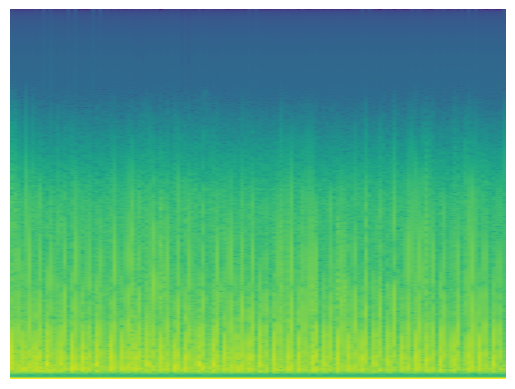

In [9]:
import os
import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy.signal import butter, filtfilt
import matplotlib.pyplot as plt
import random
import pywt
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score

# Paths
folder_base_path = "./bsp_dataset/"
annotations_path = os.path.join(folder_base_path, "annotations/Online_Appendix_Training_Set.csv")
spectrograms_path = "./spectrograms/"

# Create folder for spectrograms
os.makedirs(spectrograms_path, exist_ok=True)

# Load and filter the CSV file
diagnosis_df = pd.read_csv(annotations_path, usecols=["Record", "Database", "Diagnosis", "Class"])
diagnosis_df = diagnosis_df[diagnosis_df['Diagnosis'].isin(['MVP', 'Benign', 'Normal'])]

# Save filtered records to a new CSV
filtered_csv_path = "./filtered_records.csv"
diagnosis_df.to_csv(filtered_csv_path, index=False)
print(f"Filtered records saved to: {filtered_csv_path}")

# Function to apply bandpass filter to the signal
def bandpass_filter(signal, lowcut=0.5, highcut=150.0, fs=500, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, signal)

# Function to normalize the signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    return (signal - min_val) / (max_val - min_val)

# Function to compute and save spectrogram
def save_spectrogram(signal, fs, filename):
    plt.specgram(signal, Fs=fs, NFFT=1024, noverlap=512, cmap="viridis")
    plt.axis("off")
    plt.savefig(filename, bbox_inches="tight", pad_inches=0)
    plt.close()

# Function to process PCG signals and save spectrograms
def process_pcg_signal(record_name, folder_path):
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)
    spectrogram_filename = os.path.join(spectrograms_path, f"{record_name}_pcg.png")
    save_spectrogram(normalized_pcg_signal, fs, spectrogram_filename)
    return spectrogram_filename

# Function to process ECG signals and save spectrograms
def process_ecg_signal(record_name, folder_path):
    ecg_file_path = os.path.join(folder_path, record_name.replace('.wav', '.dat'))
    if not os.path.isfile(ecg_file_path):
        return None
    ecg_signal = np.fromfile(ecg_file_path, dtype=np.int16)
    filtered_ecg_signal = bandpass_filter(ecg_signal, lowcut=0.5, highcut=40.0, fs=500)
    normalized_ecg_signal = normalize_signal(filtered_ecg_signal)
    spectrogram_filename = os.path.join(spectrograms_path, f"{record_name}_ecg.png")
    save_spectrogram(normalized_ecg_signal, fs=500, filename=spectrogram_filename)
    return spectrogram_filename

# Collect spectrogram features and labels
features, binary_labels, multiclass_labels = [], [], []

for _, row in diagnosis_df.iterrows():
    record_name = row['Record']
    diagnosis = row['Diagnosis']
    class_label = row['Class']
    folder_path = os.path.join(folder_base_path, row['Database'])

    # Check if PCG and ECG files exist
    pcg_file_path = os.path.join(folder_path, f"{record_name}.wav")
    ecg_file_path = os.path.join(folder_path, f"{record_name}.dat")

    if not os.path.isfile(pcg_file_path) or not os.path.isfile(ecg_file_path):
        continue

    # Process and save spectrograms
    pcg_spectrogram_path = process_pcg_signal(f"{record_name}.wav", folder_path)
    ecg_spectrogram_path = process_ecg_signal(f"{record_name}.wav", folder_path)

    if pcg_spectrogram_path and ecg_spectrogram_path:
        features.append([pcg_spectrogram_path, ecg_spectrogram_path])
        binary_labels.append(1 if diagnosis != 'normal' else 0)
        multiclass_labels.append(diagnosis)

# CNN+LSTM Model Definition for Spectrogram Inputs
def build_cnn_lstm_model(input_shape, num_classes, classification_type='binary'):
    model = tf.keras.models.Sequential()
    model.add(tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape))
    model.add(tf.keras.layers.MaxPooling2D((2, 2)))
    model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(tf.keras.layers.MaxPooling2D((2, 2)))
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(64, activation='relu'))
    if classification_type == 'binary':
        model.add(tf.keras.layers.Dense(1, activation='sigmoid'))
        model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    else:
        model.add(tf.keras.layers.Dense(num_classes, activation='softmax'))
        model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# Convert spectrogram images to arrays for training
def load_spectrogram_images(filepaths):
    images = [plt.imread(filepath) for filepath in filepaths]
    return np.array(images)

# Prepare data for binary and multi-class classification
binary_features = [load_spectrogram_images(f) for f, _ in features]
multiclass_features = [load_spectrogram_images(f) for f, _ in features if multiclass_labels]

# Train-test split
X_train_bin, X_test_bin, y_train_bin, y_test_bin = train_test_split(
    binary_features, binary_labels, test_size=0.2, random_state=42
)
X_train_multi, X_test_multi, y_train_multi, y_test_multi = train_test_split(
    multiclass_features, multiclass_labels, test_size=0.2, random_state=42
)

# Binary classification model training
binary_model = build_cnn_lstm_model(X_train_bin[0].shape, None, classification_type='binary')
binary_model.fit(X_train_bin, y_train_bin, epochs=10, batch_size=32, validation_split=0.2)

# Multi-class classification model training
num_classes = len(set(multiclass_labels))
multiclass_model = build_cnn_lstm_model(X_train_multi[0].shape, num_classes, classification_type='multiclass')
multiclass_model.fit(X_train_multi, y_train_multi, epochs=10, batch_size=32, validation_split=0.2)

# Evaluate models
binary_test_loss, binary_test_acc = binary_model.evaluate(X_test_bin, y_test_bin)
print(f"Binary Classification Test Accuracy: {binary_test_acc * 100:.2f}%")

multi_test_loss, multi_test_acc = multiclass_model.evaluate(X_test_multi, y_test_multi)
print(f"Multi-class Classification Test Accuracy: {multi_test_acc * 100:.2f}%")

In [13]:
import os
import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy.signal import butter, filtfilt
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.model_selection import train_test_split

# Paths
folder_base_path = "./bsp_dataset/"
annotations_path = os.path.join(folder_base_path, "annotations/Online_Appendix_Training_Set.csv")
spectrograms_path = "./spectrograms/"

# Create folder for spectrograms
os.makedirs(spectrograms_path, exist_ok=True)

# Load and filter the CSV file for training-a
diagnosis_df = pd.read_csv(annotations_path, usecols=["Record", "Database", "Diagnosis", "Class"])
training_a_df = diagnosis_df[(diagnosis_df['Database'] == 'training-a') & 
                             (diagnosis_df['Diagnosis'].isin(['MVP', 'Benign', 'Normal']))]

# Count the records
mvp_benign_count = len(training_a_df[training_a_df['Diagnosis'].isin(['MVP', 'Benign'])])
normal_count = len(training_a_df[training_a_df['Diagnosis'] == 'Normal'])

# Check balance and add more Normal records from training-b if needed
if mvp_benign_count != normal_count:
    training_b_df = diagnosis_df[(diagnosis_df['Database'] == 'training-b') & 
                                 (diagnosis_df['Diagnosis'] == 'Normal')]
    additional_normals_needed = mvp_benign_count - normal_count
    additional_normals = training_b_df.sample(n=additional_normals_needed, random_state=42)
    training_a_df = pd.concat([training_a_df, additional_normals])

# Save balanced records to a new CSV
filtered_csv_path = "./balanced_records.csv"
training_a_df.to_csv(filtered_csv_path, index=False)
print(f"Balanced records saved to: {filtered_csv_path}")

# Function to apply bandpass filter to the signal
def bandpass_filter(signal, lowcut=0.5, highcut=150.0, fs=500, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, signal)

# Function to normalize the signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    return (signal - min_val) / (max_val - min_val)

# Function to compute and save spectrogram
def save_spectrogram(signal, fs, filename):
    plt.specgram(signal, Fs=fs, NFFT=1024, noverlap=512, cmap="viridis")
    plt.axis("off")
    plt.savefig(filename, bbox_inches="tight", pad_inches=0)
    plt.close()

# Function to process PCG signals and save spectrograms
def process_pcg_signal(record_name, folder_path):
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)
    spectrogram_filename = os.path.join(spectrograms_path, f"{record_name}_pcg.png")
    save_spectrogram(normalized_pcg_signal, fs, spectrogram_filename)
    return spectrogram_filename

# Collect spectrogram features and labels
features, labels = [], []

for _, row in training_a_df.iterrows():
    record_name = row['Record']
    diagnosis = row['Diagnosis']
    folder_path = os.path.join(folder_base_path, row['Database'])

    # Check if PCG file exists
    pcg_file_path = os.path.join(folder_path, f"{record_name}.wav")

    if not os.path.isfile(pcg_file_path):
        continue

    # Process and save spectrograms
    pcg_spectrogram_path = process_pcg_signal(f"{record_name}.wav", folder_path)

    if pcg_spectrogram_path:
        features.append(pcg_spectrogram_path)
        labels.append(1 if diagnosis != 'Normal' else 0)

# CNN Model Definition for Spectrogram Inputs
def build_cnn_model(input_shape):
    model = tf.keras.models.Sequential()
    model.add(tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape))
    model.add(tf.keras.layers.MaxPooling2D((2, 2)))
    model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(tf.keras.layers.MaxPooling2D((2, 2)))
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(64, activation='relu'))
    model.add(tf.keras.layers.Dense(1, activation='sigmoid'))
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Convert spectrogram images to arrays for training
def load_spectrogram_images(filepaths):
    images = [plt.imread(filepath) for filepath in filepaths]
    return np.array(images)

# Prepare data for binary classification
image_features = load_spectrogram_images(features)
labels = np.array(labels)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(image_features, labels, test_size=0.2, random_state=42)

# Build and train the model
cnn_model = build_cnn_model(X_train[0].shape)
cnn_model.fit(X_train, y_train, epochs=10, batch_size=32, validation_split=0.2)

# Evaluate the model
test_loss, test_acc = cnn_model.evaluate(X_test, y_test)
print(f"Binary Classification Test Accuracy: {test_acc * 100:.2f}%")

Balanced records saved to: ./balanced_records.csv


C:\Users\Harshith\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 26s 2s/step - accuracy: 0.5559 - loss: 16.9029 - val_accuracy: 0.5926 - val_loss: 0.6856
Epoch 2/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 21s 2s/step - accuracy: 0.5341 - loss: 0.6859 - val_accuracy: 0.5926 - val_loss: 0.6418
Epoch 3/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 22s 2s/step - accuracy: 0.5812 - loss: 0.6639 - val_accuracy: 0.5309 - val_loss: 0.6736
Epoch 4/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.5808 - loss: 0.6895 - val_accuracy: 0.5926 - val_loss: 0.6902
Epoch 5/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 24s 2s/step - accuracy: 0.6372 - loss: 0.6912 - val_accuracy: 0.7037 - val_loss: 0.6877
Epoch 6/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.7626 - loss: 0.6706 - val_accuracy: 0.5062 - val_loss: 0.6990
Epoch 7/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.6886 - loss: 0.5945 - val_accuracy: 0.4568 - val_loss: 1.1534
Epoch 8/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.6299 - loss: 0.6993 - val_accuracy: 0.7407 - val_loss

In [1]:
import os
import numpy as np
import pandas as pd
from scipy.io import wavfile
from scipy.signal import butter, filtfilt
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.model_selection import train_test_split

# Paths
folder_base_path = "./bsp_dataset/"
annotations_path = os.path.join(folder_base_path, "annotations/Online_Appendix_Training_Set.csv")
spectrograms_path = "./spectrograms/"

# Create folder for spectrograms
os.makedirs(spectrograms_path, exist_ok=True)

# Load and filter the CSV file for training-a
diagnosis_df = pd.read_csv(annotations_path, usecols=["Record", "Database", "Diagnosis", "Class"])
training_a_df = diagnosis_df[(diagnosis_df['Database'] == 'training-a') & 
                             (diagnosis_df['Diagnosis'].isin(['MVP', 'Benign', 'Normal']))]

# Count the records
mvp_benign_count = len(training_a_df[training_a_df['Diagnosis'].isin(['MVP', 'Benign'])])
normal_count = len(training_a_df[training_a_df['Diagnosis'] == 'Normal'])

# Check balance and add more Normal records from training-b if needed
if mvp_benign_count != normal_count:
    training_b_df = diagnosis_df[(diagnosis_df['Database'] == 'training-b') & 
                                 (diagnosis_df['Diagnosis'] == 'Normal')]
    additional_normals_needed = mvp_benign_count - normal_count
    additional_normals = training_b_df.sample(n=additional_normals_needed, random_state=42)
    training_a_df = pd.concat([training_a_df, additional_normals])

# Save balanced records to a new CSV
filtered_csv_path = "./balanced_records.csv"
training_a_df.to_csv(filtered_csv_path, index=False)
print(f"Balanced records saved to: {filtered_csv_path}")

# Function to apply bandpass filter to the signal
def bandpass_filter(signal, lowcut=0.5, highcut=150.0, fs=500, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, signal)

# Function to normalize the signal
def normalize_signal(signal):
    min_val = np.min(signal)
    max_val = np.max(signal)
    return (signal - min_val) / (max_val - min_val)

# Function to compute and save spectrogram
def save_spectrogram(signal, fs, filename):
    plt.specgram(signal, Fs=fs, NFFT=1024, noverlap=512, cmap="viridis")
    plt.axis("off")
    plt.savefig(filename, bbox_inches="tight", pad_inches=0)
    plt.close()

# Function to process PCG signals and save spectrograms
def process_pcg_signal(record_name, folder_path):
    fs, pcg_signal = wavfile.read(os.path.join(folder_path, record_name))
    if pcg_signal.ndim > 1:
        pcg_signal = pcg_signal[:, 0]
    filtered_pcg_signal = bandpass_filter(pcg_signal, lowcut=20.0, highcut=500.0, fs=fs)
    normalized_pcg_signal = normalize_signal(filtered_pcg_signal)
    spectrogram_filename = os.path.join(spectrograms_path, f"{record_name}_pcg.png")
    save_spectrogram(normalized_pcg_signal, fs, spectrogram_filename)
    return spectrogram_filename

# Collect spectrogram features and labels
features, labels = [], []

for _, row in training_a_df.iterrows():
    record_name = row['Record']
    diagnosis = row['Diagnosis']
    folder_path = os.path.join(folder_base_path, row['Database'])

    # Check if PCG file exists
    pcg_file_path = os.path.join(folder_path, f"{record_name}.wav")

    if not os.path.isfile(pcg_file_path):
        continue

    # Process and save spectrograms
    pcg_spectrogram_path = process_pcg_signal(f"{record_name}.wav", folder_path)

    if pcg_spectrogram_path:
        features.append(pcg_spectrogram_path)
        labels.append(1 if diagnosis != 'Normal' else 0)

# CNN Model Definition for Binary Classification
def build_cnn_model(input_shape):
    model = tf.keras.models.Sequential()
    model.add(tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape))
    model.add(tf.keras.layers.MaxPooling2D((2, 2)))
    model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(tf.keras.layers.MaxPooling2D((2, 2)))
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(64, activation='relu'))
    model.add(tf.keras.layers.Dense(1, activation='sigmoid'))
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Convert spectrogram images to arrays for training
def load_spectrogram_images(filepaths):
    images = [plt.imread(filepath) for filepath in filepaths]
    return np.array(images)

# Prepare data for binary classification
image_features = load_spectrogram_images(features)
labels = np.array(labels)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(image_features, labels, test_size=0.2, random_state=42)

# Build and train the binary classification model
cnn_model = build_cnn_model(X_train[0].shape)
cnn_model.fit(X_train, y_train, epochs=10, batch_size=32, validation_split=0.2)

# Evaluate the binary classification model
test_loss, test_acc = cnn_model.evaluate(X_test, y_test)
print(f"Binary Classification Test Accuracy: {test_acc * 100:.2f}%")

# Multiclass Classification Model Definition
def build_multiclass_model(input_shape):
    model = tf.keras.models.Sequential()
    model.add(tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape))
    model.add(tf.keras.layers.MaxPooling2D((2, 2)))
    model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(tf.keras.layers.MaxPooling2D((2, 2)))
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(64, activation='relu'))
    model.add(tf.keras.layers.Dense(3, activation='softmax'))  # 3 classes: Normal, MVP, Benign
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# Prepare multiclass labels and train the multiclass model
multiclass_labels = training_a_df['Diagnosis'].map({'Normal': 0, 'MVP': 1, 'Benign': 2}).values
X_train_multi, X_test_multi, y_train_multi, y_test_multi = train_test_split(
    image_features, multiclass_labels, test_size=0.2, random_state=42
)

multiclass_model = build_multiclass_model(X_train[0].shape)
multiclass_model.fit(X_train_multi, y_train_multi, epochs=10, batch_size=32, validation_split=0.2)

# Evaluate the multiclass classification model
test_loss_multi, test_acc_multi = multiclass_model.evaluate(X_test_multi, y_test_multi)
print(f"Multiclass Classification Test Accuracy: {test_acc_multi * 100:.2f}%")

# Select 5 random samples and classify
selected_samples = training_a_df.sample(n=5, random_state=42)
selected_features = []
for _, row in selected_samples.iterrows():
    record_name = row['Record']
    folder_path = os.path.join(folder_base_path, row['Database'])
    pcg_file_path = os.path.join(folder_path, f"{record_name}.wav")

    if os.path.isfile(pcg_file_path):
        pcg_spectrogram_path = process_pcg_signal(f"{record_name}.wav", folder_path)
        if pcg_spectrogram_path:
            selected_features.append(plt.imread(pcg_spectrogram_path))

selected_features = np.array(selected_features)

# Binary classification
binary_predictions = cnn_model.predict(selected_features)
binary_classes = (binary_predictions > 0.5).astype(int).flatten()
print("Binary Classification Results (0 = Normal, 1 = Abnormal):")
print(binary_classes)

# Multiclass classification for abnormal samples
abnormal_indices = [i for i, label in enumerate(binary_classes) if label == 1]
if abnormal_indices:
    abnormal_features = selected_features[abnormal_indices]
    multiclass_predictions = multiclass_model.predict(abnormal_features)
    multiclass_classes = np.argmax(multiclass_predictions, axis=1)
    print("Multiclass Classification Results for Abnormal Samples (1 = MVP, 2 = Benign):")
    print(multiclass_classes)
else:
    print("No Abnormal Samples Found for Multiclass Classification.")`


Balanced records saved to: ./balanced_records.csv


C:\Users\Harshith\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 78s 7s/step - accuracy: 0.4927 - loss: 10.5626 - val_accuracy: 0.4568 - val_loss: 0.7291
Epoch 2/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 74s 6s/step - accuracy: 0.5052 - loss: 0.7006 - val_accuracy: 0.4568 - val_loss: 0.6945
Epoch 3/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 70s 6s/step - accuracy: 0.4735 - loss: 0.7058 - val_accuracy: 0.6790 - val_loss: 0.5722
Epoch 4/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 66s 6s/step - accuracy: 0.7525 - loss: 0.5498 - val_accuracy: 0.6543 - val_loss: 0.6768
Epoch 5/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 88s 6s/step - accuracy: 0.7058 - loss: 0.5930 - val_accuracy: 0.6790 - val_loss: 0.6150
Epoch 6/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 69s 6s/step - accuracy: 0.7100 - loss: 0.5456 - val_accuracy: 0.7778 - val_loss: 0.5509
Epoch 7/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 86s 6s/step - accuracy: 0.8042 - loss: 0.4545 - val_accuracy: 0.7901 - val_loss: 0.6147
Epoch 8/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 79s 6s/step - accuracy: 0.7701 - loss: 0.4963 - val_accuracy: 0.8272 - val_loss

C:\Users\Harshith\anaconda3\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 74s 6s/step - accuracy: 0.3205 - loss: 20.8833 - val_accuracy: 0.2469 - val_loss: 1.8694
Epoch 2/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 67s 6s/step - accuracy: 0.3653 - loss: 1.4780 - val_accuracy: 0.2840 - val_loss: 1.0864
Epoch 3/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 64s 6s/step - accuracy: 0.4395 - loss: 1.0864 - val_accuracy: 0.5432 - val_loss: 1.0337
Epoch 4/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 71s 6s/step - accuracy: 0.4504 - loss: 1.0317 - val_accuracy: 0.5432 - val_loss: 0.9313
Epoch 5/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 69s 6s/step - accuracy: 0.5442 - loss: 0.9402 - val_accuracy: 0.5309 - val_loss: 1.0007
Epoch 6/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 83s 6s/step - accuracy: 0.5096 - loss: 1.0108 - val_accuracy: 0.5556 - val_loss: 1.0416
Epoch 7/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 81s 6s/step - accuracy: 0.5941 - loss: 0.9918 - val_accuracy: 0.5802 - val_loss: 0.8622
Epoch 8/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 68s 6s/step - accuracy: 0.6043 - loss: 0.8315 - val_accuracy: 0.6173 - val_loss

In [1]:
import random

# Function to randomly select a single sample and predict disease
def predict_single_sample():
    # Select a random sample from the dataset
    random_sample = training_a_df.sample(n=1, random_state=42)

    # Store features for prediction
    selected_features = None
    selected_record = None

    for _, row in random_sample.iterrows():
        record_name = row['Record']
        folder_path = os.path.join(folder_base_path, row['Database'])
        pcg_file_path = os.path.join(folder_path, f"{record_name}.wav")

        if os.path.isfile(pcg_file_path):
            # Process the PCG signal to generate the spectrogram
            pcg_spectrogram_path = process_pcg_signal(f"{record_name}.wav", folder_path)
            if pcg_spectrogram_path:
                # Load the spectrogram for prediction
                selected_features = plt.imread(pcg_spectrogram_path)
                selected_record = record_name
                break

    # Ensure we have features to predict
    if selected_features is None:
        print("No valid sample found for prediction.")
        return

    # Add a batch dimension for model prediction
    selected_features = np.expand_dims(selected_features, axis=0)

    # Predict binary classification
    binary_prediction = cnn_model.predict(selected_features)
    binary_class = int(binary_prediction > 0.5)
    label = "Normal" if binary_class == 0 else "Abnormal"
    score = binary_prediction[0][0]

    print(f"Binary Classification Result (0 = Normal, 1 = Abnormal):")
    print(f"Record: {selected_record}, Predicted: {label}, Score: {score:.2f}")

    # Multiclass classification if abnormal
    if binary_class == 1:
        multiclass_prediction = multiclass_model.predict(selected_features)
        multiclass_class = np.argmax(multiclass_prediction, axis=1)[0]
        multiclass_label = ["MVP", "Benign"][multiclass_class - 1]  # Adjust index for classes
        scores = multiclass_prediction[0]

        print("\nMulticlass Classification Result for Abnormal Sample (1 = MVP, 2 = Benign):")
        print(f"Record: {selected_record}, Predicted: {multiclass_label}, Scores: {scores}")
    else:
        print("\nSample classified as Normal; no further classification needed.")

# Call the function to predict a single sample
predict_single_sample()


NameError: name 'training_a_df' is not defined

In [10]:
import random
import time

# Function to randomly select samples and predict disease
def predict_random_samples(num_samples=5):
    # Select random samples from the dataset without a fixed seed for true randomness
    random_samples = training_a_df.sample(n=num_samples)

    # Store features for predictions
    selected_features = []
    selected_records = []

    for _, row in random_samples.iterrows():
        record_name = row['Record']
        folder_path = os.path.join(folder_base_path, row['Database'])
        pcg_file_path = os.path.join(folder_path, f"{record_name}.wav")

        if os.path.isfile(pcg_file_path):
            # Process the PCG signal to generate the spectrogram
            pcg_spectrogram_path = process_pcg_signal(f"{record_name}.wav", folder_path)
            if pcg_spectrogram_path:
                # Load the spectrogram for prediction
                selected_features.append(plt.imread(pcg_spectrogram_path))
                selected_records.append(record_name)

    # Ensure we have features to predict
    if not selected_features:
        print("No valid samples found for prediction.")
        return

    # Convert selected features to a numpy array
    selected_features = np.array(selected_features)

    # Predict binary classification
    binary_predictions = cnn_model.predict(selected_features)
    binary_classes = (binary_predictions > 0.5).astype(int).flatten()

    print("Binary Classification Results (0 = Normal, 1 = Abnormal):")
    for record, binary_class, score in zip(selected_records, binary_classes, binary_predictions.flatten()):
        label = "Normal" if binary_class == 0 else "Abnormal"
        print(f"Record: {record}, Predicted: {label}, Score: {score:.2f}")

    # Multiclass classification for abnormal samples
    abnormal_indices = [i for i, label in enumerate(binary_classes) if label == 1]
    if abnormal_indices:
        abnormal_features = selected_features[abnormal_indices]
        multiclass_predictions = multiclass_model.predict(abnormal_features)
        multiclass_classes = np.argmax(multiclass_predictions, axis=1)

        print("\nMulticlass Classification Results for Abnormal Samples (1 = MVP, 2 = Benign):")
        for idx, multiclass_class, scores in zip(
            abnormal_indices, multiclass_classes, multiclass_predictions
        ):
            record = selected_records[idx]
            label = ["MVP", "Benign"][multiclass_class - 1]  # Adjust index for classes
            print(f"Record: {record}, Predicted: {label}, Scores: {scores}")
    else:
        print("\nNo Abnormal Samples Found for Multiclass Classification.")

# Call the function to predict random samples
predict_random_samples(num_samples=5)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step
Binary Classification Results (0 = Normal, 1 = Abnormal):
Record: b0158, Predicted: Normal, Score: 0.01
Record: b0026, Predicted: Normal, Score: 0.07
Record: a0119, Predicted: Abnormal, Score: 0.96
Record: a0148, Predicted: Abnormal, Score: 0.71
Record: b0003, Predicted: Normal, Score: 0.09
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step

Multiclass Classification Results for Abnormal Samples (1 = MVP, 2 = Benign):
Record: a0119, Predicted: MVP, Scores: [0.20117171 0.4693218  0.32950652]
Record: a0148, Predicted: MVP, Scores: [0.28045884 0.3859031  0.33363807]
